### ✓代码跑通
请大家根据课上所学内容，在 G类（生成器）和D类（判别器）中补全代码，构造GAN网络，保证程序跑通。
### ✓调优
思考并动手进行调优，使得生成的数据效果更好！

# 任务描述

GAN全称是 Generative Adversarial Network，即生成对抗网络。在14年被Goodfellow等提出后即热度不断一经推出便引爆全场，此后各种花式变体DCGAN、WGAN、CGAN、CYCLEGAN、STARGAN、LSGAN等层出不穷，在“换脸”、“换衣”、“换天地”等应用场景下生成的图像、视频以假乱真，好不热闹。

生成对抗网络一般由一个生成器（生成网络），和一个判别器（判别网络）组成。

生成器的作用是，通过学习**训练集数据的特征**，在判别器的指导下，将随机噪声分布尽量拟合为训练数据的真实分布，从而生成具有训练集特征的相似数据。而判别器则负责区分输入的数据是真实的还是生成器生成的假数据，并反馈给生成器。两个网络交替训练，能力同步提高，直到生成网络生成的数据能够以假乱真，并与与判别网络的能力达到一定均衡。



# 数据准备

训练集数据使用飞桨框架内置函数paddle.dataset.mnist.train()、paddle.reader.shuffle()和paddle.batch()进行读取、打乱和划分batch。读取图片数据处理为 [N,W,H] 格式。

要喂入生成器高斯分布的噪声隐变量z的维度设置为100。

In [1]:
import paddle
import paddle.fluid as fluid
from paddle.fluid.dygraph import Conv2D, Pool2D, Linear
import numpy as np
import matplotlib.pyplot as plt

# 噪声维度
Z_DIM = 100
BATCH_SIZE = 128
# 读取真实图片的数据集，这里去除了数据集中的label数据，因为label在这里使用不上，这里不考虑标签分类问题。
def mnist_reader(reader):
    def r():
        for img, label in reader():
            yield img.reshape(1, 28, 28)
    return r

# 噪声生成，通过由噪声来生成假的图片数据输入。
def z_reader():
    while True:
        yield np.random.normal(0.0, 1.0, (Z_DIM, 1, 1)).astype('float32')                #正态分布，正态分布的均值、标准差、参数

# 生成真实图片reader
mnist_generator = paddle.batch(
        paddle.reader.shuffle(mnist_reader(paddle.dataset.mnist.train()), 30000),
        batch_size=BATCH_SIZE)

# 生成假图片的reader
z_generator = paddle.batch(z_reader, batch_size=BATCH_SIZE)

测试下数据读取器和高斯噪声生成器。

一个batch图片数据的形状：batch_size = 128 , data_shape = (1, 28, 28)


<function matplotlib.pyplot.show(*args, **kw)>

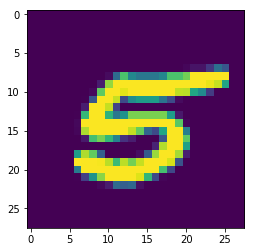

In [2]:
import matplotlib.pyplot as plt
%matplotlib inline

pics_tmp = next(mnist_generator())
print('一个batch图片数据的形状：batch_size =', len(pics_tmp), ', data_shape =', pics_tmp[0].shape)

plt.imshow(pics_tmp[0][0]) # (28,28)
plt.show

In [3]:
z_tmp = next(z_generator())
print('一个batch噪声z的形状：batch_size =', len(z_tmp), ', data_shape =', z_tmp[0].shape)

一个batch噪声z的形状：batch_size = 128 , data_shape = (100, 1, 1)


# GAN网络

GAN性能的提升从生成器G和判别器D进行左右互搏、交替完善的过程得到的。所以其G网络和D网络的能力应该设计得相近，复杂度也差不多。这个项目中的生成器，采用了两个全链接层接两组上采样和转置卷积层，将输入的噪声Z逐渐转化为1×28×28的单通道图片输出。

生成器结构：

<img src="https://ai-studio-static-online.cdn.bcebos.com/625f6642177144c49bcd01b05a78e19094fe74d0f51a4cdb989648d3adcbe362" style="height:400px;width:600px">

判别器的结构正好相反，先通过两组卷积和池化层将输入的图片转化为越来越小的特征图，再经过两层全链接层，输出图片是真是假的二分类结果。

判别器结构：
<br/>

<img src="https://ai-studio-static-online.cdn.bcebos.com/d3a0dc774d0d41758bc674deb189a76e653815de352c4e6d951807be13baec91" style="height:400px;width:600px">


In [4]:
# 通过上采样扩大特征图
class G(fluid.dygraph.Layer):
    def __init__(self, name_scope):
        super(G, self).__init__(name_scope)
        name_scope = self.full_name()
        self.fc1 = Linear(100,1024);
        self.bn1 = fluid.dygraph.BatchNorm(num_channels=1024,act='tanh')
        self.fc2 = Linear(1024,6272);
        self.bn2 = fluid.dygraph.BatchNorm(num_channels=6272,act='tanh')
        self.conv1 = Conv2D(num_channels=128,num_filters=64,filter_size=5,padding=2)
        self.bn3 = fluid.dygraph.BatchNorm(num_channels=64,act='tanh')
        self.conv2 = Conv2D(num_channels=64,num_filters=1,filter_size=5,padding=2,act='tanh')
        #self.bn4 = fluid.dygraph.BatchNorm(num_channels=1,act='tanh')

        #
        # My_G的代码
        #
        
    def forward(self, z):
        #
        # My_G forward的代码
        #
        x = fluid.layers.reshape(z,shape=(-1,100));
        x = self.fc1(x)
        x = self.bn1(x)
        x = self.fc2(x)
        x = self.bn2(x)
        x = fluid.layers.reshape(x,shape=(-1,128,7,7))
        x = fluid.layers.image_resize(x,scale=2)
        x = self.conv1(x)
        x = self.bn3(x)
        x = fluid.layers.image_resize(x,scale=2)
        x = self.conv2(x)
        return x


class D(fluid.dygraph.Layer):
    def __init__(self, name_scope):
        super(D, self).__init__(name_scope)
        name_scope = self.full_name()
        self.conv1 = Conv2D(num_channels=1,num_filters=64,filter_size=3)
        self.bn1 = fluid.dygraph.BatchNorm(num_channels=64,act='relu')
        self.pool1 = Pool2D(pool_size=2,pool_stride=2)
        self.conv2 = Conv2D(num_channels=64,num_filters=128,filter_size=3)
        self.bn2 = fluid.dygraph.BatchNorm(num_channels=128,act='relu')
        self.pool2 = Pool2D(pool_size=2,pool_stride=2)
        self.fc1 = Linear(3200,1024)
        self.bn3 = fluid.dygraph.BatchNorm(num_channels=1024,act='relu')
        self.fc2 = Linear(1024,1,act='sigmoid')
        #
        # My_D的代码
        #

    def forward(self, img):  
        #
        # My_G forward的代码
        #
        x = self.conv1(img)
        x = self.bn1(x)
        x = self.pool1(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.pool2(x)
        x = fluid.layers.reshape(x,shape=(-1,3200))
        x = self.fc1(x)
        x = self.bn3(x)
        x = self.fc2(x)
        return x


测试生成器G网络和判别器D网络的前向计算结果。一个batch的数据，输出一张图片。

生成器G生成图片数据的形状： (128, 1, 28, 28)


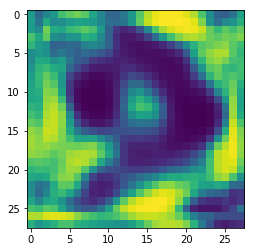

判别器D判别生成的图片的概率数据形状： (128, 1)
[0.91526324]


In [5]:
# 测试生成网络G和判别网络D
with fluid.dygraph.guard():
    g_tmp = G('G')
    tmp_g = g_tmp(fluid.dygraph.to_variable(np.array(z_tmp))).numpy()
    print('生成器G生成图片数据的形状：', tmp_g.shape)
    plt.imshow(tmp_g[0][0])
    plt.show()
    
    d_tmp = D('D')
    tmp_d = d_tmp(fluid.dygraph.to_variable(tmp_g)).numpy()
    print('判别器D判别生成的图片的概率数据形状：', tmp_d.shape)
    print(max(tmp_d))

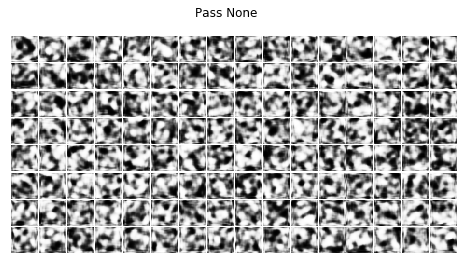

In [6]:
# 显示图片，构建一个16*n大小(n=batch_size/16)的图片阵列，把预测的图片打印到note中。
import matplotlib.pyplot as plt
%matplotlib inline

def show_image_grid(images, batch_size=128, pass_id=None):
    fig = plt.figure(figsize=(8, batch_size/32))
    fig.suptitle("Pass {}".format(pass_id))
    gs = plt.GridSpec(int(batch_size/16), 16)
    gs.update(wspace=0.05, hspace=0.05)

    for i, image in enumerate(images):
        ax = plt.subplot(gs[i])
        plt.axis('off')
        ax.set_xticklabels([])
        ax.set_yticklabels([])
        ax.set_aspect('equal')
        plt.imshow(image[0], cmap='Greys_r')    
    plt.show()

show_image_grid(tmp_g, BATCH_SIZE)

# 网络训练

网络的训练优化目标就是如下公式：

![](https://ai-studio-static-online.cdn.bcebos.com/d60b2999c2b44e3397117b5d6ece1eb7efb5a677e5c044b7ac56310af49f532c)

公式出自Goodfellow在2014年发表的论文[Generative Adversarial Nets](https://arxiv.org/pdf/1406.2661v1.pdf)。
这里简单介绍下公式的含义和如何应用到代码中。上式中等号左边的部分：

![](https://ai-studio-static-online.cdn.bcebos.com/d4f6e2307d1a4ec586f2e546031cf833e42aea25399346f093f0eedd655be207)表示的是生成样本和真实样本的差异度，可以使用二分类（真、假两个类别）的交叉商损失。

![](https://ai-studio-static-online.cdn.bcebos.com/91e096cf8e6742beac8f7de6e80df1bf6729c19df096424fa915f03f874e9bc1)
表示在生成器固定的情况下，通过最大化交叉商损失![](https://ai-studio-static-online.cdn.bcebos.com/d4f6e2307d1a4ec586f2e546031cf833e42aea25399346f093f0eedd655be207)来更新判别器D的参数。

![](https://ai-studio-static-online.cdn.bcebos.com/b9c493da756a45cf949445d7686b09583372cf9eb90c4a7eace609a3ef180dc3)
表示生成器要在判别器最大化真、假图片交叉商损失![](https://ai-studio-static-online.cdn.bcebos.com/d4f6e2307d1a4ec586f2e546031cf833e42aea25399346f093f0eedd655be207)的情况下，最小化这个交叉商损失。

等式的右边其实就是将等式左边的交叉商损失公式展开，并写成概率分布的期望形式。详细的推导请参见原论文《[Generative Adversarial Nets](https://arxiv.org/pdf/1406.2661v1.pdf)》。

下面是训练模型的代码，有详细的注释。大致过程是：先用真图片训练一次判别器d的参数，再用生成器g生成的假图片训练一次判别器d的参数，最后用判别器d判断生成器g生成的假图片的概率值更新一次生成器g的参数，即每轮训练先训练两次判别器d，再训练一次生成器g，使得判别器d的能力始终稍稍高于生成器g一些。

epoch = 0 , batch = 99 , real_d_loss = [0.3946795] , fake_d_loss = [0.7428698] g_loss = [0.65226454]


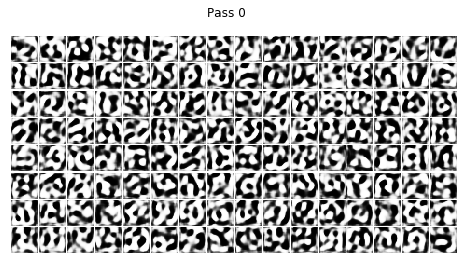

epoch = 0 , batch = 199 , real_d_loss = [0.38807166] , fake_d_loss = [0.7213406] g_loss = [0.6688011]


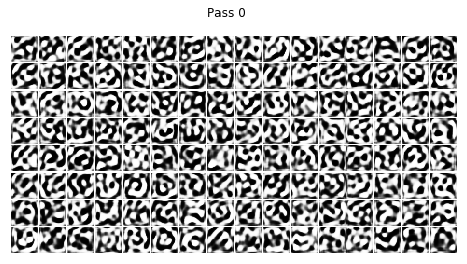

epoch = 0 , batch = 299 , real_d_loss = [0.37421626] , fake_d_loss = [0.7194723] g_loss = [0.670828]


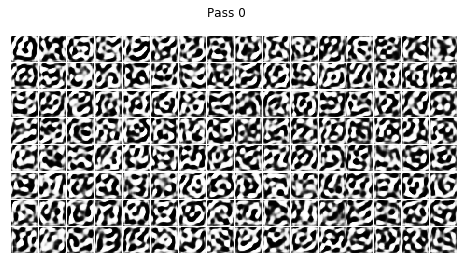

epoch = 0 , batch = 399 , real_d_loss = [0.35609055] , fake_d_loss = [0.7134893] g_loss = [0.6762916]


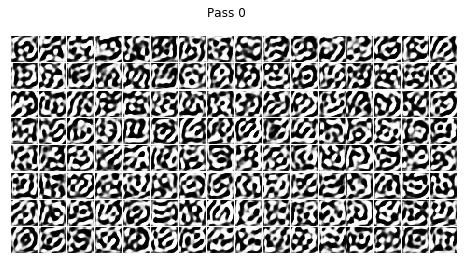

epoch = 1 , batch = 31 , real_d_loss = [0.36168334] , fake_d_loss = [0.7088711] g_loss = [0.6798486]


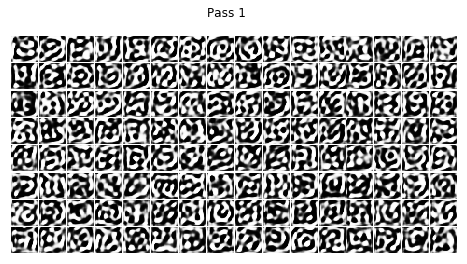

epoch = 1 , batch = 131 , real_d_loss = [0.36181754] , fake_d_loss = [0.71104336] g_loss = [0.67701185]


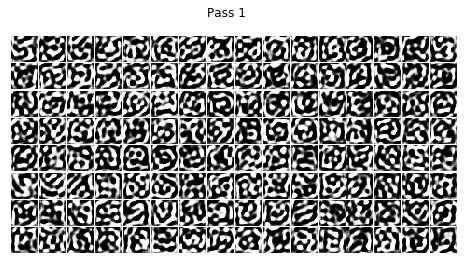

epoch = 1 , batch = 231 , real_d_loss = [0.35171178] , fake_d_loss = [0.71803945] g_loss = [0.6768845]
epoch = 1 , batch = 331 , real_d_loss = [0.3686754] , fake_d_loss = [0.7117089] g_loss = [0.676734]


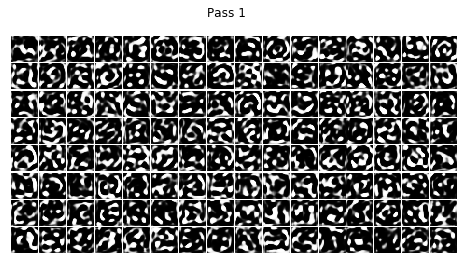

epoch = 1 , batch = 431 , real_d_loss = [0.36557725] , fake_d_loss = [0.71674955] g_loss = [0.67360604]
epoch = 2 , batch = 63 , real_d_loss = [0.37097064] , fake_d_loss = [0.7192836] g_loss = [0.67591345]


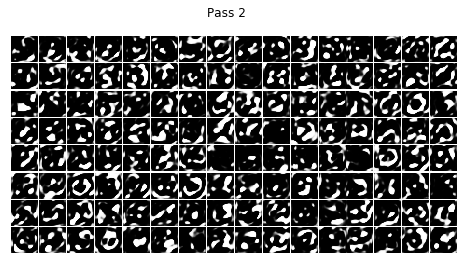

epoch = 2 , batch = 163 , real_d_loss = [0.3623316] , fake_d_loss = [0.7203971] g_loss = [0.6723999]


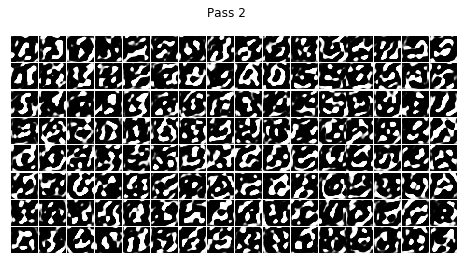

epoch = 2 , batch = 263 , real_d_loss = [0.35933208] , fake_d_loss = [0.71323264] g_loss = [0.67739695]


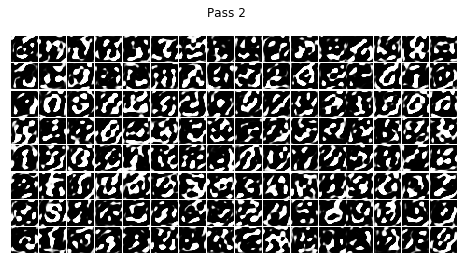

epoch = 2 , batch = 363 , real_d_loss = [0.3579684] , fake_d_loss = [0.708793] g_loss = [0.6810137]


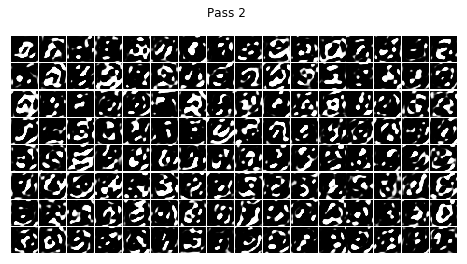

epoch = 3 , batch = 95 , real_d_loss = [0.35355175] , fake_d_loss = [0.7125328] g_loss = [0.678222]


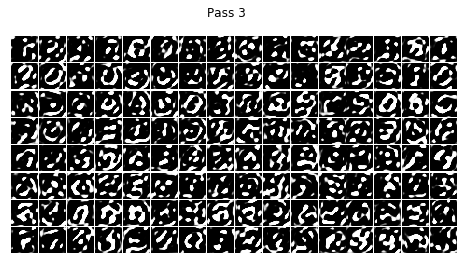

epoch = 3 , batch = 195 , real_d_loss = [0.35667628] , fake_d_loss = [0.7116943] g_loss = [0.6783488]


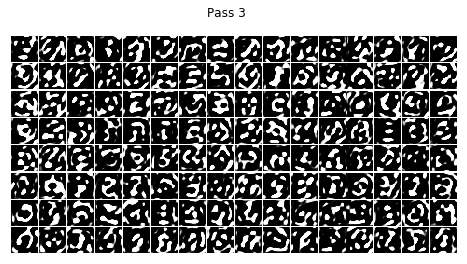

epoch = 3 , batch = 295 , real_d_loss = [0.3498367] , fake_d_loss = [0.7087965] g_loss = [0.6804346]


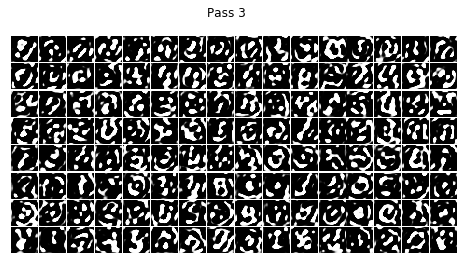

epoch = 3 , batch = 395 , real_d_loss = [0.3467859] , fake_d_loss = [0.7088597] g_loss = [0.6804066]


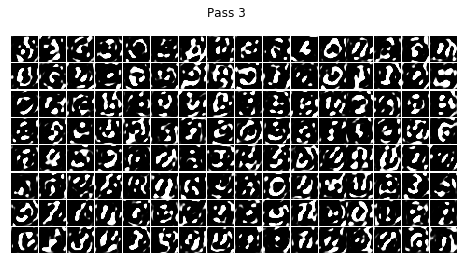

epoch = 4 , batch = 27 , real_d_loss = [0.35360423] , fake_d_loss = [0.7068061] g_loss = [0.68153965]


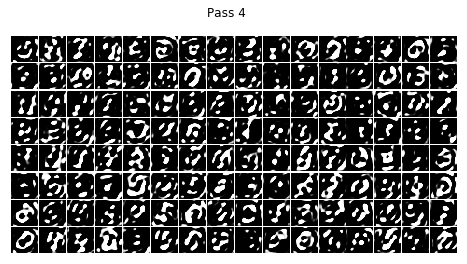

epoch = 4 , batch = 127 , real_d_loss = [0.35295016] , fake_d_loss = [0.7106012] g_loss = [0.68035614]


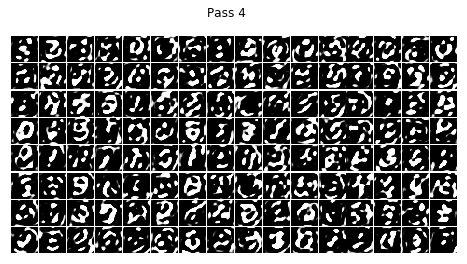

epoch = 4 , batch = 227 , real_d_loss = [0.3530168] , fake_d_loss = [0.713254] g_loss = [0.6782732]


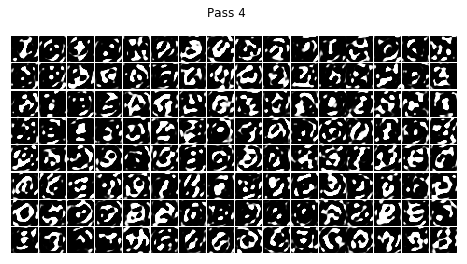

epoch = 4 , batch = 327 , real_d_loss = [0.352086] , fake_d_loss = [0.70547426] g_loss = [0.6835352]


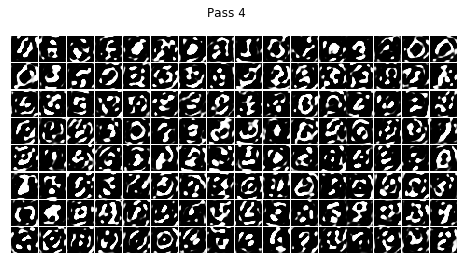

epoch = 4 , batch = 427 , real_d_loss = [0.3562343] , fake_d_loss = [0.71266174] g_loss = [0.67959094]


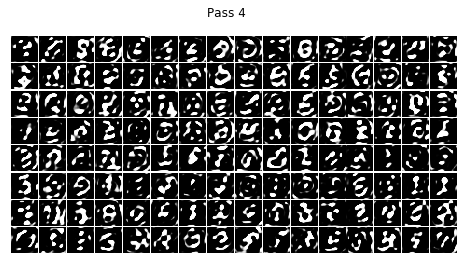

epoch = 5 , batch = 59 , real_d_loss = [0.36572778] , fake_d_loss = [0.7031424] g_loss = [0.6849185]


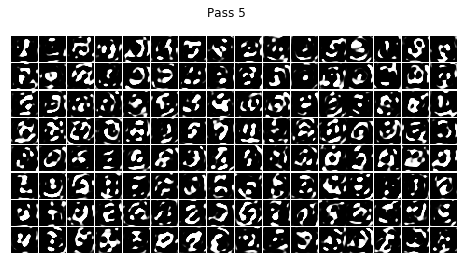

epoch = 5 , batch = 159 , real_d_loss = [0.34909093] , fake_d_loss = [0.70523703] g_loss = [0.6831881]


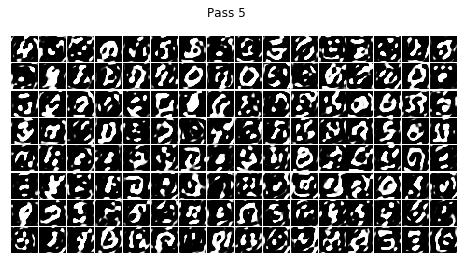

epoch = 5 , batch = 259 , real_d_loss = [0.35234013] , fake_d_loss = [0.7043949] g_loss = [0.68443274]


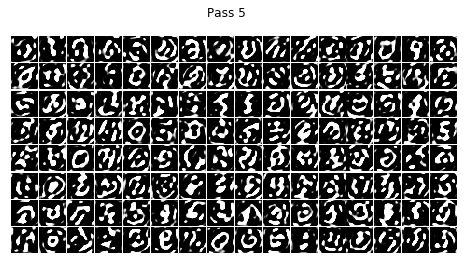

epoch = 5 , batch = 359 , real_d_loss = [0.35572606] , fake_d_loss = [0.70207685] g_loss = [0.68579566]


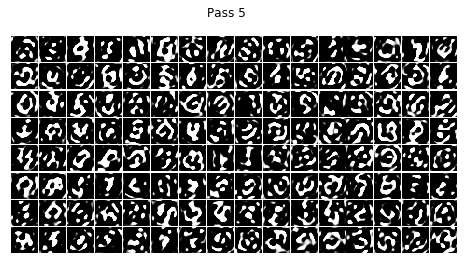

epoch = 5 , batch = 459 , real_d_loss = [0.36944562] , fake_d_loss = [0.71140623] g_loss = [0.67938656]


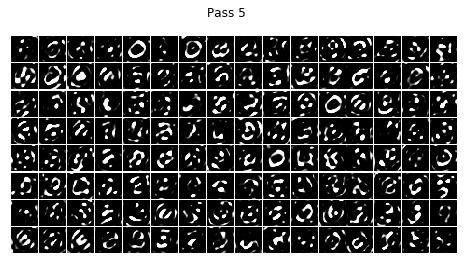

epoch = 6 , batch = 91 , real_d_loss = [0.34942326] , fake_d_loss = [0.70101243] g_loss = [0.6864305]


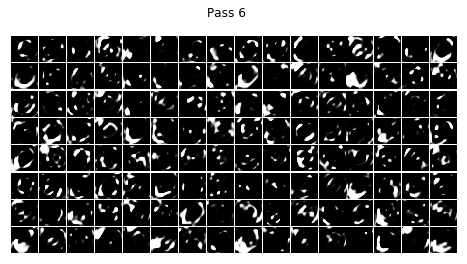

epoch = 6 , batch = 191 , real_d_loss = [0.36162183] , fake_d_loss = [0.7106352] g_loss = [0.68165797]


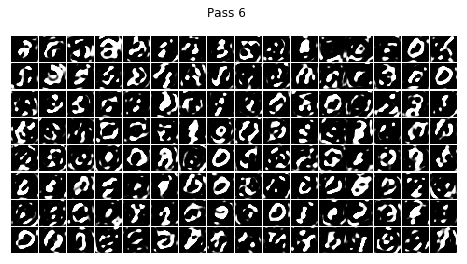

epoch = 6 , batch = 291 , real_d_loss = [0.3582378] , fake_d_loss = [0.709532] g_loss = [0.6816781]
epoch = 7 , batch = 23 , real_d_loss = [0.35376978] , fake_d_loss = [0.70258844] g_loss = [0.6860018]


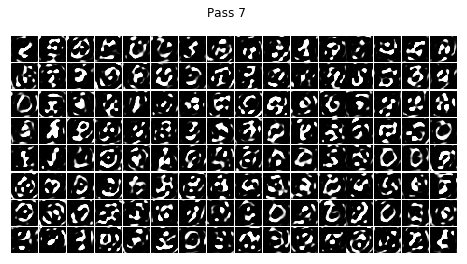

epoch = 7 , batch = 123 , real_d_loss = [0.35381517] , fake_d_loss = [0.70492625] g_loss = [0.6838583]


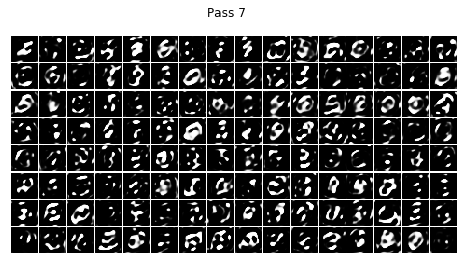

epoch = 7 , batch = 223 , real_d_loss = [0.36573613] , fake_d_loss = [0.70705044] g_loss = [0.68289685]
epoch = 7 , batch = 423 , real_d_loss = [0.35899037] , fake_d_loss = [0.70453334] g_loss = [0.684117]


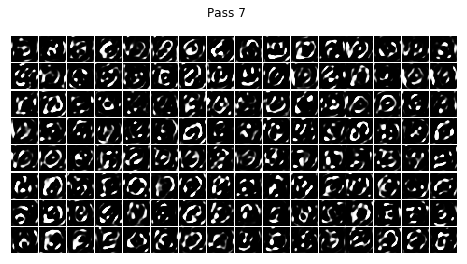

epoch = 8 , batch = 55 , real_d_loss = [0.3558783] , fake_d_loss = [0.7017151] g_loss = [0.6860782]


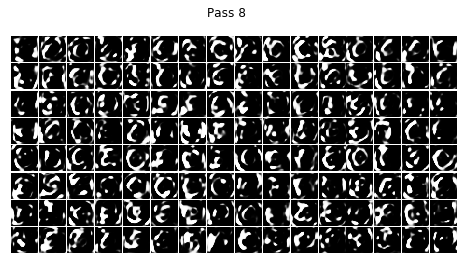

epoch = 8 , batch = 155 , real_d_loss = [0.35630018] , fake_d_loss = [0.70014733] g_loss = [0.6874584]


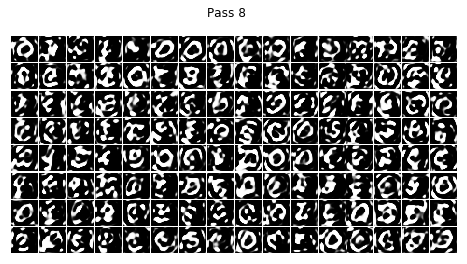

epoch = 8 , batch = 255 , real_d_loss = [0.3514384] , fake_d_loss = [0.7002726] g_loss = [0.68754905]


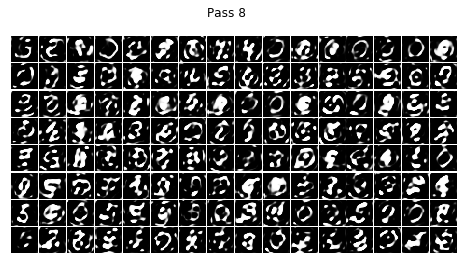

epoch = 8 , batch = 455 , real_d_loss = [0.36640668] , fake_d_loss = [0.71225035] g_loss = [0.6849971]


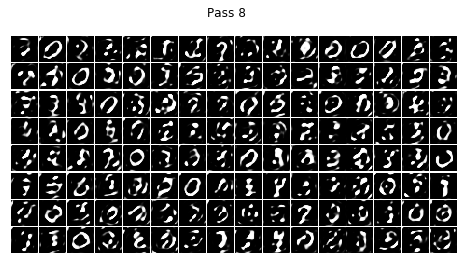

epoch = 9 , batch = 87 , real_d_loss = [0.3646921] , fake_d_loss = [0.7107122] g_loss = [0.6821746]


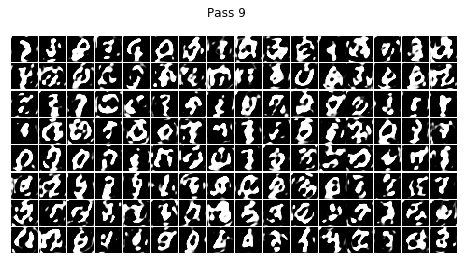

epoch = 9 , batch = 187 , real_d_loss = [0.36138755] , fake_d_loss = [0.7150864] g_loss = [0.6807207]


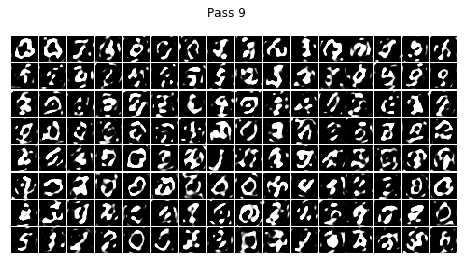

epoch = 9 , batch = 287 , real_d_loss = [0.3641258] , fake_d_loss = [0.7058867] g_loss = [0.68406737]


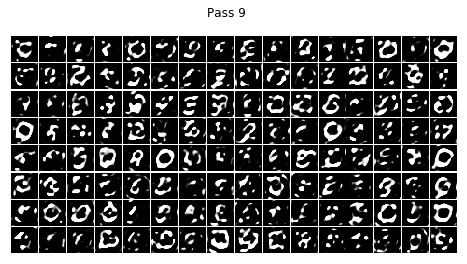

epoch = 9 , batch = 387 , real_d_loss = [0.37103757] , fake_d_loss = [0.7045958] g_loss = [0.68473077]


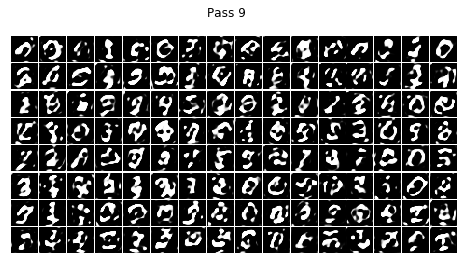

epoch = 10 , batch = 19 , real_d_loss = [0.367329] , fake_d_loss = [0.70898646] g_loss = [0.6833239]


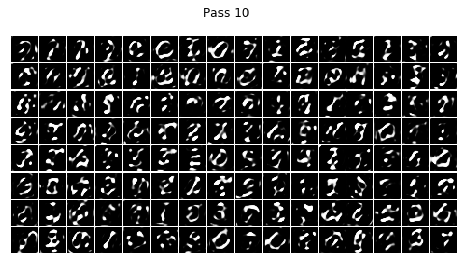

epoch = 10 , batch = 119 , real_d_loss = [0.3703187] , fake_d_loss = [0.70640934] g_loss = [0.6857126]


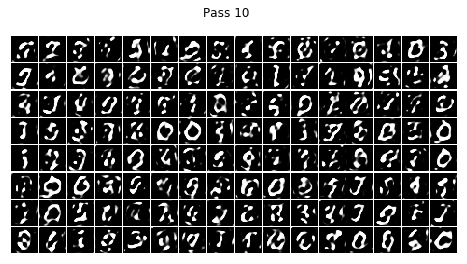

epoch = 10 , batch = 219 , real_d_loss = [0.36539948] , fake_d_loss = [0.7060581] g_loss = [0.68523324]


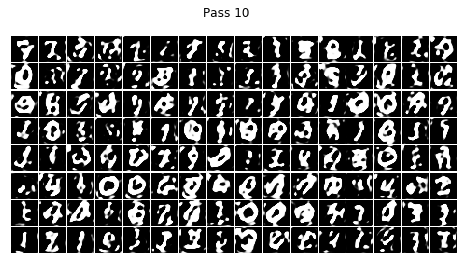

epoch = 10 , batch = 319 , real_d_loss = [0.36132458] , fake_d_loss = [0.7016707] g_loss = [0.6861379]


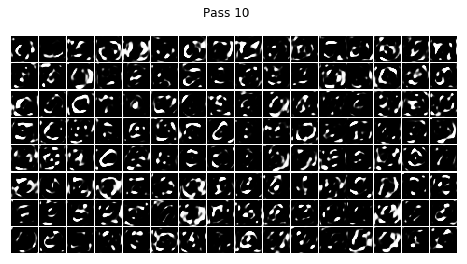

epoch = 10 , batch = 419 , real_d_loss = [0.3678348] , fake_d_loss = [0.70600045] g_loss = [0.6854305]


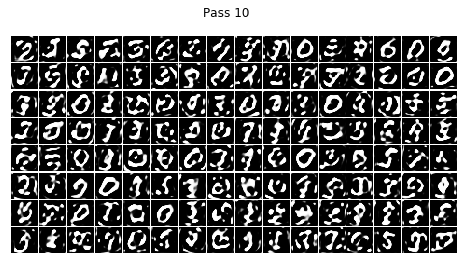

epoch = 11 , batch = 51 , real_d_loss = [0.36747274] , fake_d_loss = [0.70682234] g_loss = [0.68382275]


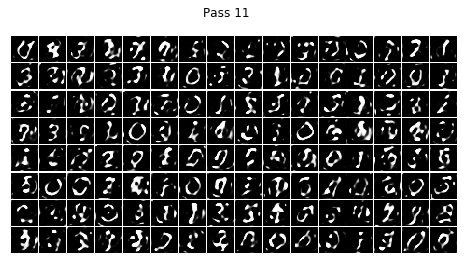

epoch = 11 , batch = 151 , real_d_loss = [0.35986245] , fake_d_loss = [0.6995064] g_loss = [0.6879259]


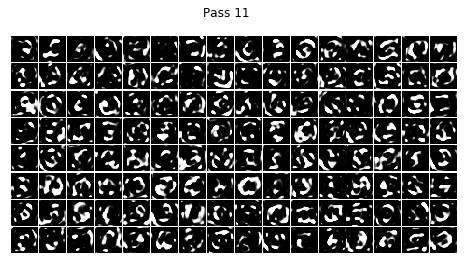

epoch = 11 , batch = 251 , real_d_loss = [0.36314327] , fake_d_loss = [0.706777] g_loss = [0.6846063]


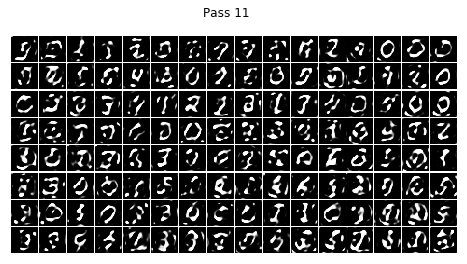

epoch = 11 , batch = 351 , real_d_loss = [0.36320058] , fake_d_loss = [0.7070166] g_loss = [0.68523884]


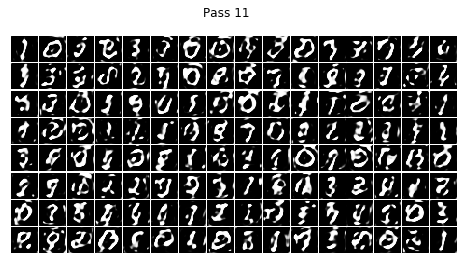

epoch = 11 , batch = 451 , real_d_loss = [0.36317685] , fake_d_loss = [0.6992583] g_loss = [0.688043]


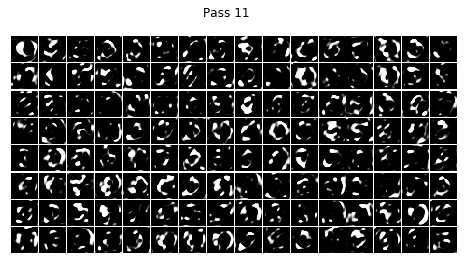

epoch = 12 , batch = 83 , real_d_loss = [0.35883528] , fake_d_loss = [0.70186794] g_loss = [0.6873654]


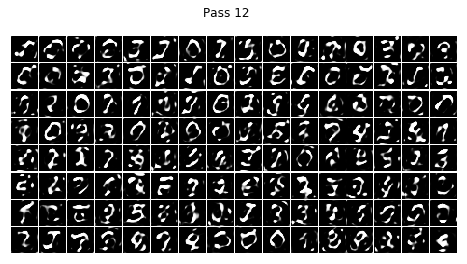

epoch = 12 , batch = 183 , real_d_loss = [0.378415] , fake_d_loss = [0.71417546] g_loss = [0.6844608]


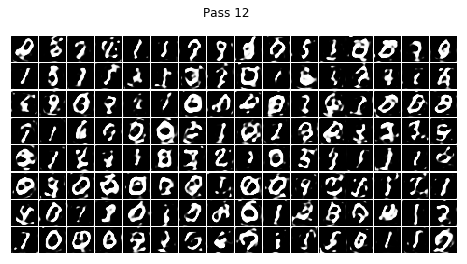

epoch = 12 , batch = 283 , real_d_loss = [0.36683786] , fake_d_loss = [0.712677] g_loss = [0.68312186]


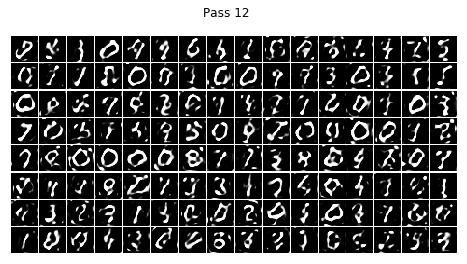

epoch = 12 , batch = 383 , real_d_loss = [0.3766808] , fake_d_loss = [0.7199055] g_loss = [0.67808926]


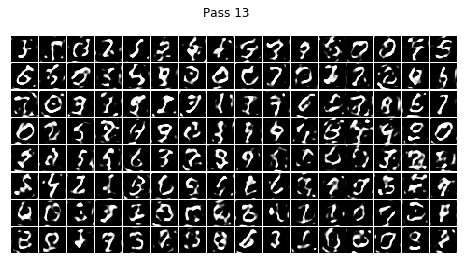

epoch = 13 , batch = 215 , real_d_loss = [0.38664305] , fake_d_loss = [0.71088165] g_loss = [0.683725]


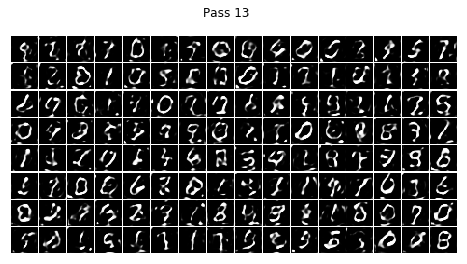

epoch = 13 , batch = 315 , real_d_loss = [0.39573425] , fake_d_loss = [0.7157184] g_loss = [0.68041676]


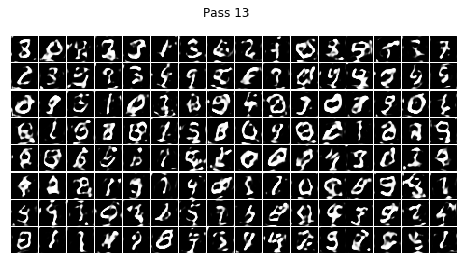

epoch = 13 , batch = 415 , real_d_loss = [0.3900684] , fake_d_loss = [0.7300122] g_loss = [0.6745665]


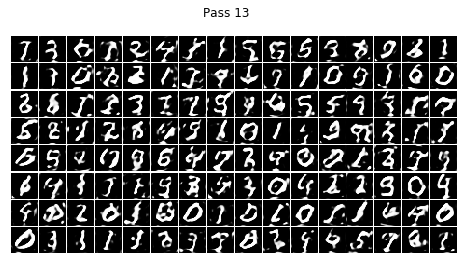

epoch = 14 , batch = 47 , real_d_loss = [0.3985694] , fake_d_loss = [0.7145809] g_loss = [0.6789676]


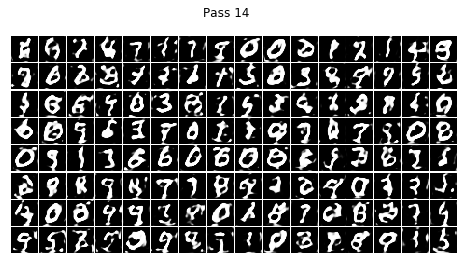

epoch = 14 , batch = 147 , real_d_loss = [0.387848] , fake_d_loss = [0.7226654] g_loss = [0.6771279]


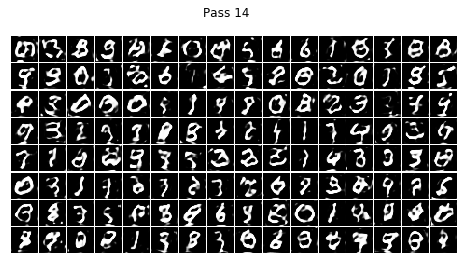

epoch = 14 , batch = 247 , real_d_loss = [0.38989457] , fake_d_loss = [0.7134796] g_loss = [0.67978704]


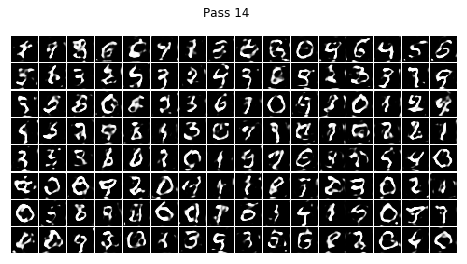

epoch = 14 , batch = 347 , real_d_loss = [0.3872441] , fake_d_loss = [0.71353906] g_loss = [0.6817695]


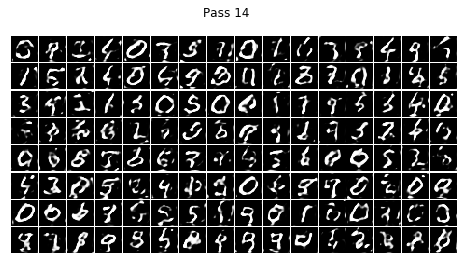

epoch = 14 , batch = 447 , real_d_loss = [0.4123763] , fake_d_loss = [0.72733855] g_loss = [0.6744484]


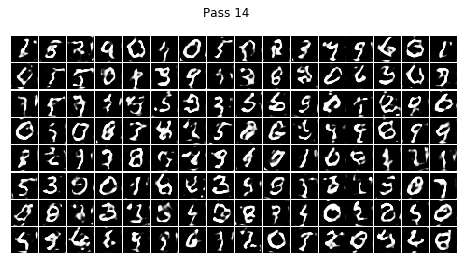

epoch = 15 , batch = 79 , real_d_loss = [0.417582] , fake_d_loss = [0.7158079] g_loss = [0.68134]


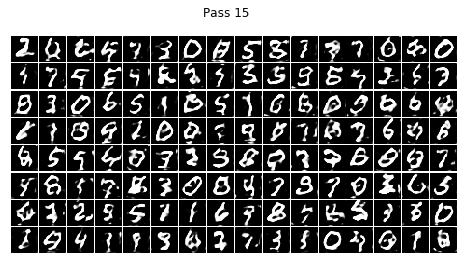

epoch = 15 , batch = 179 , real_d_loss = [0.38747326] , fake_d_loss = [0.7259362] g_loss = [0.67613757]


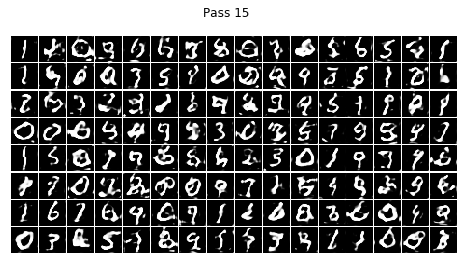

epoch = 15 , batch = 279 , real_d_loss = [0.3953027] , fake_d_loss = [0.7227328] g_loss = [0.67691606]


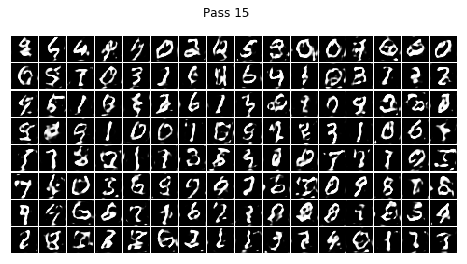

epoch = 15 , batch = 379 , real_d_loss = [0.38452333] , fake_d_loss = [0.72019887] g_loss = [0.6753711]


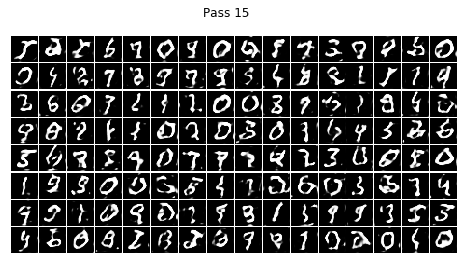

epoch = 16 , batch = 11 , real_d_loss = [0.39428347] , fake_d_loss = [0.72793293] g_loss = [0.6761479]


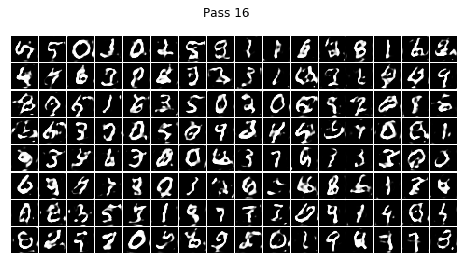

epoch = 16 , batch = 111 , real_d_loss = [0.39498863] , fake_d_loss = [0.72157425] g_loss = [0.67754006]


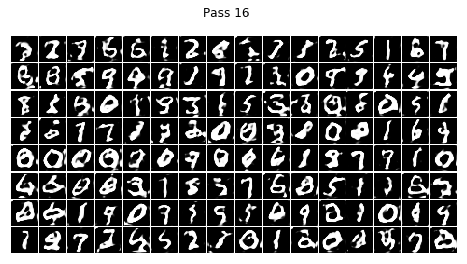

epoch = 16 , batch = 211 , real_d_loss = [0.40730503] , fake_d_loss = [0.71778166] g_loss = [0.6786632]


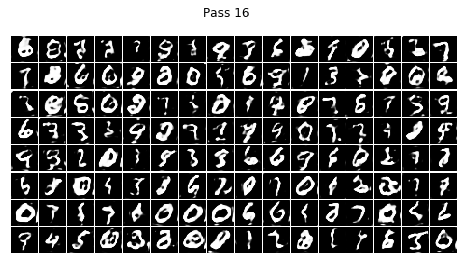

epoch = 16 , batch = 311 , real_d_loss = [0.42537153] , fake_d_loss = [0.724221] g_loss = [0.67598903]


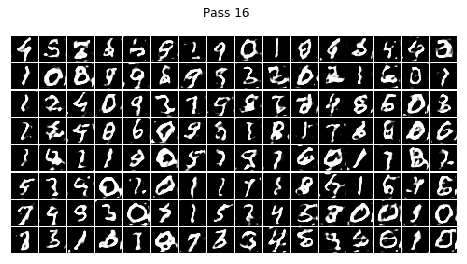

epoch = 16 , batch = 411 , real_d_loss = [0.48791626] , fake_d_loss = [0.72379684] g_loss = [0.6766785]


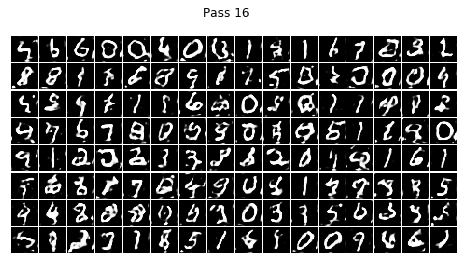

epoch = 17 , batch = 43 , real_d_loss = [0.38962266] , fake_d_loss = [0.724324] g_loss = [0.6778252]


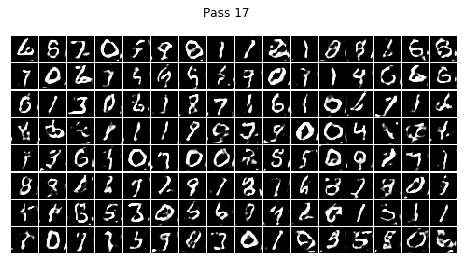

epoch = 17 , batch = 143 , real_d_loss = [0.4039406] , fake_d_loss = [0.7195027] g_loss = [0.6790978]


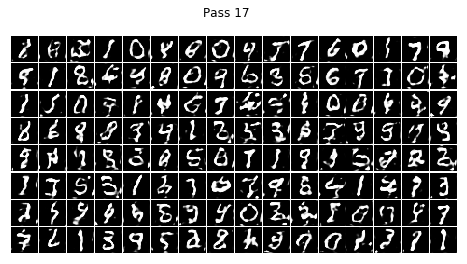

epoch = 17 , batch = 243 , real_d_loss = [0.38847008] , fake_d_loss = [0.71446157] g_loss = [0.6769276]


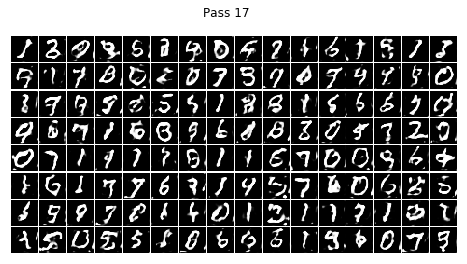

epoch = 17 , batch = 343 , real_d_loss = [0.38629985] , fake_d_loss = [0.7206664] g_loss = [0.67706597]


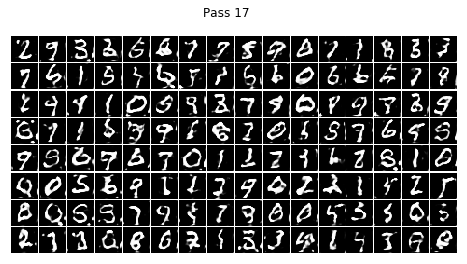

epoch = 17 , batch = 443 , real_d_loss = [0.40144843] , fake_d_loss = [0.7172889] g_loss = [0.6813521]


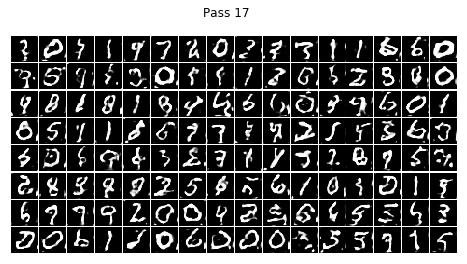

epoch = 18 , batch = 75 , real_d_loss = [0.4028474] , fake_d_loss = [0.7263049] g_loss = [0.6766509]


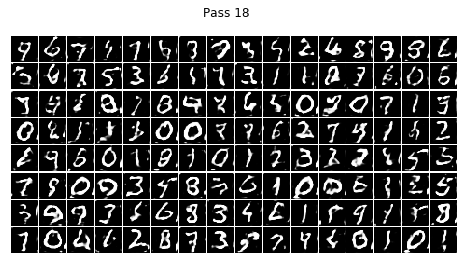

epoch = 18 , batch = 175 , real_d_loss = [0.4162909] , fake_d_loss = [0.7178925] g_loss = [0.67996097]


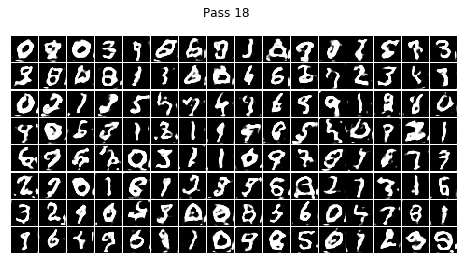

epoch = 18 , batch = 275 , real_d_loss = [0.39447927] , fake_d_loss = [0.7170531] g_loss = [0.68080497]


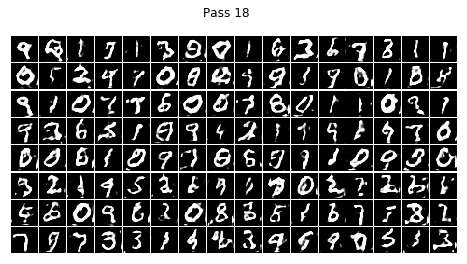

epoch = 18 , batch = 375 , real_d_loss = [0.4028771] , fake_d_loss = [0.7418955] g_loss = [0.6700113]


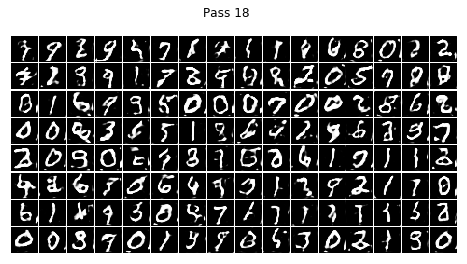

epoch = 19 , batch = 7 , real_d_loss = [0.39002264] , fake_d_loss = [0.7281443] g_loss = [0.6760273]


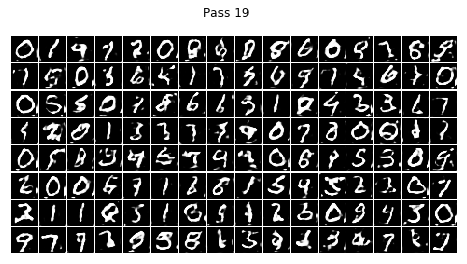

epoch = 19 , batch = 107 , real_d_loss = [0.4238978] , fake_d_loss = [0.72044003] g_loss = [0.67848676]


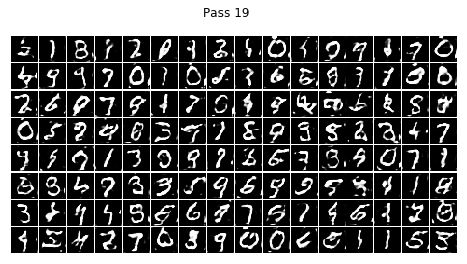

epoch = 19 , batch = 207 , real_d_loss = [0.44010958] , fake_d_loss = [0.71786] g_loss = [0.68109155]


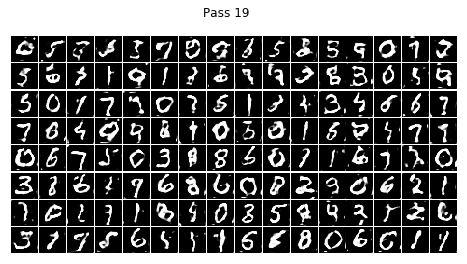

epoch = 19 , batch = 307 , real_d_loss = [0.45413324] , fake_d_loss = [0.72224724] g_loss = [0.67785627]


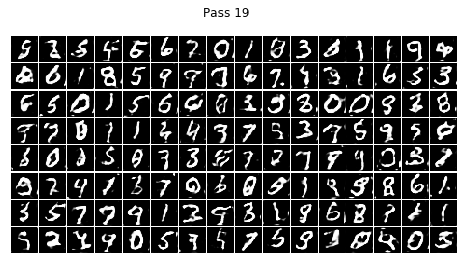

epoch = 19 , batch = 407 , real_d_loss = [0.4245971] , fake_d_loss = [0.7351402] g_loss = [0.67455363]


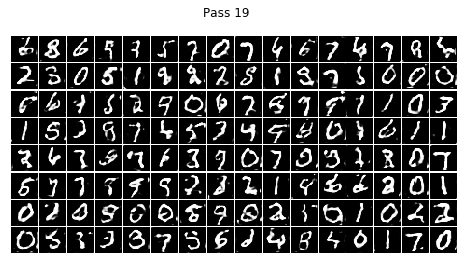

epoch = 20 , batch = 39 , real_d_loss = [0.38808787] , fake_d_loss = [0.7364201] g_loss = [0.6704351]


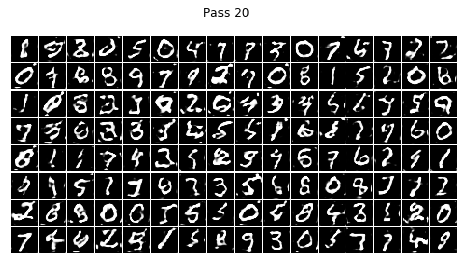

epoch = 20 , batch = 139 , real_d_loss = [0.39368907] , fake_d_loss = [0.72253966] g_loss = [0.6736476]


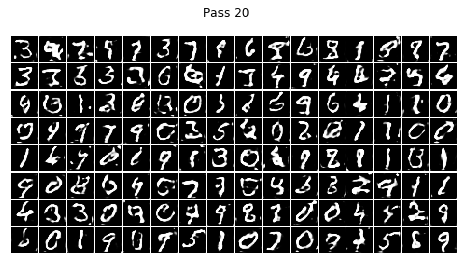

epoch = 20 , batch = 239 , real_d_loss = [0.40338877] , fake_d_loss = [0.7203089] g_loss = [0.6797085]


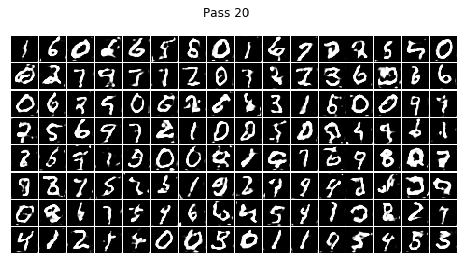

epoch = 20 , batch = 339 , real_d_loss = [0.43600488] , fake_d_loss = [0.71563214] g_loss = [0.68109185]


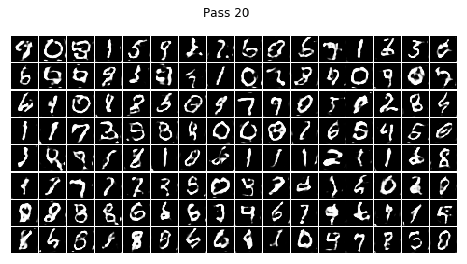

epoch = 20 , batch = 439 , real_d_loss = [0.42946184] , fake_d_loss = [0.7200172] g_loss = [0.67842054]


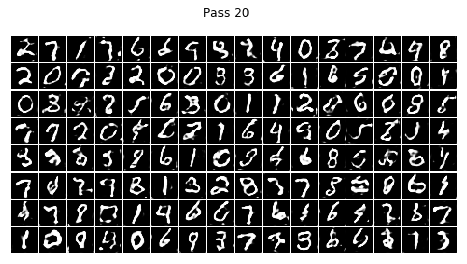

epoch = 21 , batch = 71 , real_d_loss = [0.3953129] , fake_d_loss = [0.7189818] g_loss = [0.6785563]


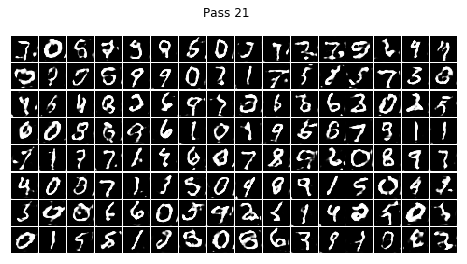

epoch = 21 , batch = 171 , real_d_loss = [0.44986194] , fake_d_loss = [0.71702427] g_loss = [0.67990756]


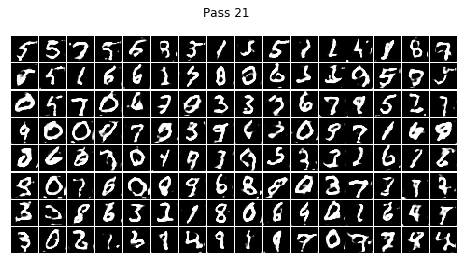

epoch = 21 , batch = 271 , real_d_loss = [0.39237037] , fake_d_loss = [0.7338798] g_loss = [0.67239916]


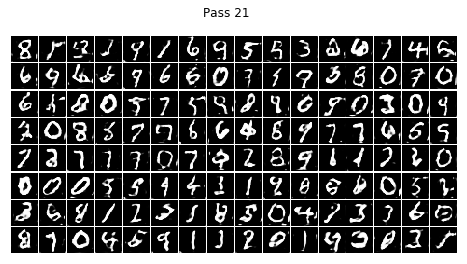

epoch = 21 , batch = 371 , real_d_loss = [0.39365277] , fake_d_loss = [0.72489643] g_loss = [0.67667377]


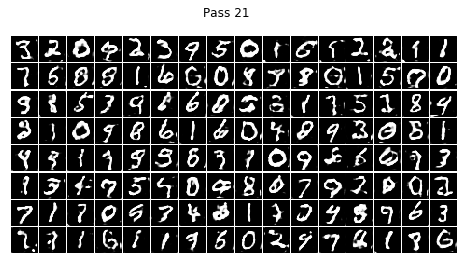

epoch = 22 , batch = 3 , real_d_loss = [0.40736815] , fake_d_loss = [0.7277667] g_loss = [0.6731428]


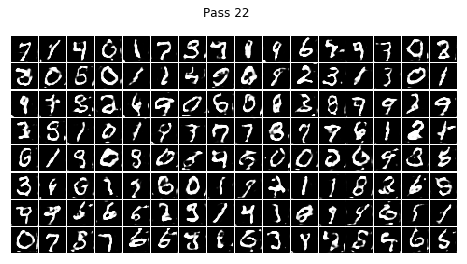

epoch = 22 , batch = 103 , real_d_loss = [0.37745923] , fake_d_loss = [0.7119223] g_loss = [0.6814925]


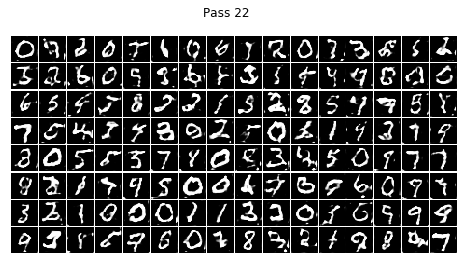

epoch = 22 , batch = 203 , real_d_loss = [0.4628647] , fake_d_loss = [0.717831] g_loss = [0.67933905]


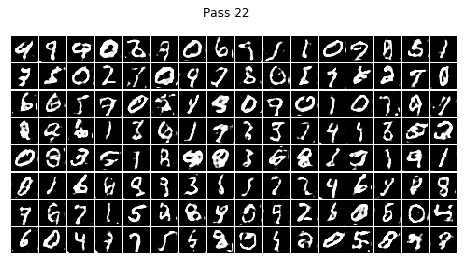

epoch = 22 , batch = 303 , real_d_loss = [0.3994435] , fake_d_loss = [0.72320616] g_loss = [0.6790035]


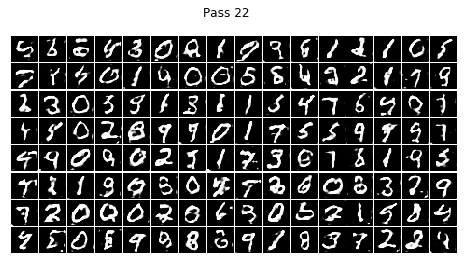

epoch = 22 , batch = 403 , real_d_loss = [0.40732786] , fake_d_loss = [0.73803824] g_loss = [0.6694156]


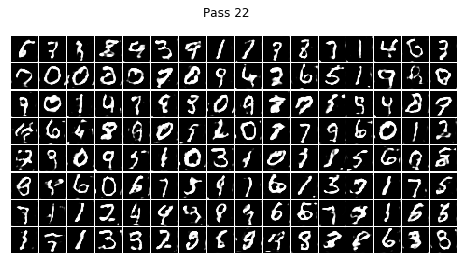

epoch = 23 , batch = 35 , real_d_loss = [0.4089424] , fake_d_loss = [0.7261202] g_loss = [0.6759994]


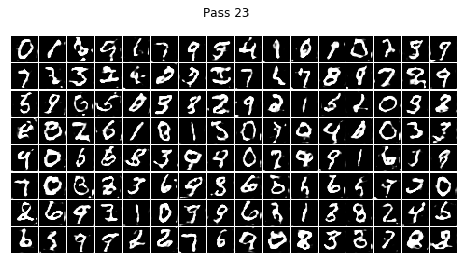

epoch = 23 , batch = 135 , real_d_loss = [0.38891444] , fake_d_loss = [0.71952164] g_loss = [0.6767596]


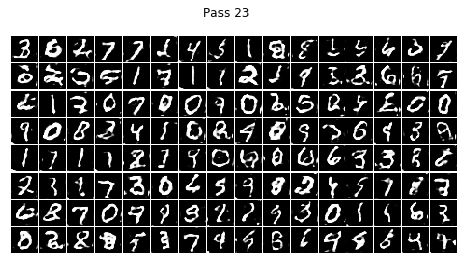

epoch = 23 , batch = 235 , real_d_loss = [0.38227722] , fake_d_loss = [0.7111745] g_loss = [0.68343115]


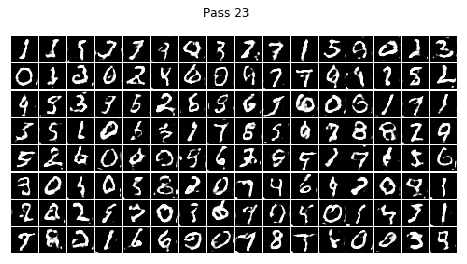

epoch = 23 , batch = 335 , real_d_loss = [0.41047668] , fake_d_loss = [0.71699965] g_loss = [0.6794718]


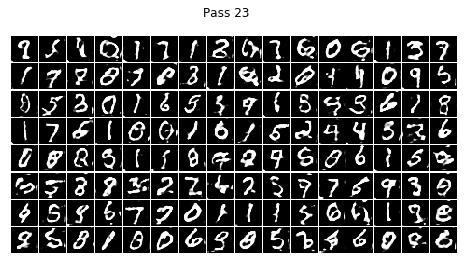

epoch = 23 , batch = 435 , real_d_loss = [0.40188652] , fake_d_loss = [0.7268493] g_loss = [0.6760322]


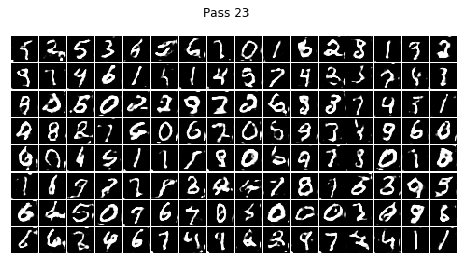

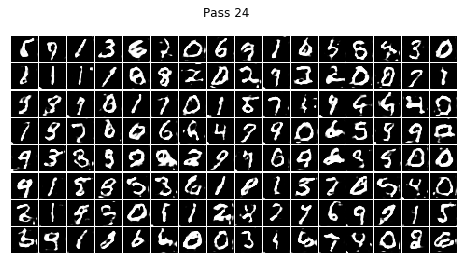

epoch = 24 , batch = 167 , real_d_loss = [0.40392393] , fake_d_loss = [0.7195896] g_loss = [0.68068755]


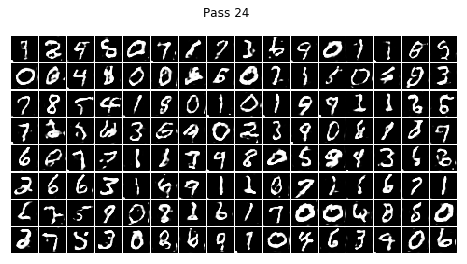

epoch = 24 , batch = 367 , real_d_loss = [0.47265047] , fake_d_loss = [0.71749765] g_loss = [0.6816634]


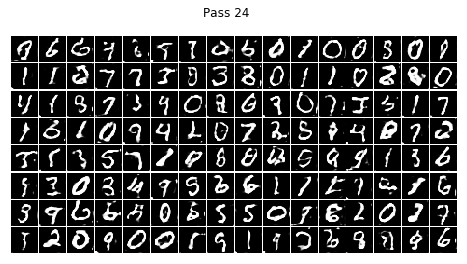

epoch = 24 , batch = 467 , real_d_loss = [0.42255563] , fake_d_loss = [0.726634] g_loss = [0.67620635]


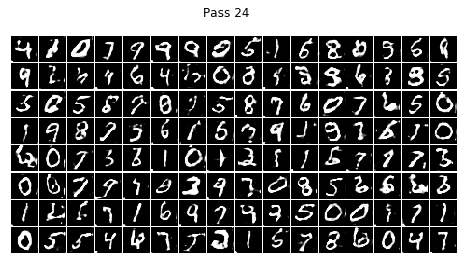

epoch = 25 , batch = 99 , real_d_loss = [0.38338014] , fake_d_loss = [0.7236142] g_loss = [0.6776804]


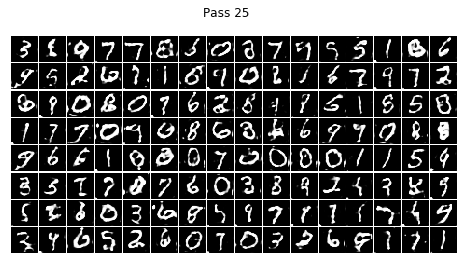

epoch = 25 , batch = 199 , real_d_loss = [0.43984288] , fake_d_loss = [0.7277703] g_loss = [0.6762384]


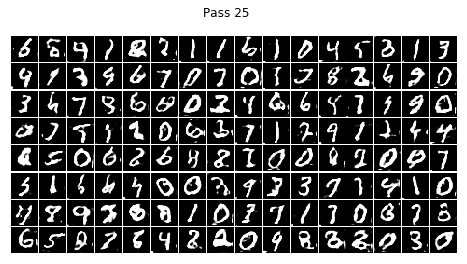

epoch = 25 , batch = 299 , real_d_loss = [0.38755494] , fake_d_loss = [0.742247] g_loss = [0.67013276]


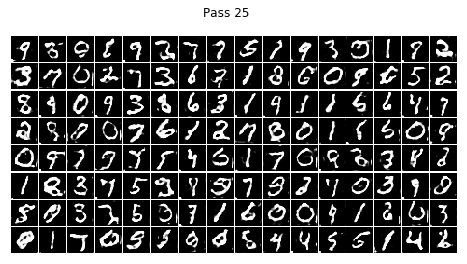

epoch = 25 , batch = 399 , real_d_loss = [0.41420037] , fake_d_loss = [0.71921885] g_loss = [0.67946595]


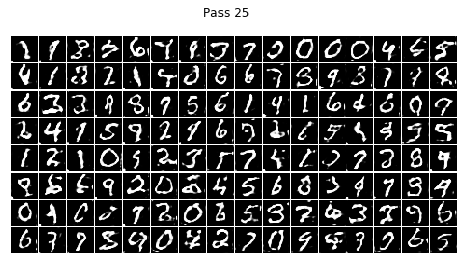

epoch = 26 , batch = 31 , real_d_loss = [0.42906487] , fake_d_loss = [0.7331949] g_loss = [0.6732888]
epoch = 27 , batch = 263 , real_d_loss = [0.40689394] , fake_d_loss = [0.71946883] g_loss = [0.68125135]


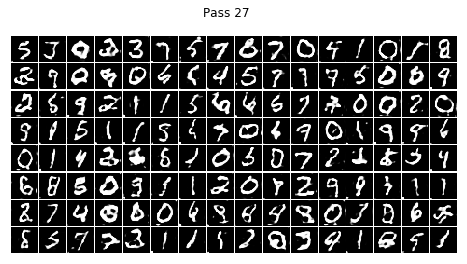

epoch = 27 , batch = 363 , real_d_loss = [0.40250176] , fake_d_loss = [0.72067153] g_loss = [0.6800455]


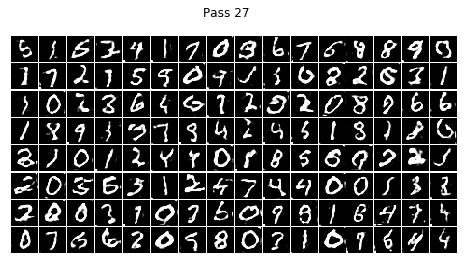

epoch = 28 , batch = 95 , real_d_loss = [0.39696] , fake_d_loss = [0.7305044] g_loss = [0.67620003]


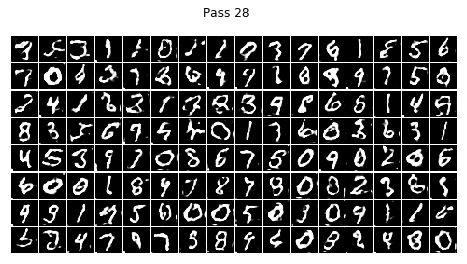

epoch = 28 , batch = 195 , real_d_loss = [0.40884894] , fake_d_loss = [0.7114264] g_loss = [0.68351156]


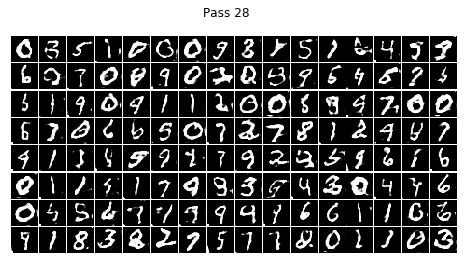

epoch = 28 , batch = 295 , real_d_loss = [0.4894718] , fake_d_loss = [0.71053845] g_loss = [0.6847063]


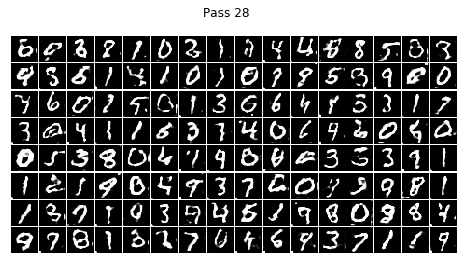

epoch = 28 , batch = 395 , real_d_loss = [0.41738003] , fake_d_loss = [0.72815645] g_loss = [0.67660916]


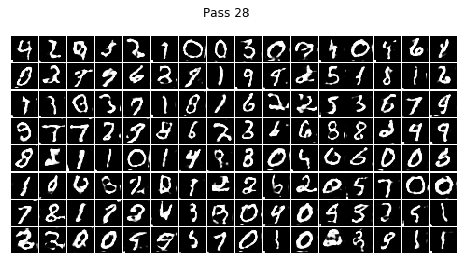

epoch = 29 , batch = 27 , real_d_loss = [0.39602557] , fake_d_loss = [0.70830965] g_loss = [0.6820943]


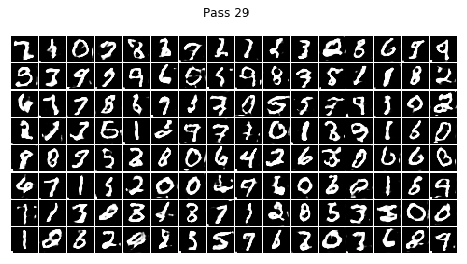

epoch = 29 , batch = 127 , real_d_loss = [0.39381522] , fake_d_loss = [0.7334767] g_loss = [0.6744784]


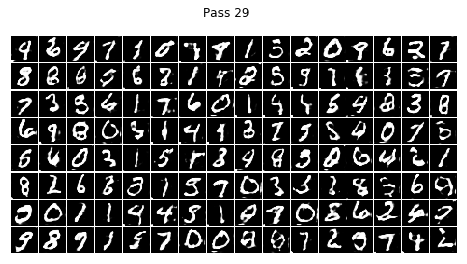

epoch = 29 , batch = 227 , real_d_loss = [0.40734276] , fake_d_loss = [0.7215963] g_loss = [0.67943823]


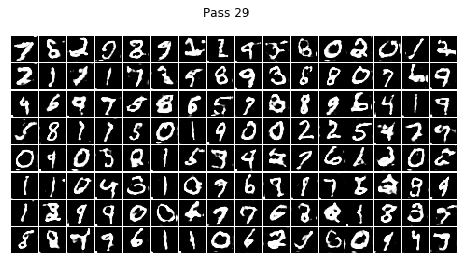

epoch = 29 , batch = 327 , real_d_loss = [0.4156629] , fake_d_loss = [0.71767503] g_loss = [0.6818454]


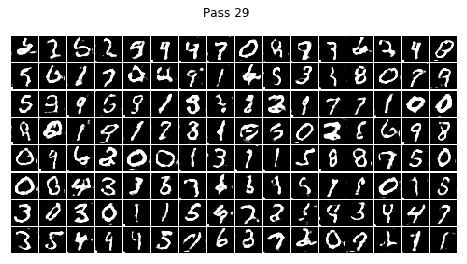

epoch = 29 , batch = 427 , real_d_loss = [0.39580548] , fake_d_loss = [0.7198551] g_loss = [0.679006]


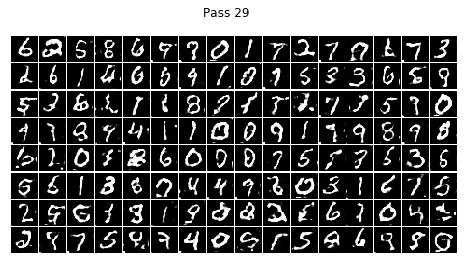

epoch = 30 , batch = 59 , real_d_loss = [0.3830978] , fake_d_loss = [0.7173969] g_loss = [0.680476]


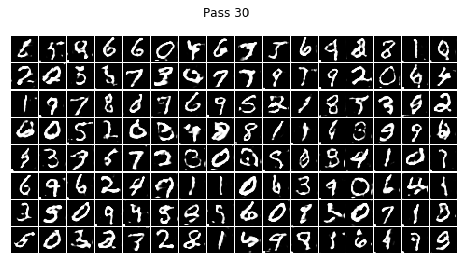

epoch = 30 , batch = 159 , real_d_loss = [0.4246885] , fake_d_loss = [0.7229827] g_loss = [0.67710346]


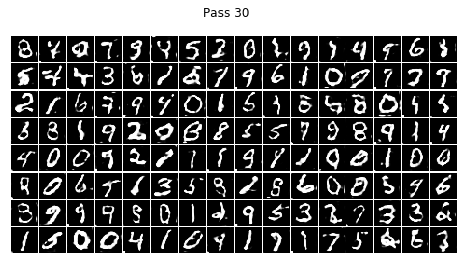

epoch = 30 , batch = 259 , real_d_loss = [0.42815325] , fake_d_loss = [0.7280154] g_loss = [0.67731893]


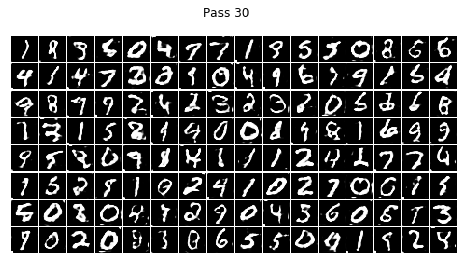

epoch = 30 , batch = 359 , real_d_loss = [0.43211064] , fake_d_loss = [0.71145695] g_loss = [0.6832486]


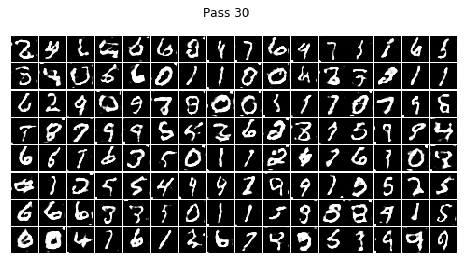

epoch = 30 , batch = 459 , real_d_loss = [0.41313195] , fake_d_loss = [0.71321493] g_loss = [0.6831764]


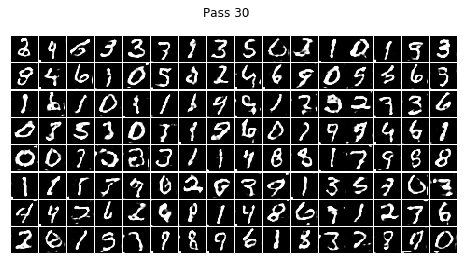

epoch = 31 , batch = 91 , real_d_loss = [0.39866802] , fake_d_loss = [0.7114335] g_loss = [0.6839617]


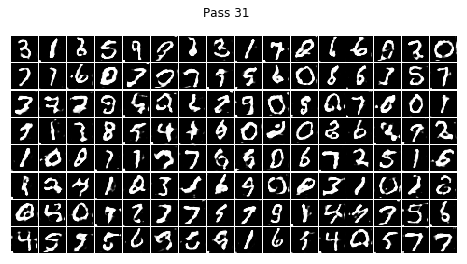

epoch = 31 , batch = 191 , real_d_loss = [0.40348637] , fake_d_loss = [0.713811] g_loss = [0.6814743]


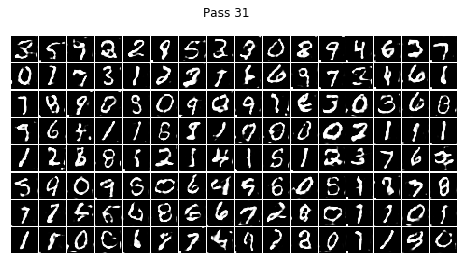

epoch = 31 , batch = 291 , real_d_loss = [0.47257113] , fake_d_loss = [0.7143825] g_loss = [0.6812399]


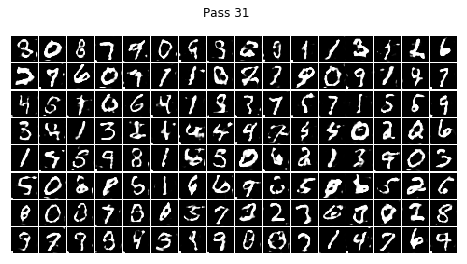

epoch = 31 , batch = 391 , real_d_loss = [0.38154328] , fake_d_loss = [0.71276414] g_loss = [0.6835502]


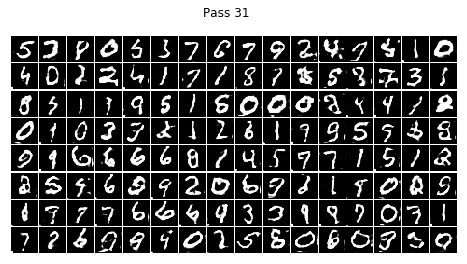

epoch = 32 , batch = 23 , real_d_loss = [0.39442495] , fake_d_loss = [0.71442926] g_loss = [0.68392897]


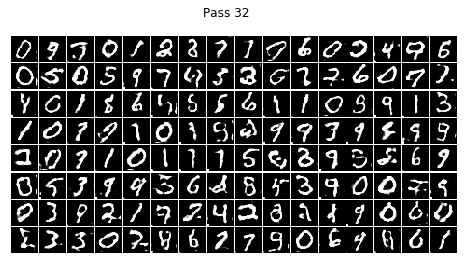

epoch = 32 , batch = 123 , real_d_loss = [0.39665788] , fake_d_loss = [0.72055995] g_loss = [0.6801756]


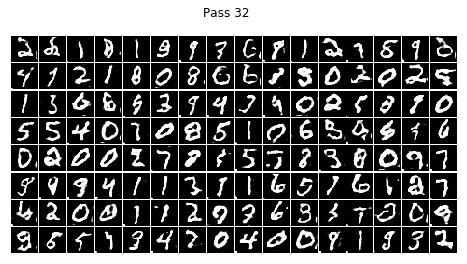

epoch = 32 , batch = 223 , real_d_loss = [0.39651614] , fake_d_loss = [0.71230686] g_loss = [0.68418425]


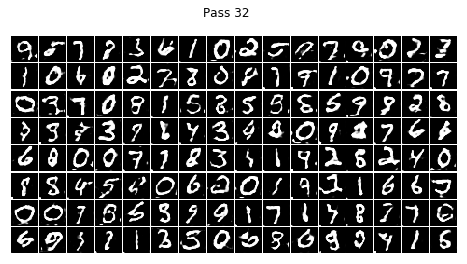

epoch = 32 , batch = 323 , real_d_loss = [0.4043971] , fake_d_loss = [0.713937] g_loss = [0.68265235]


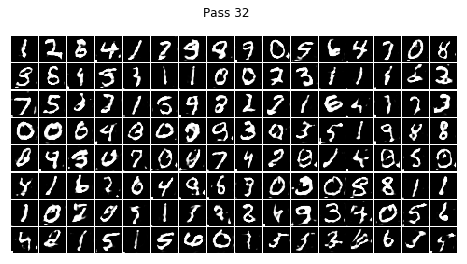

epoch = 32 , batch = 423 , real_d_loss = [0.389518] , fake_d_loss = [0.71607023] g_loss = [0.6803692]


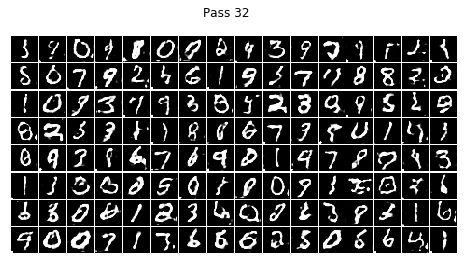

epoch = 33 , batch = 55 , real_d_loss = [0.38493788] , fake_d_loss = [0.7230758] g_loss = [0.6797142]


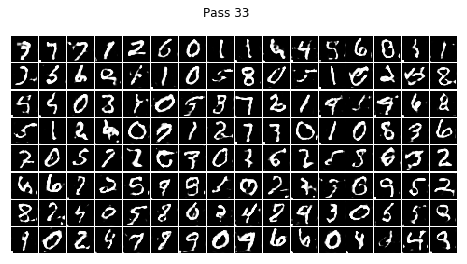

epoch = 33 , batch = 155 , real_d_loss = [0.4147327] , fake_d_loss = [0.71133655] g_loss = [0.6851282]


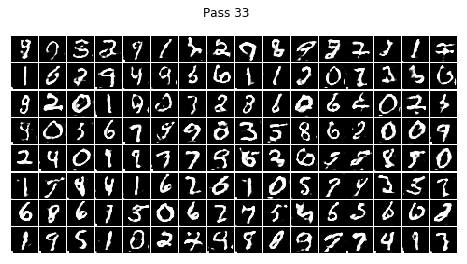

epoch = 33 , batch = 255 , real_d_loss = [0.4046763] , fake_d_loss = [0.70970786] g_loss = [0.68432957]


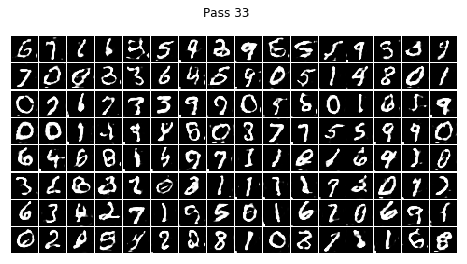

epoch = 33 , batch = 355 , real_d_loss = [0.42682377] , fake_d_loss = [0.7147952] g_loss = [0.68413514]


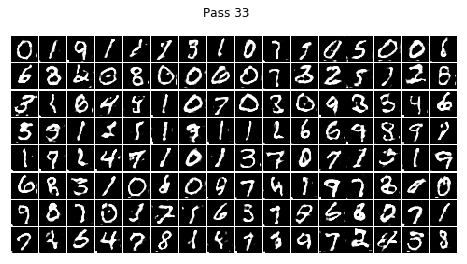

epoch = 33 , batch = 455 , real_d_loss = [0.39736965] , fake_d_loss = [0.7152212] g_loss = [0.681512]


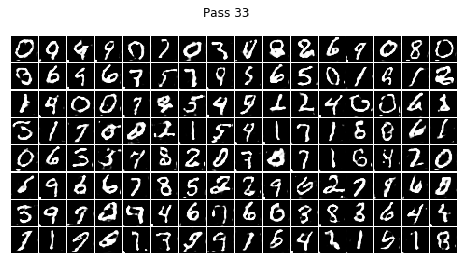

epoch = 34 , batch = 87 , real_d_loss = [0.43387663] , fake_d_loss = [0.7142644] g_loss = [0.681845]


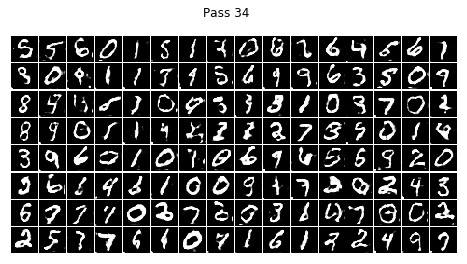

epoch = 34 , batch = 187 , real_d_loss = [0.42551535] , fake_d_loss = [0.7202726] g_loss = [0.68017757]


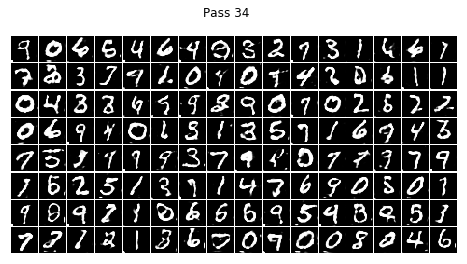

epoch = 34 , batch = 287 , real_d_loss = [0.40616956] , fake_d_loss = [0.7203668] g_loss = [0.6780349]


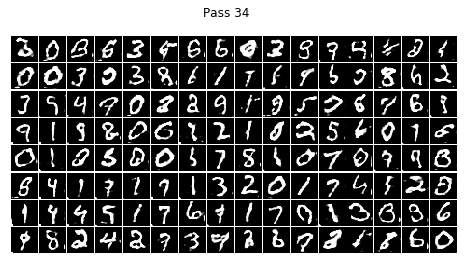

epoch = 34 , batch = 387 , real_d_loss = [0.3973307] , fake_d_loss = [0.71836925] g_loss = [0.68165654]
epoch = 35 , batch = 19 , real_d_loss = [0.41125074] , fake_d_loss = [0.7131541] g_loss = [0.6834319]


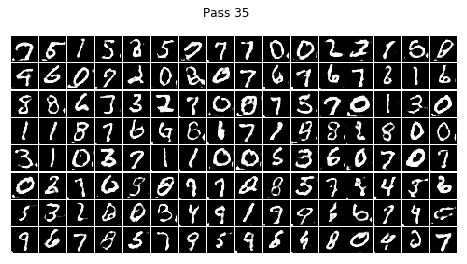

epoch = 35 , batch = 119 , real_d_loss = [0.40841046] , fake_d_loss = [0.7138124] g_loss = [0.681818]


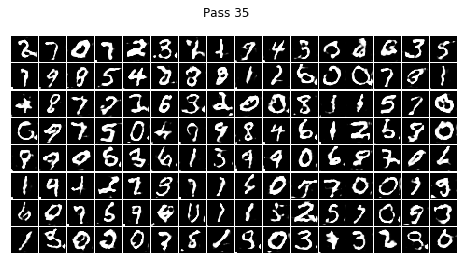

epoch = 35 , batch = 219 , real_d_loss = [0.4029755] , fake_d_loss = [0.73875546] g_loss = [0.67286265]
epoch = 35 , batch = 319 , real_d_loss = [0.39585593] , fake_d_loss = [0.71534145] g_loss = [0.6812806]


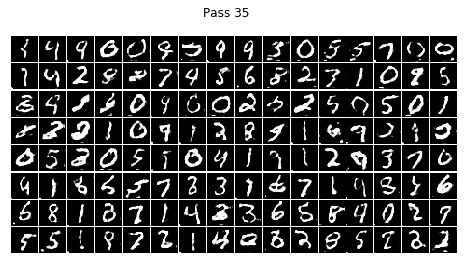

epoch = 35 , batch = 419 , real_d_loss = [0.39656898] , fake_d_loss = [0.7269009] g_loss = [0.67793536]


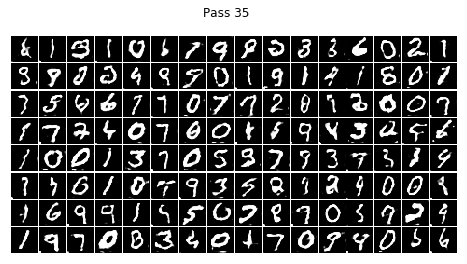

epoch = 36 , batch = 51 , real_d_loss = [0.39873782] , fake_d_loss = [0.715054] g_loss = [0.6827127]


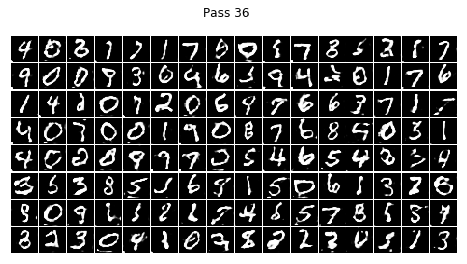

epoch = 36 , batch = 151 , real_d_loss = [0.39311776] , fake_d_loss = [0.7064779] g_loss = [0.68571395]
epoch = 36 , batch = 251 , real_d_loss = [0.39635402] , fake_d_loss = [0.7178891] g_loss = [0.68054974]


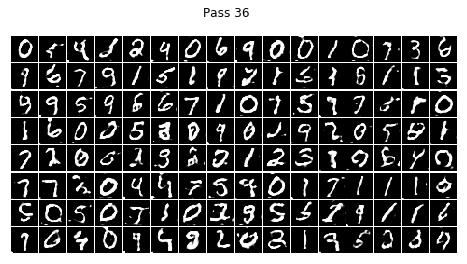

epoch = 36 , batch = 351 , real_d_loss = [0.41873047] , fake_d_loss = [0.72208565] g_loss = [0.68132776]


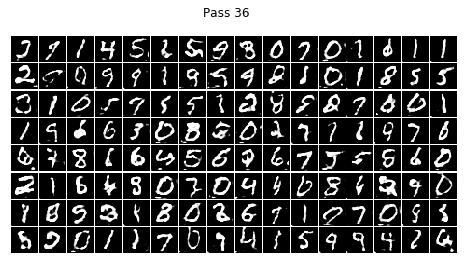

epoch = 37 , batch = 83 , real_d_loss = [0.3806044] , fake_d_loss = [0.7114804] g_loss = [0.68446916]


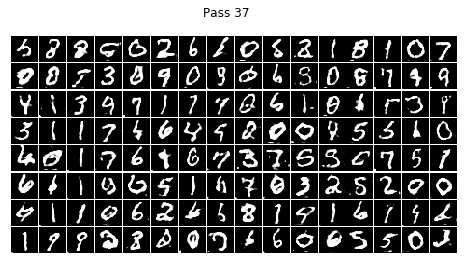

epoch = 37 , batch = 183 , real_d_loss = [0.4566338] , fake_d_loss = [0.7212014] g_loss = [0.68142825]


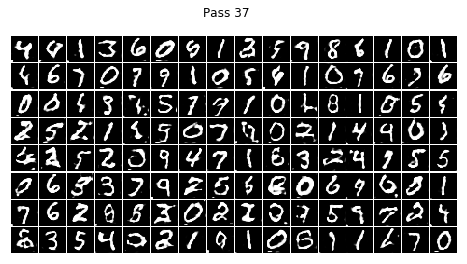

epoch = 37 , batch = 283 , real_d_loss = [0.4395888] , fake_d_loss = [0.70931554] g_loss = [0.6851064]


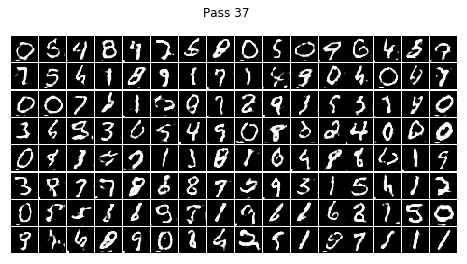

epoch = 37 , batch = 383 , real_d_loss = [0.43596864] , fake_d_loss = [0.7316448] g_loss = [0.6736448]


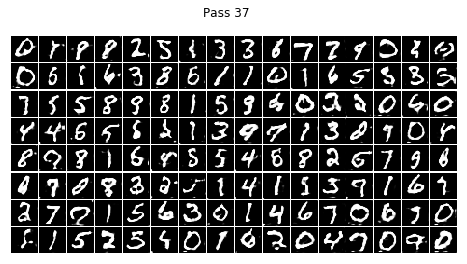

epoch = 38 , batch = 15 , real_d_loss = [0.38771427] , fake_d_loss = [0.72027427] g_loss = [0.6797132]


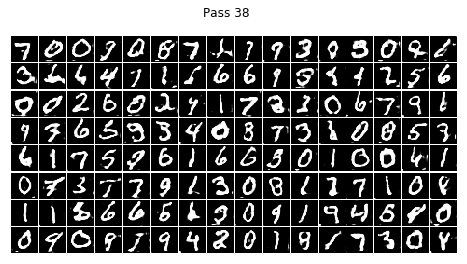

epoch = 38 , batch = 115 , real_d_loss = [0.39502224] , fake_d_loss = [0.7176719] g_loss = [0.6807171]


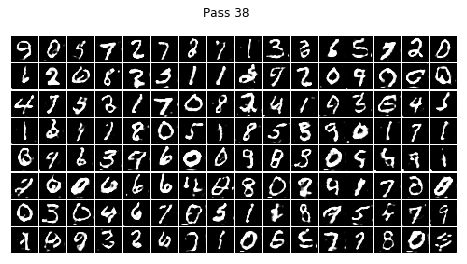

epoch = 38 , batch = 215 , real_d_loss = [0.42052263] , fake_d_loss = [0.7043121] g_loss = [0.6862743]


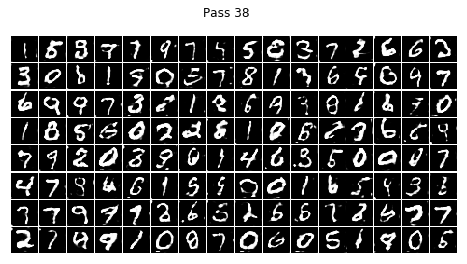

epoch = 38 , batch = 315 , real_d_loss = [0.3957544] , fake_d_loss = [0.7154308] g_loss = [0.68264073]


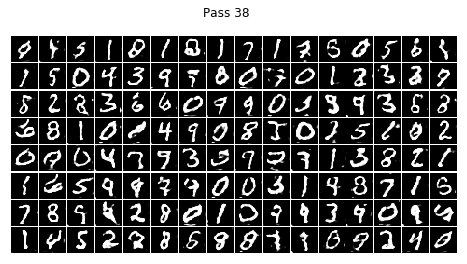

epoch = 38 , batch = 415 , real_d_loss = [0.41054738] , fake_d_loss = [0.70734876] g_loss = [0.68438786]


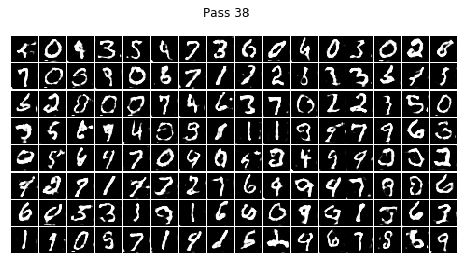

epoch = 39 , batch = 47 , real_d_loss = [0.3973924] , fake_d_loss = [0.7233519] g_loss = [0.6781519]


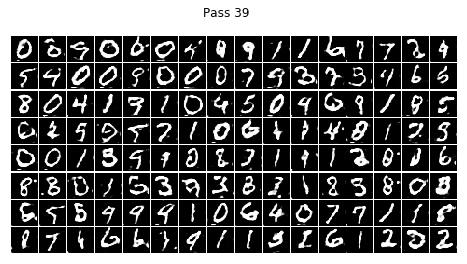

epoch = 39 , batch = 147 , real_d_loss = [0.42613703] , fake_d_loss = [0.7188387] g_loss = [0.67944986]


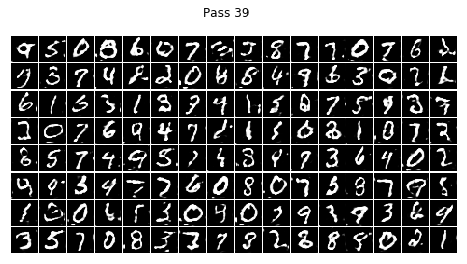

epoch = 39 , batch = 247 , real_d_loss = [0.39165562] , fake_d_loss = [0.7103484] g_loss = [0.6837171]


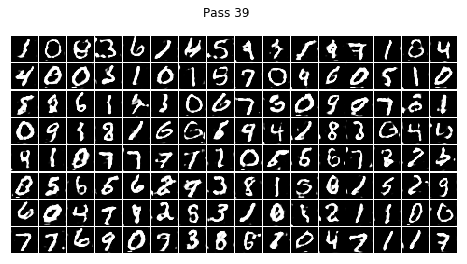

epoch = 39 , batch = 347 , real_d_loss = [0.4192102] , fake_d_loss = [0.7139362] g_loss = [0.6837384]


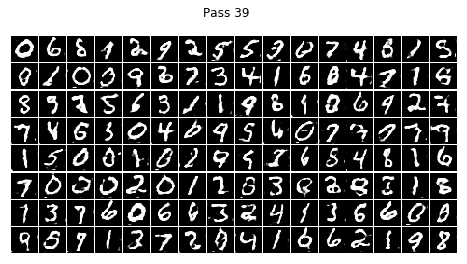

epoch = 39 , batch = 447 , real_d_loss = [0.4683075] , fake_d_loss = [0.71794313] g_loss = [0.6800648]


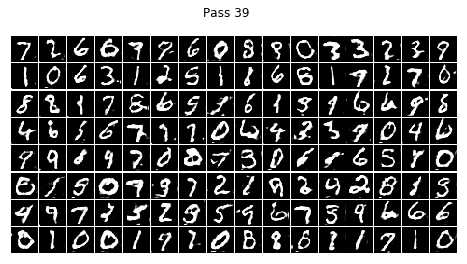

epoch = 40 , batch = 79 , real_d_loss = [0.42083955] , fake_d_loss = [0.7245147] g_loss = [0.6763092]


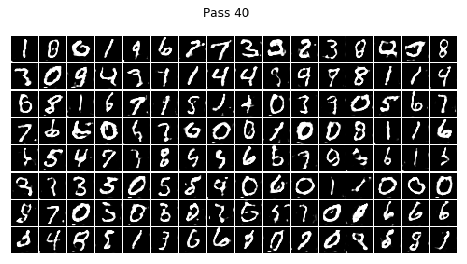

epoch = 40 , batch = 179 , real_d_loss = [0.4139863] , fake_d_loss = [0.7229865] g_loss = [0.6786715]


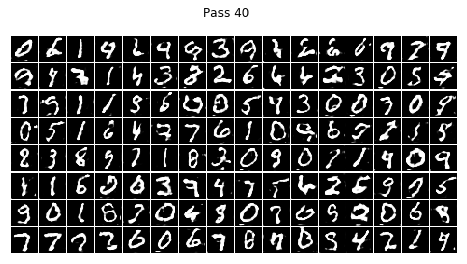

epoch = 40 , batch = 279 , real_d_loss = [0.3925183] , fake_d_loss = [0.7164706] g_loss = [0.68310845]


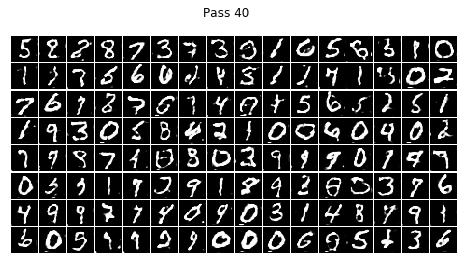

epoch = 40 , batch = 379 , real_d_loss = [0.41760278] , fake_d_loss = [0.7200575] g_loss = [0.6793889]


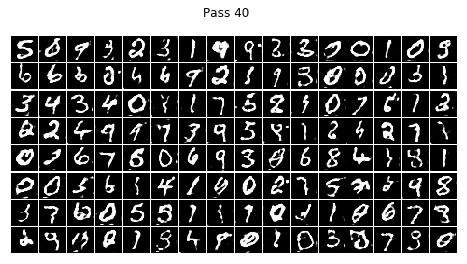

epoch = 41 , batch = 11 , real_d_loss = [0.39573047] , fake_d_loss = [0.7357044] g_loss = [0.67480767]


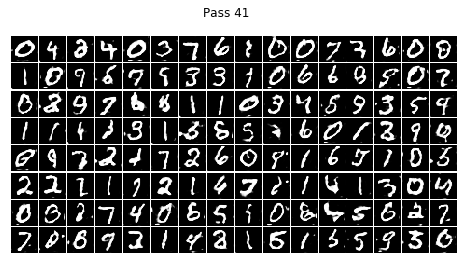

epoch = 41 , batch = 111 , real_d_loss = [0.41884458] , fake_d_loss = [0.7064317] g_loss = [0.68619287]


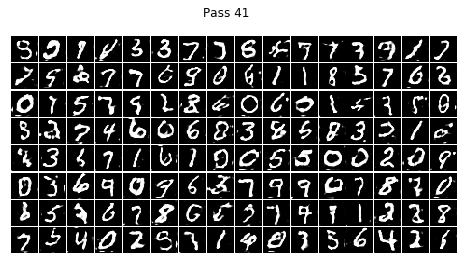

epoch = 41 , batch = 211 , real_d_loss = [0.40287542] , fake_d_loss = [0.7154255] g_loss = [0.68224585]


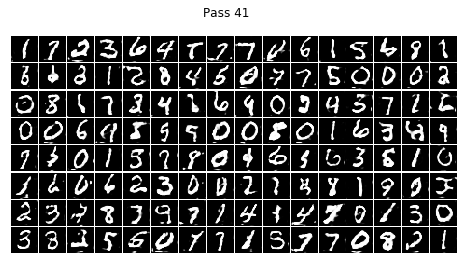

epoch = 41 , batch = 311 , real_d_loss = [0.40434307] , fake_d_loss = [0.71112895] g_loss = [0.684062]


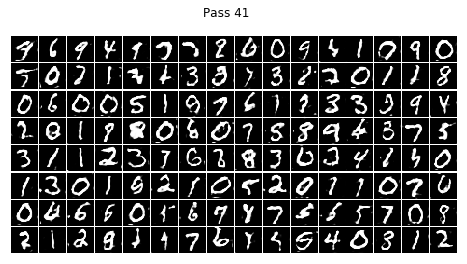

epoch = 41 , batch = 411 , real_d_loss = [0.37944183] , fake_d_loss = [0.7183742] g_loss = [0.68224365]


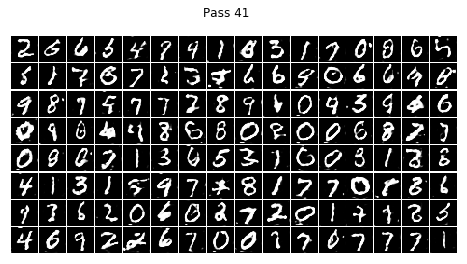

epoch = 42 , batch = 43 , real_d_loss = [0.41009176] , fake_d_loss = [0.72081053] g_loss = [0.67719793]


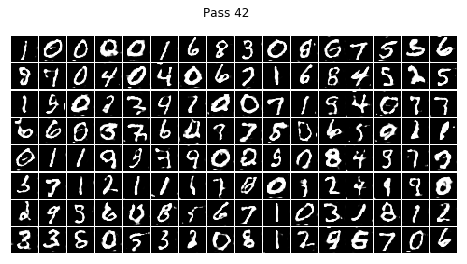

epoch = 42 , batch = 143 , real_d_loss = [0.3980183] , fake_d_loss = [0.7103132] g_loss = [0.68348134]


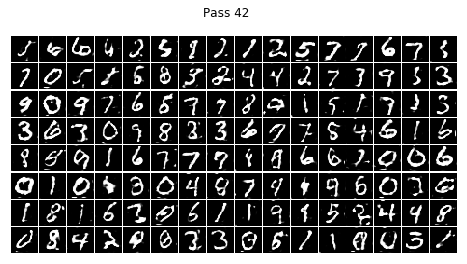

epoch = 42 , batch = 243 , real_d_loss = [0.3934186] , fake_d_loss = [0.7285453] g_loss = [0.6775663]


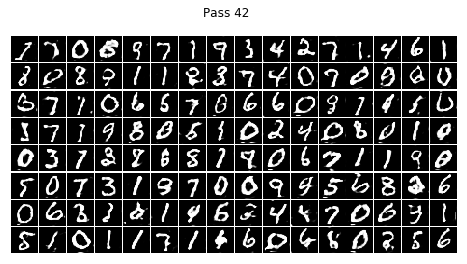

epoch = 42 , batch = 343 , real_d_loss = [0.4078021] , fake_d_loss = [0.7253933] g_loss = [0.6777592]


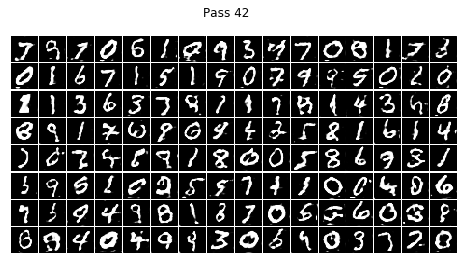

epoch = 42 , batch = 443 , real_d_loss = [0.4412237] , fake_d_loss = [0.7147799] g_loss = [0.68244445]


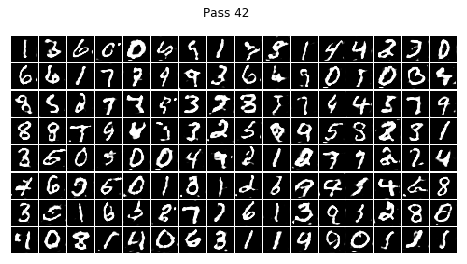

epoch = 43 , batch = 75 , real_d_loss = [0.3957717] , fake_d_loss = [0.7100807] g_loss = [0.68396246]


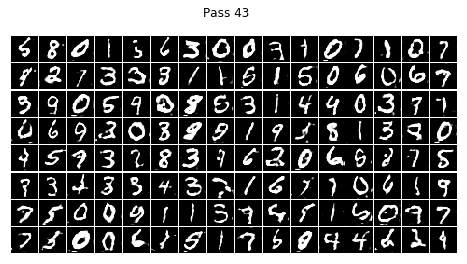

epoch = 43 , batch = 175 , real_d_loss = [0.40070805] , fake_d_loss = [0.7157863] g_loss = [0.68398255]


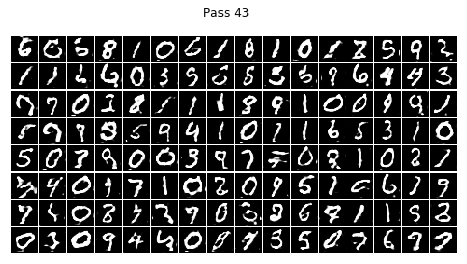

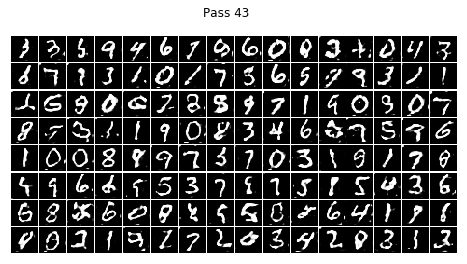

epoch = 43 , batch = 375 , real_d_loss = [0.43629652] , fake_d_loss = [0.7057177] g_loss = [0.6865087]


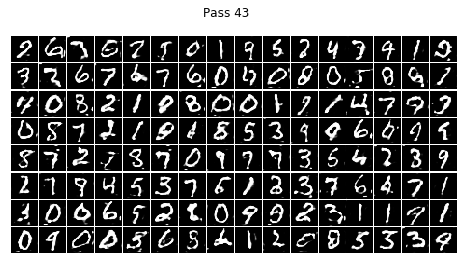

epoch = 44 , batch = 7 , real_d_loss = [0.381998] , fake_d_loss = [0.7206069] g_loss = [0.6815876]


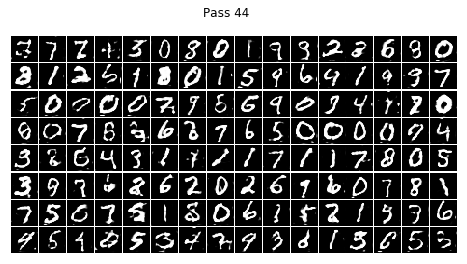

epoch = 44 , batch = 107 , real_d_loss = [0.41306287] , fake_d_loss = [0.7227679] g_loss = [0.6793644]


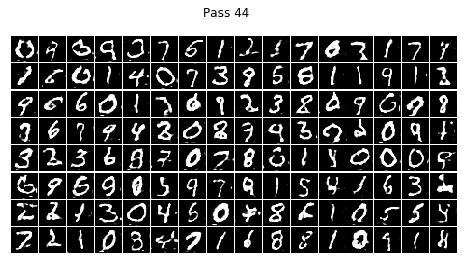

epoch = 44 , batch = 207 , real_d_loss = [0.4060564] , fake_d_loss = [0.7233893] g_loss = [0.6796096]


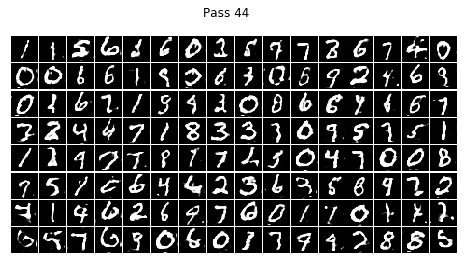

epoch = 44 , batch = 307 , real_d_loss = [0.4026839] , fake_d_loss = [0.71633935] g_loss = [0.68167114]


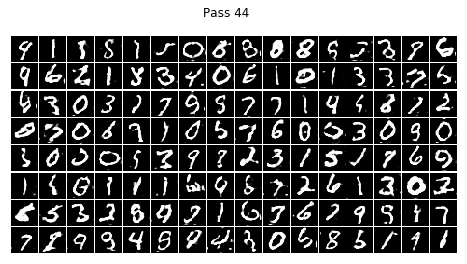

epoch = 44 , batch = 407 , real_d_loss = [0.45996392] , fake_d_loss = [0.7138562] g_loss = [0.68397325]


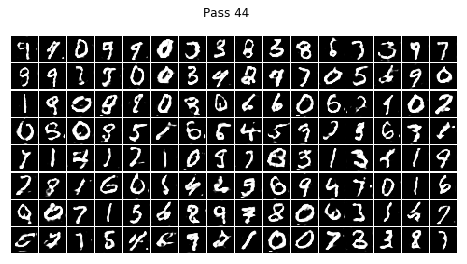

epoch = 45 , batch = 39 , real_d_loss = [0.42233703] , fake_d_loss = [0.7125119] g_loss = [0.6842313]


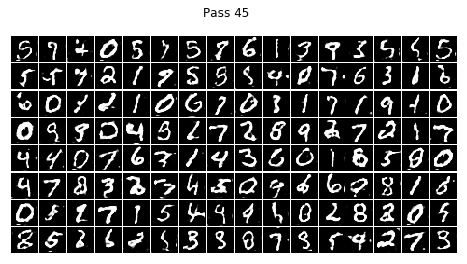

epoch = 45 , batch = 139 , real_d_loss = [0.39336658] , fake_d_loss = [0.71352625] g_loss = [0.68210864]


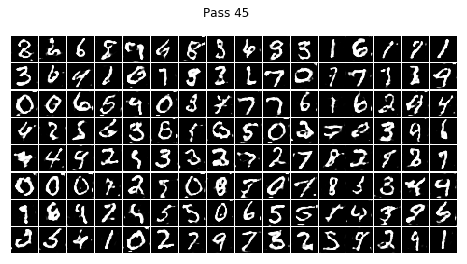

epoch = 45 , batch = 239 , real_d_loss = [0.49583185] , fake_d_loss = [0.7065965] g_loss = [0.6856171]


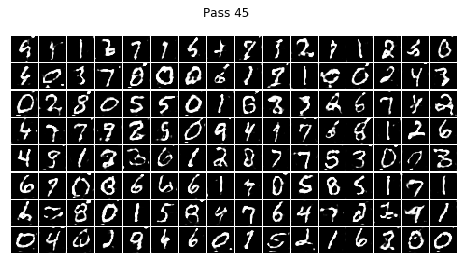

epoch = 45 , batch = 339 , real_d_loss = [0.42775956] , fake_d_loss = [0.71703035] g_loss = [0.6827277]


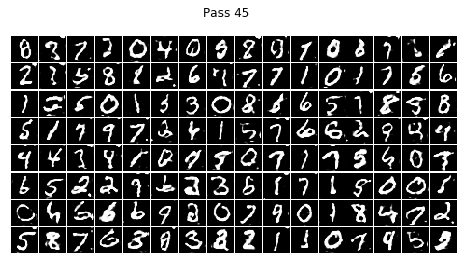

epoch = 45 , batch = 439 , real_d_loss = [0.41505158] , fake_d_loss = [0.7060489] g_loss = [0.6859183]


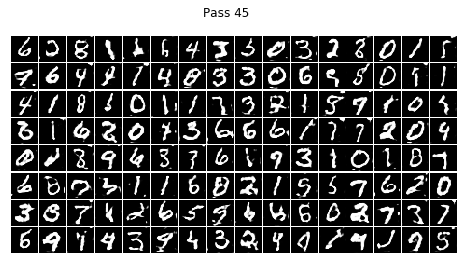

epoch = 46 , batch = 71 , real_d_loss = [0.40065426] , fake_d_loss = [0.7150603] g_loss = [0.68280905]


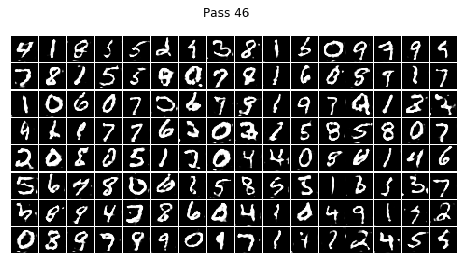

epoch = 46 , batch = 271 , real_d_loss = [0.3947998] , fake_d_loss = [0.7124251] g_loss = [0.6826469]


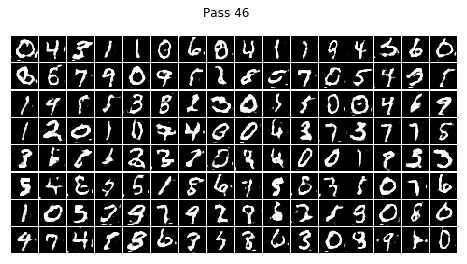

epoch = 46 , batch = 371 , real_d_loss = [0.41183242] , fake_d_loss = [0.7218815] g_loss = [0.6783886]


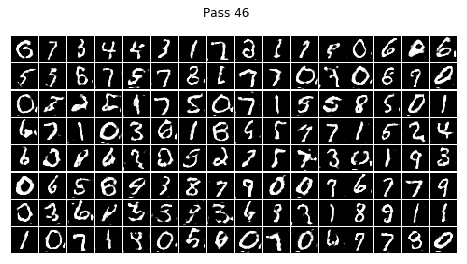

epoch = 47 , batch = 3 , real_d_loss = [0.4245642] , fake_d_loss = [0.72784364] g_loss = [0.67466295]


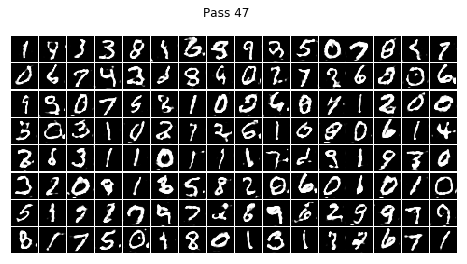

epoch = 47 , batch = 103 , real_d_loss = [0.41015148] , fake_d_loss = [0.72995865] g_loss = [0.674403]


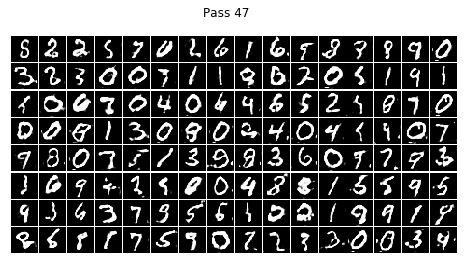

epoch = 47 , batch = 203 , real_d_loss = [0.4652951] , fake_d_loss = [0.7175671] g_loss = [0.681541]


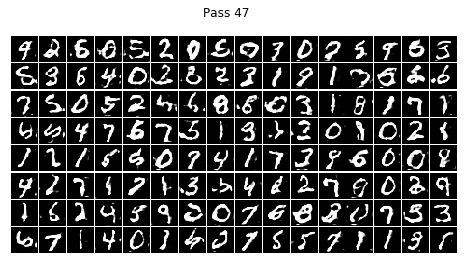

epoch = 47 , batch = 303 , real_d_loss = [0.4475274] , fake_d_loss = [0.7141264] g_loss = [0.68387944]


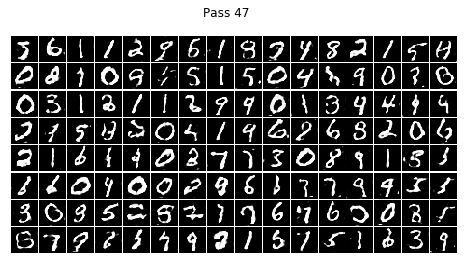

epoch = 47 , batch = 403 , real_d_loss = [0.4004416] , fake_d_loss = [0.7164856] g_loss = [0.68039757]


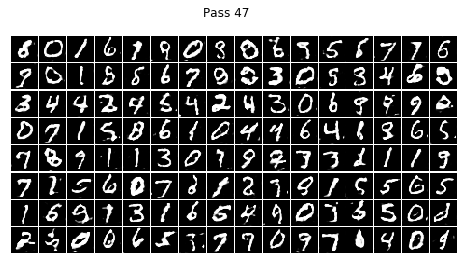

epoch = 48 , batch = 35 , real_d_loss = [0.3865273] , fake_d_loss = [0.72571415] g_loss = [0.6769767]


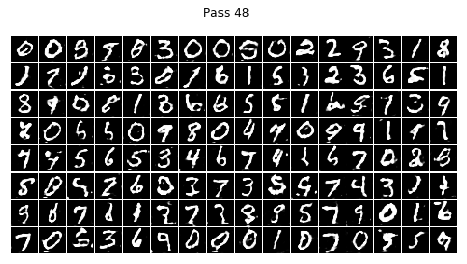

epoch = 48 , batch = 135 , real_d_loss = [0.4210745] , fake_d_loss = [0.7157271] g_loss = [0.68425995]


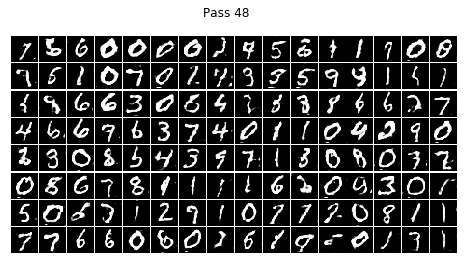

epoch = 48 , batch = 235 , real_d_loss = [0.39957976] , fake_d_loss = [0.72690904] g_loss = [0.6767313]


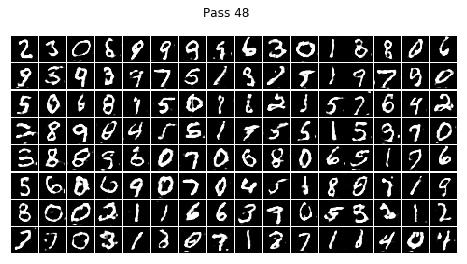

epoch = 48 , batch = 335 , real_d_loss = [0.4157508] , fake_d_loss = [0.71104825] g_loss = [0.6843287]


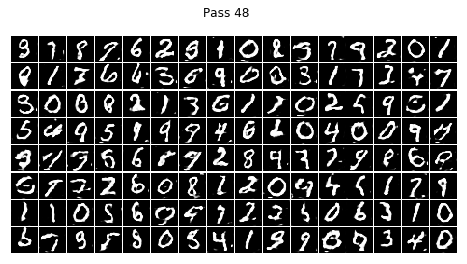

epoch = 48 , batch = 435 , real_d_loss = [0.42986715] , fake_d_loss = [0.7159699] g_loss = [0.6824176]


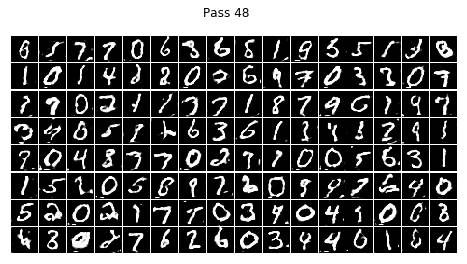

epoch = 49 , batch = 67 , real_d_loss = [0.42424262] , fake_d_loss = [0.72914916] g_loss = [0.6790091]


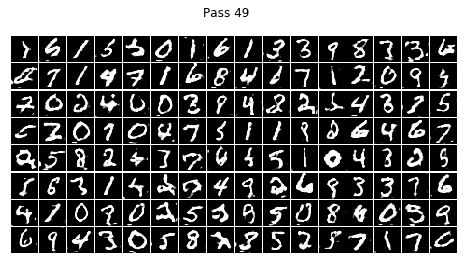

epoch = 49 , batch = 167 , real_d_loss = [0.42668536] , fake_d_loss = [0.7307061] g_loss = [0.67563075]


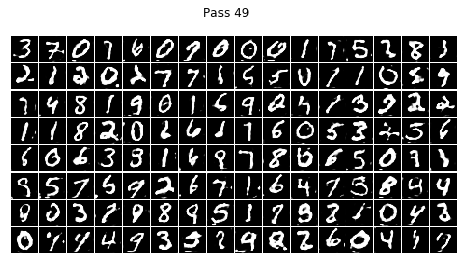

epoch = 49 , batch = 267 , real_d_loss = [0.4233827] , fake_d_loss = [0.7035908] g_loss = [0.6883043]


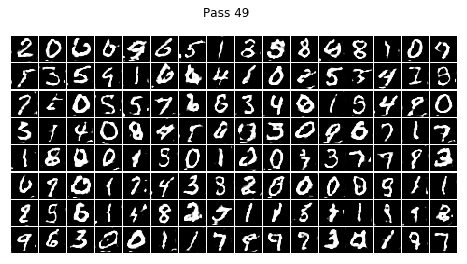

epoch = 49 , batch = 367 , real_d_loss = [0.41494894] , fake_d_loss = [0.72394556] g_loss = [0.6793854]


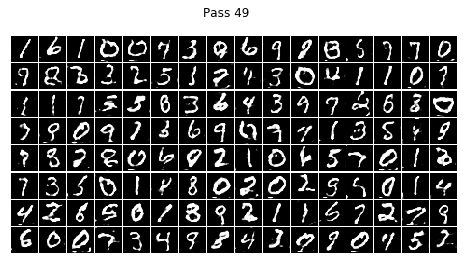

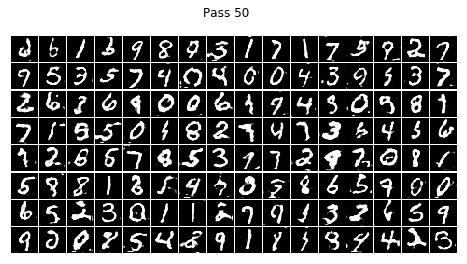

epoch = 50 , batch = 199 , real_d_loss = [0.43858558] , fake_d_loss = [0.7085097] g_loss = [0.6857517]


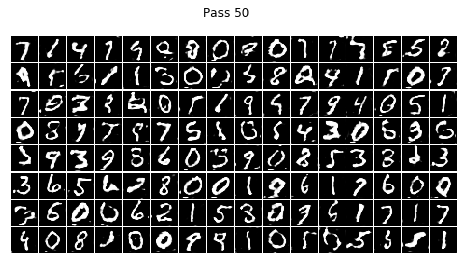

epoch = 50 , batch = 299 , real_d_loss = [0.38844377] , fake_d_loss = [0.733423] g_loss = [0.6768756]


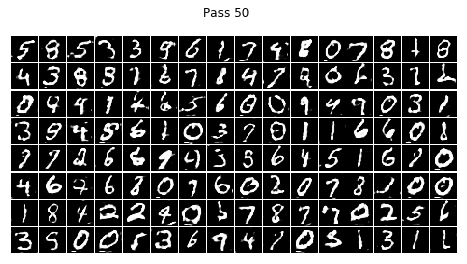

epoch = 50 , batch = 399 , real_d_loss = [0.4277385] , fake_d_loss = [0.7177502] g_loss = [0.68236434]


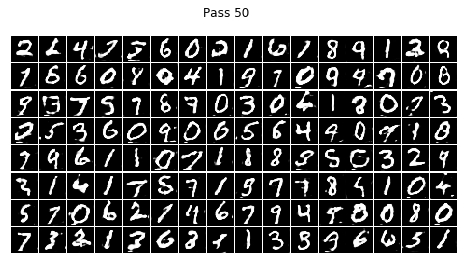

epoch = 51 , batch = 31 , real_d_loss = [0.44349897] , fake_d_loss = [0.7266222] g_loss = [0.67907506]


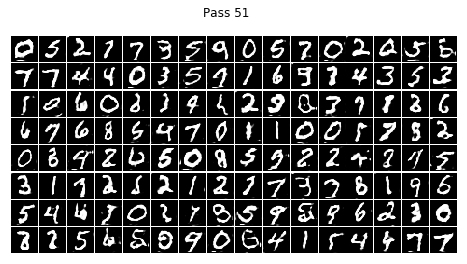

epoch = 51 , batch = 131 , real_d_loss = [0.41759372] , fake_d_loss = [0.71126544] g_loss = [0.6856164]


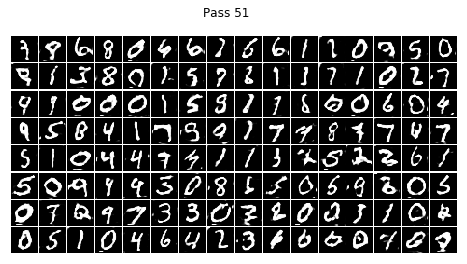

epoch = 51 , batch = 231 , real_d_loss = [0.5273588] , fake_d_loss = [0.7133068] g_loss = [0.68467844]


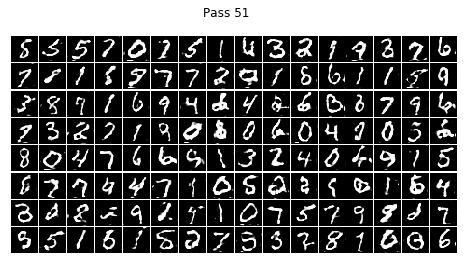

epoch = 51 , batch = 331 , real_d_loss = [0.42963475] , fake_d_loss = [0.70817214] g_loss = [0.68480337]


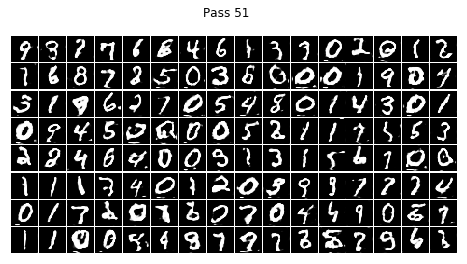

epoch = 51 , batch = 431 , real_d_loss = [0.39943486] , fake_d_loss = [0.7087926] g_loss = [0.68494725]


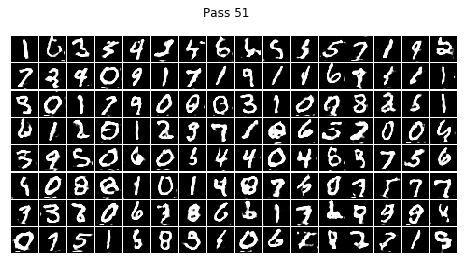

epoch = 52 , batch = 63 , real_d_loss = [0.41071236] , fake_d_loss = [0.71234375] g_loss = [0.68347037]


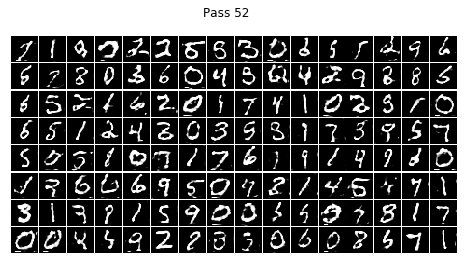

epoch = 52 , batch = 163 , real_d_loss = [0.42068976] , fake_d_loss = [0.71206605] g_loss = [0.68435323]


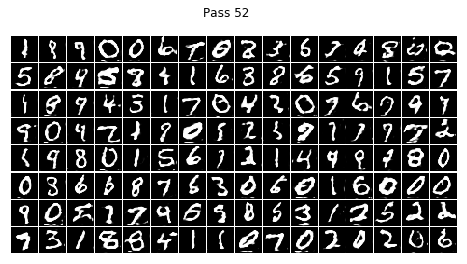

epoch = 52 , batch = 263 , real_d_loss = [0.4095974] , fake_d_loss = [0.7324214] g_loss = [0.67719126]


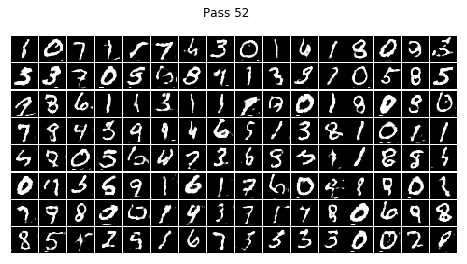

epoch = 52 , batch = 363 , real_d_loss = [0.40824145] , fake_d_loss = [0.72364765] g_loss = [0.6794016]


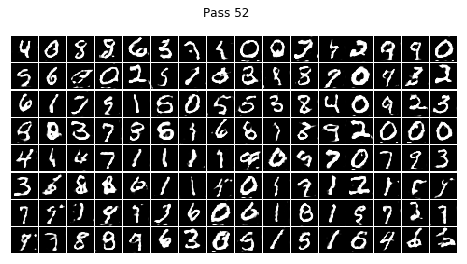

epoch = 52 , batch = 463 , real_d_loss = [0.39489523] , fake_d_loss = [0.7224101] g_loss = [0.6798797]


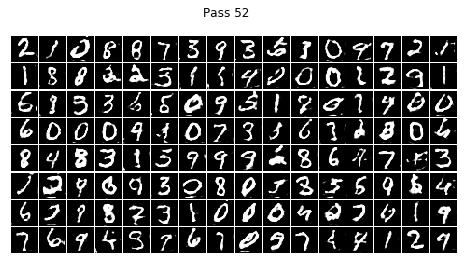

epoch = 53 , batch = 95 , real_d_loss = [0.39324194] , fake_d_loss = [0.70833266] g_loss = [0.68670285]


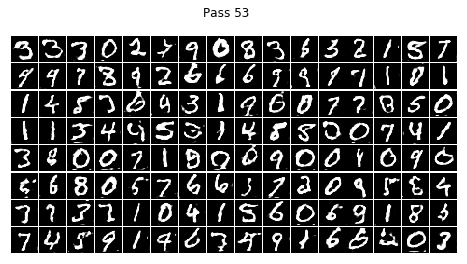

epoch = 53 , batch = 195 , real_d_loss = [0.40664065] , fake_d_loss = [0.72183293] g_loss = [0.6820671]


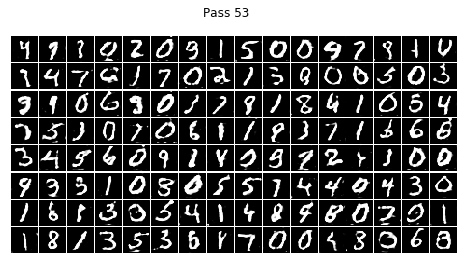

epoch = 53 , batch = 295 , real_d_loss = [0.49407992] , fake_d_loss = [0.70549583] g_loss = [0.6880162]


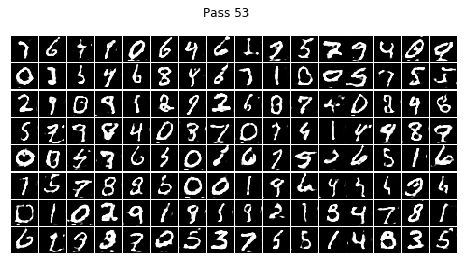

epoch = 53 , batch = 395 , real_d_loss = [0.4556083] , fake_d_loss = [0.71795785] g_loss = [0.681072]


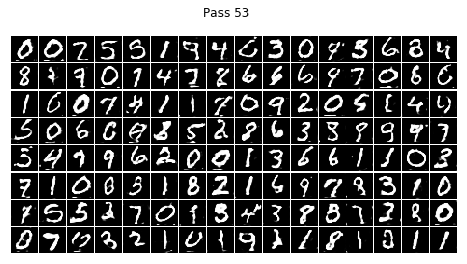

epoch = 54 , batch = 27 , real_d_loss = [0.41403273] , fake_d_loss = [0.71458685] g_loss = [0.68375057]


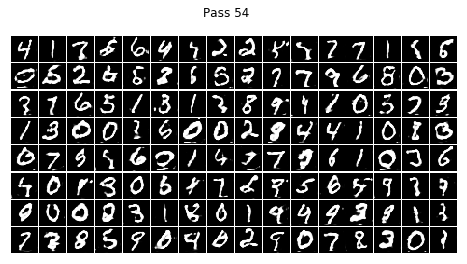

epoch = 54 , batch = 127 , real_d_loss = [0.42342922] , fake_d_loss = [0.72469467] g_loss = [0.6764404]


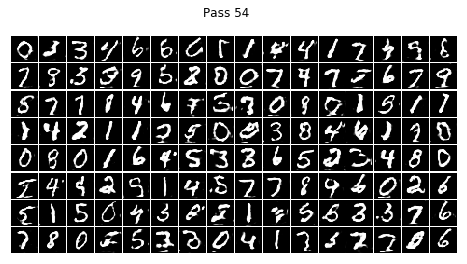

epoch = 54 , batch = 227 , real_d_loss = [0.43190825] , fake_d_loss = [0.7229031] g_loss = [0.67821836]


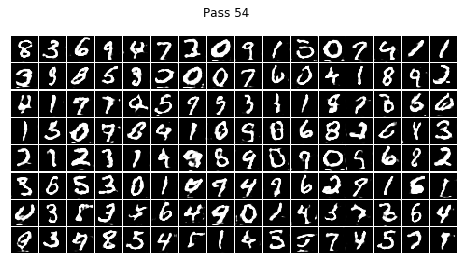

epoch = 54 , batch = 327 , real_d_loss = [0.44998747] , fake_d_loss = [0.7056196] g_loss = [0.6874275]


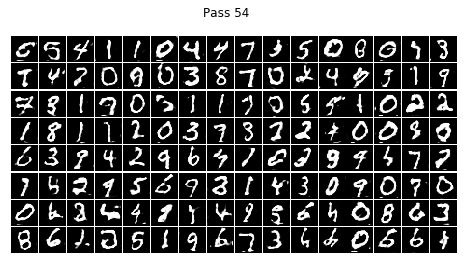

epoch = 54 , batch = 427 , real_d_loss = [0.4559675] , fake_d_loss = [0.7096353] g_loss = [0.68495446]


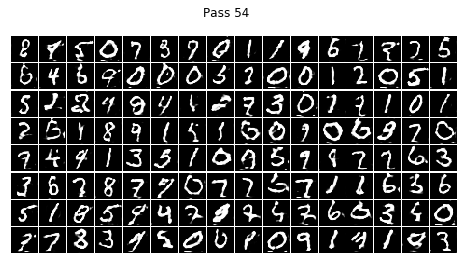

epoch = 55 , batch = 59 , real_d_loss = [0.41031432] , fake_d_loss = [0.71543443] g_loss = [0.6796476]


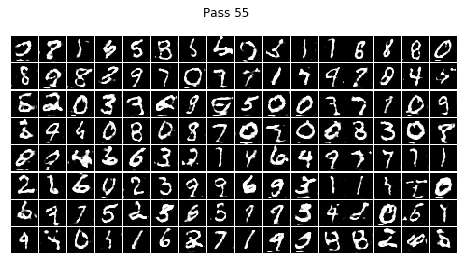

epoch = 55 , batch = 159 , real_d_loss = [0.41824752] , fake_d_loss = [0.71507037] g_loss = [0.68154967]


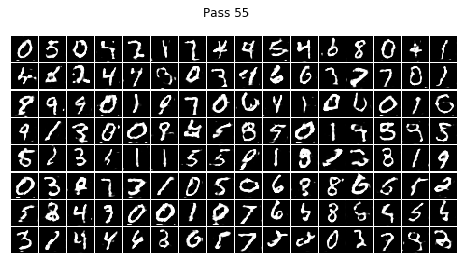

epoch = 55 , batch = 259 , real_d_loss = [0.40553015] , fake_d_loss = [0.72462726] g_loss = [0.6801089]


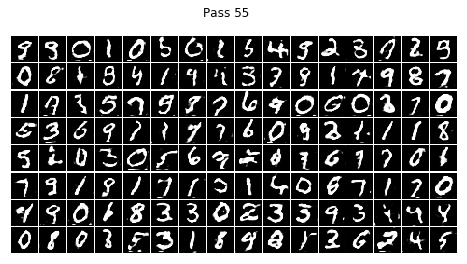

epoch = 55 , batch = 359 , real_d_loss = [0.41441506] , fake_d_loss = [0.7116972] g_loss = [0.6854695]


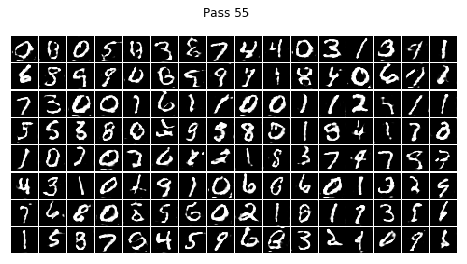

epoch = 55 , batch = 459 , real_d_loss = [0.48180315] , fake_d_loss = [0.709665] g_loss = [0.6853396]


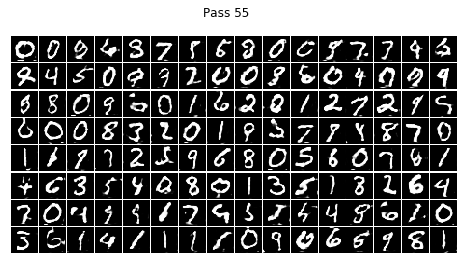

epoch = 56 , batch = 91 , real_d_loss = [0.41951987] , fake_d_loss = [0.7245948] g_loss = [0.6790416]


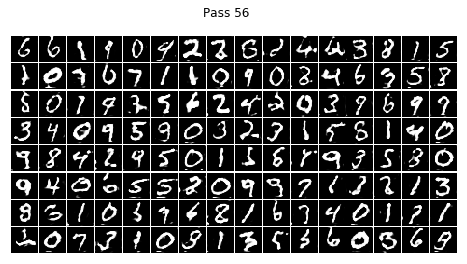

epoch = 56 , batch = 191 , real_d_loss = [0.41037154] , fake_d_loss = [0.7239843] g_loss = [0.6811736]


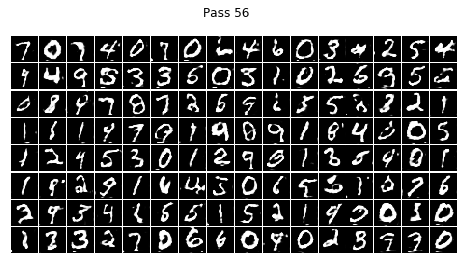

epoch = 56 , batch = 291 , real_d_loss = [0.3886873] , fake_d_loss = [0.71714044] g_loss = [0.6825592]


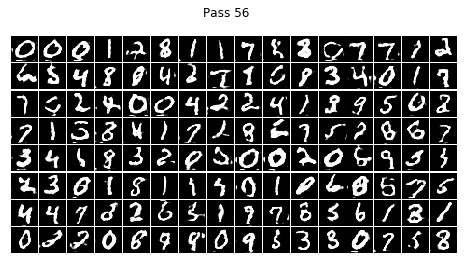

epoch = 56 , batch = 391 , real_d_loss = [0.4718601] , fake_d_loss = [0.7074836] g_loss = [0.68469644]


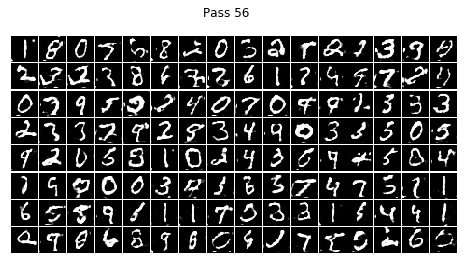

epoch = 57 , batch = 23 , real_d_loss = [0.43318906] , fake_d_loss = [0.7232749] g_loss = [0.6796855]


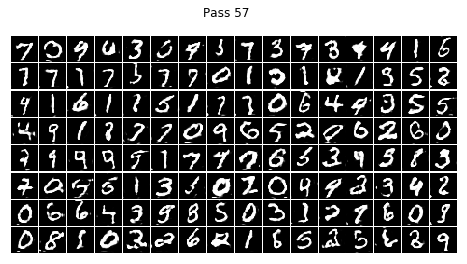

epoch = 57 , batch = 123 , real_d_loss = [0.42311618] , fake_d_loss = [0.7045849] g_loss = [0.68654454]


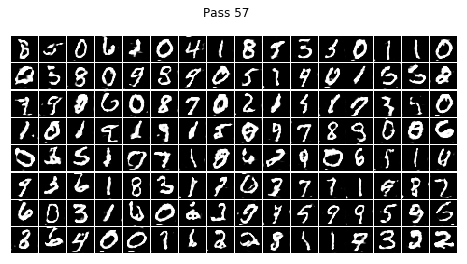

epoch = 57 , batch = 223 , real_d_loss = [0.4030009] , fake_d_loss = [0.73717785] g_loss = [0.6758957]


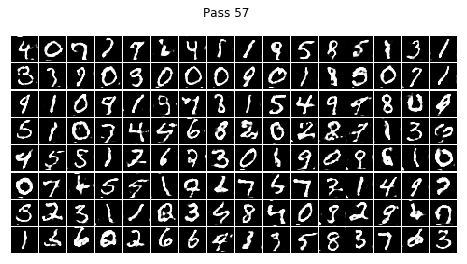

epoch = 57 , batch = 323 , real_d_loss = [0.39967853] , fake_d_loss = [0.7092535] g_loss = [0.6854398]


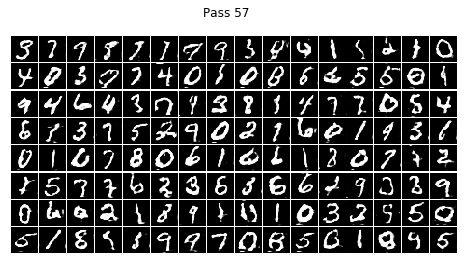

epoch = 57 , batch = 423 , real_d_loss = [0.4177535] , fake_d_loss = [0.7121778] g_loss = [0.6845223]


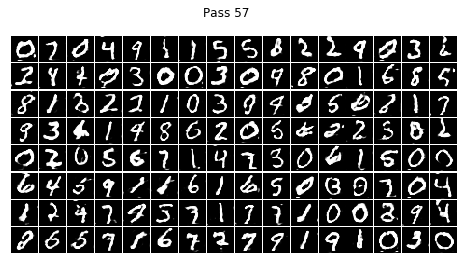

epoch = 58 , batch = 55 , real_d_loss = [0.42768613] , fake_d_loss = [0.72695506] g_loss = [0.6796749]


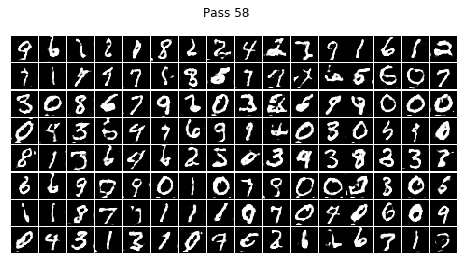

epoch = 58 , batch = 155 , real_d_loss = [0.42968076] , fake_d_loss = [0.7112007] g_loss = [0.68540657]


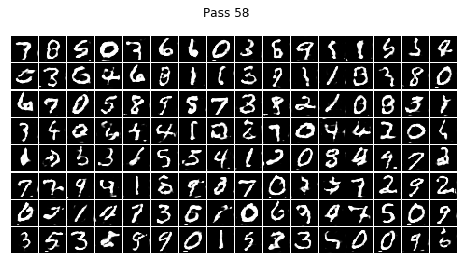

epoch = 58 , batch = 255 , real_d_loss = [0.4417361] , fake_d_loss = [0.71402025] g_loss = [0.68391687]


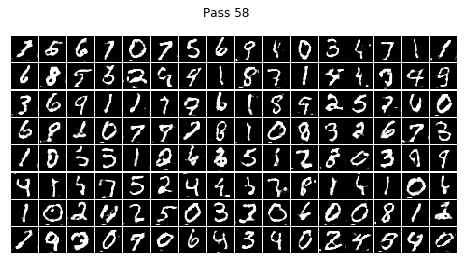

epoch = 58 , batch = 355 , real_d_loss = [0.39857513] , fake_d_loss = [0.70580965] g_loss = [0.6850171]


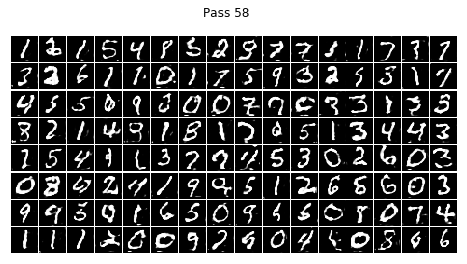

epoch = 58 , batch = 455 , real_d_loss = [0.4791049] , fake_d_loss = [0.72706854] g_loss = [0.6764794]


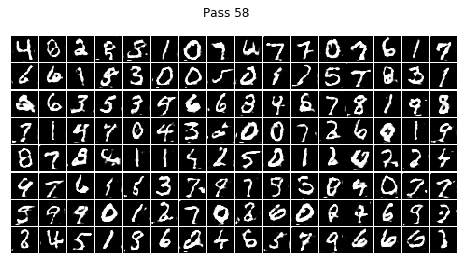

epoch = 59 , batch = 87 , real_d_loss = [0.40090936] , fake_d_loss = [0.7061435] g_loss = [0.6868591]


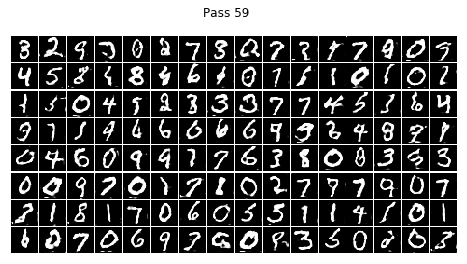

epoch = 59 , batch = 187 , real_d_loss = [0.45873374] , fake_d_loss = [0.7118768] g_loss = [0.6853111]


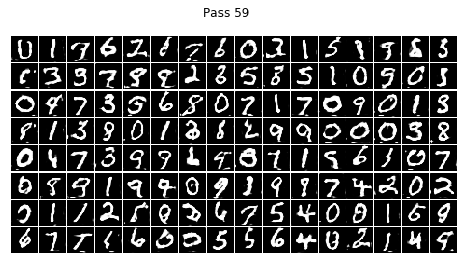

epoch = 59 , batch = 287 , real_d_loss = [0.40821683] , fake_d_loss = [0.71138406] g_loss = [0.6836205]


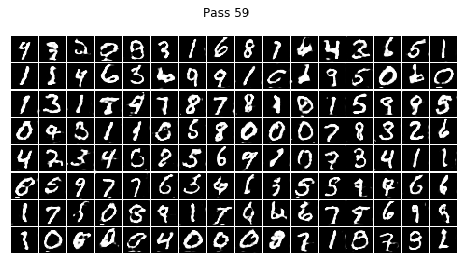

epoch = 59 , batch = 387 , real_d_loss = [0.43324578] , fake_d_loss = [0.71830565] g_loss = [0.68147534]


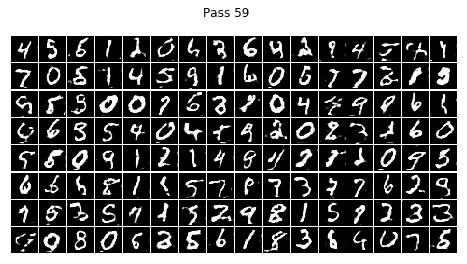

epoch = 60 , batch = 19 , real_d_loss = [0.4137922] , fake_d_loss = [0.71971124] g_loss = [0.6811307]


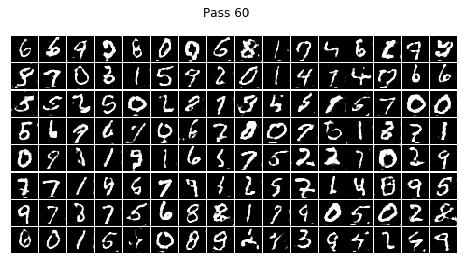

epoch = 60 , batch = 119 , real_d_loss = [0.42402387] , fake_d_loss = [0.7158495] g_loss = [0.68429184]


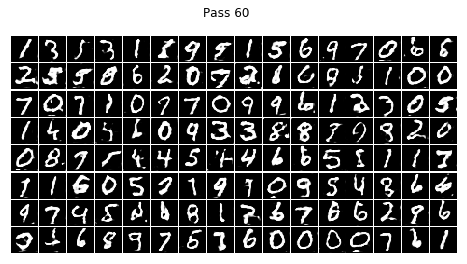

epoch = 60 , batch = 219 , real_d_loss = [0.4084613] , fake_d_loss = [0.71806186] g_loss = [0.6792603]


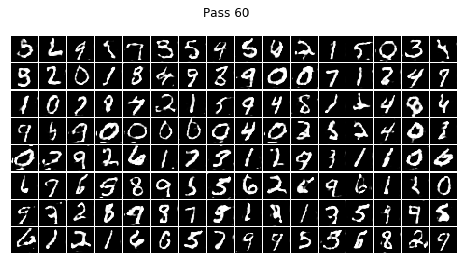

epoch = 60 , batch = 319 , real_d_loss = [0.4105456] , fake_d_loss = [0.7036694] g_loss = [0.68738294]


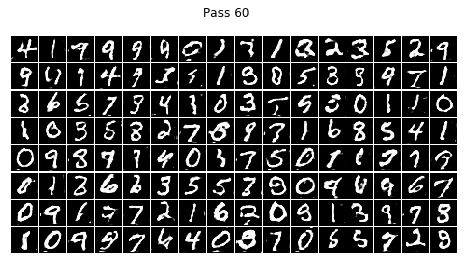

epoch = 60 , batch = 419 , real_d_loss = [0.40485036] , fake_d_loss = [0.72299725] g_loss = [0.6790467]


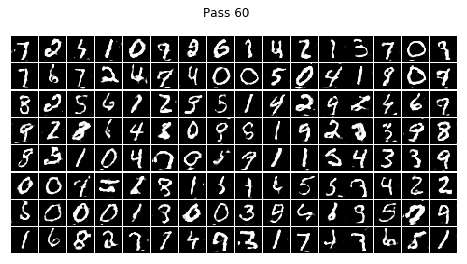

epoch = 61 , batch = 51 , real_d_loss = [0.42218372] , fake_d_loss = [0.71405095] g_loss = [0.6845171]


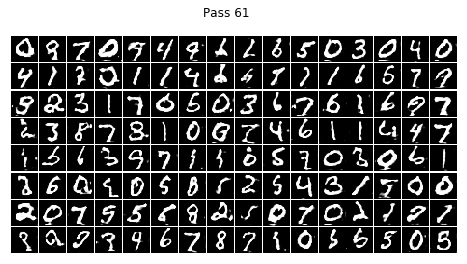

epoch = 61 , batch = 151 , real_d_loss = [0.4337542] , fake_d_loss = [0.7224307] g_loss = [0.67975533]
epoch = 61 , batch = 251 , real_d_loss = [0.47486162] , fake_d_loss = [0.7226025] g_loss = [0.67974687]
epoch = 62 , batch = 283 , real_d_loss = [0.40068865] , fake_d_loss = [0.70591325] g_loss = [0.6858913]


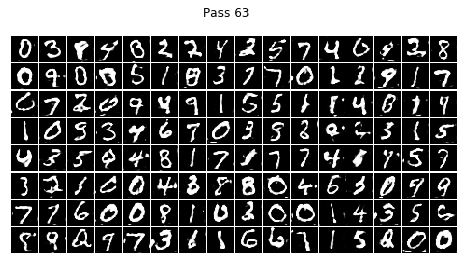

epoch = 63 , batch = 215 , real_d_loss = [0.50317574] , fake_d_loss = [0.710499] g_loss = [0.6834327]
epoch = 64 , batch = 47 , real_d_loss = [0.42219022] , fake_d_loss = [0.7319572] g_loss = [0.67626995]


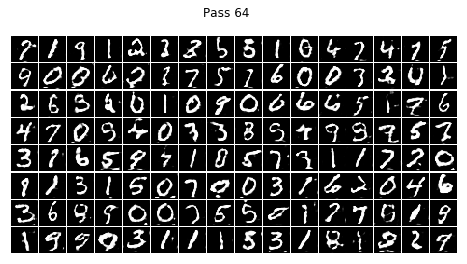

epoch = 64 , batch = 147 , real_d_loss = [0.39701366] , fake_d_loss = [0.7127204] g_loss = [0.68355167]


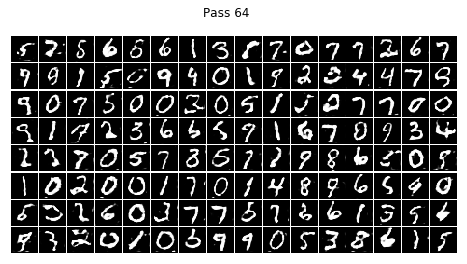

epoch = 64 , batch = 247 , real_d_loss = [0.42962465] , fake_d_loss = [0.71032727] g_loss = [0.68492925]
epoch = 65 , batch = 79 , real_d_loss = [0.46548888] , fake_d_loss = [0.701103] g_loss = [0.6889516]


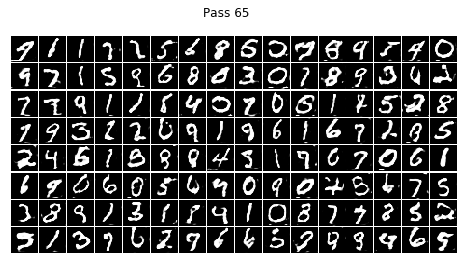

epoch = 65 , batch = 179 , real_d_loss = [0.4075771] , fake_d_loss = [0.7207017] g_loss = [0.6805599]


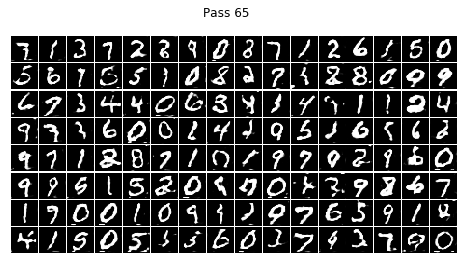

epoch = 65 , batch = 279 , real_d_loss = [0.42730588] , fake_d_loss = [0.70565504] g_loss = [0.68693864]


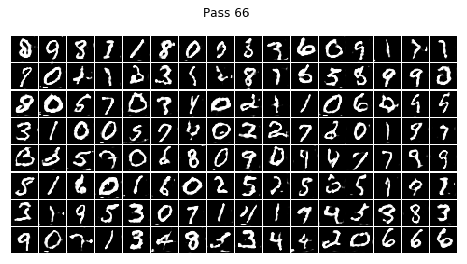

epoch = 66 , batch = 211 , real_d_loss = [0.42071486] , fake_d_loss = [0.722406] g_loss = [0.6803531]


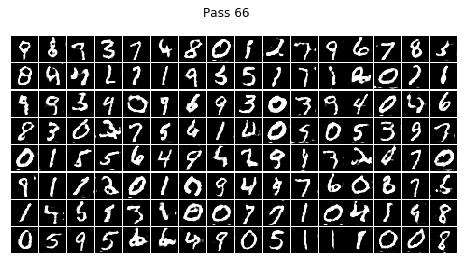

epoch = 66 , batch = 311 , real_d_loss = [0.39270157] , fake_d_loss = [0.70987016] g_loss = [0.6833768]


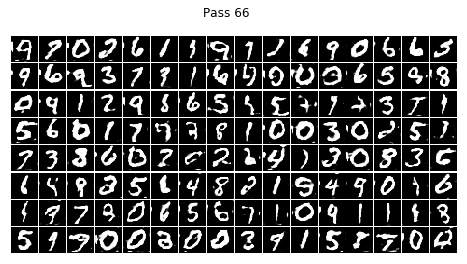

epoch = 66 , batch = 411 , real_d_loss = [0.4023957] , fake_d_loss = [0.7073484] g_loss = [0.6855482]


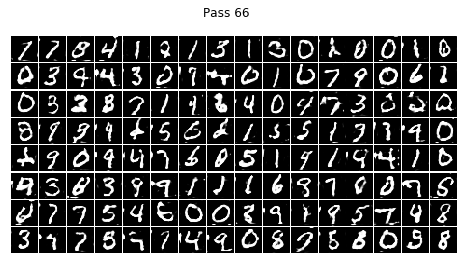

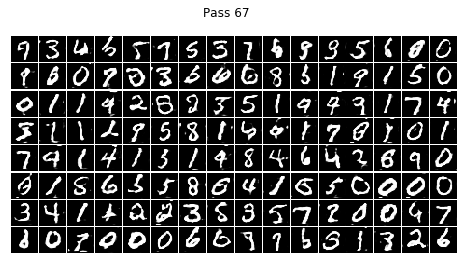

epoch = 67 , batch = 143 , real_d_loss = [0.39653158] , fake_d_loss = [0.7160357] g_loss = [0.6848501]


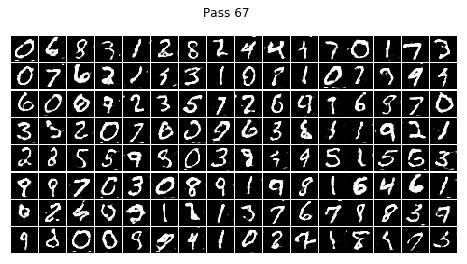

epoch = 67 , batch = 243 , real_d_loss = [0.43485695] , fake_d_loss = [0.71321946] g_loss = [0.6855047]
epoch = 68 , batch = 75 , real_d_loss = [0.40570724] , fake_d_loss = [0.70620453] g_loss = [0.6880305]


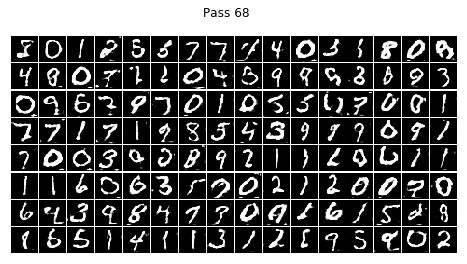

epoch = 68 , batch = 175 , real_d_loss = [0.49415886] , fake_d_loss = [0.6995581] g_loss = [0.6902408]
epoch = 69 , batch = 7 , real_d_loss = [0.42038935] , fake_d_loss = [0.7086962] g_loss = [0.687147]


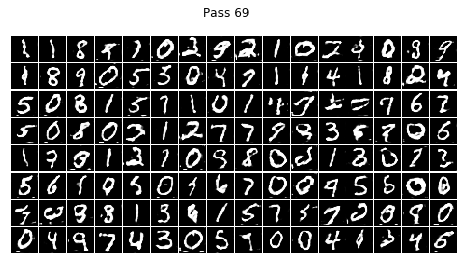

epoch = 69 , batch = 107 , real_d_loss = [0.4193752] , fake_d_loss = [0.7180743] g_loss = [0.68417823]


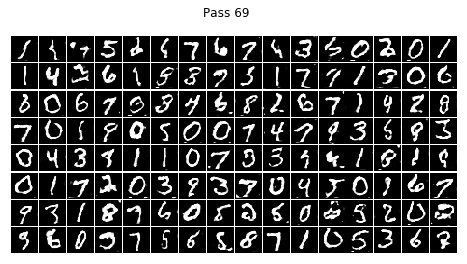

epoch = 69 , batch = 207 , real_d_loss = [0.44198972] , fake_d_loss = [0.71639544] g_loss = [0.6835818]
epoch = 70 , batch = 339 , real_d_loss = [0.44511396] , fake_d_loss = [0.70504653] g_loss = [0.68766975]


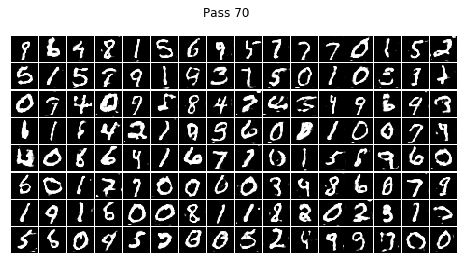

epoch = 70 , batch = 439 , real_d_loss = [0.41204762] , fake_d_loss = [0.71015537] g_loss = [0.6848398]


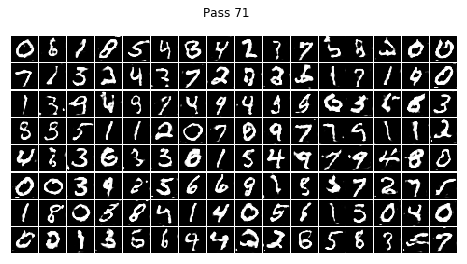

epoch = 71 , batch = 371 , real_d_loss = [0.4174332] , fake_d_loss = [0.71401954] g_loss = [0.68333036]


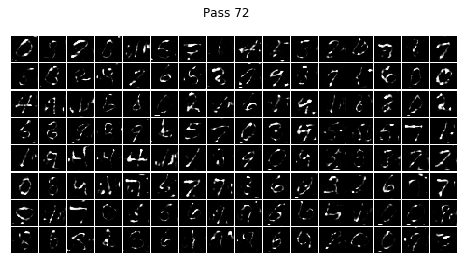

epoch = 72 , batch = 203 , real_d_loss = [0.37286085] , fake_d_loss = [0.6949817] g_loss = [0.69160104]


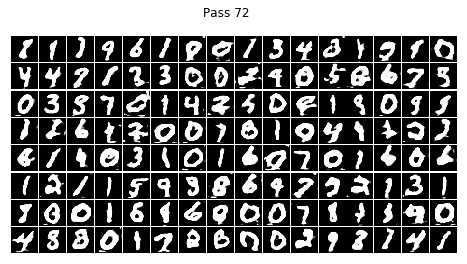

epoch = 72 , batch = 303 , real_d_loss = [0.37934342] , fake_d_loss = [0.69918704] g_loss = [0.68888897]


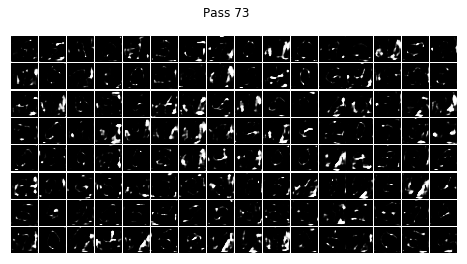

epoch = 73 , batch = 135 , real_d_loss = [0.36110044] , fake_d_loss = [0.6941249] g_loss = [0.69222486]


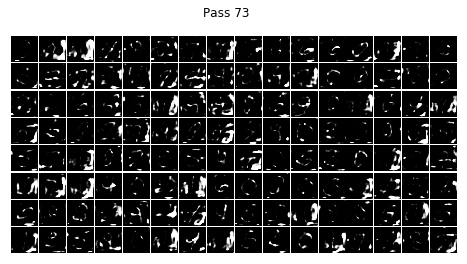

epoch = 73 , batch = 235 , real_d_loss = [0.37494668] , fake_d_loss = [0.6952007] g_loss = [0.69145036]


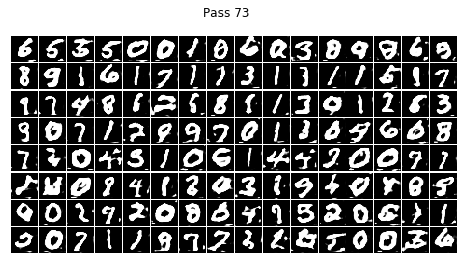

epoch = 73 , batch = 435 , real_d_loss = [0.367969] , fake_d_loss = [0.69394577] g_loss = [0.6923916]


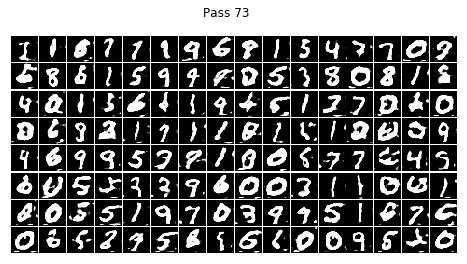

epoch = 74 , batch = 67 , real_d_loss = [0.36341724] , fake_d_loss = [0.69367695] g_loss = [0.6926285]
epoch = 74 , batch = 267 , real_d_loss = [0.3566587] , fake_d_loss = [0.69464755] g_loss = [0.6920296]


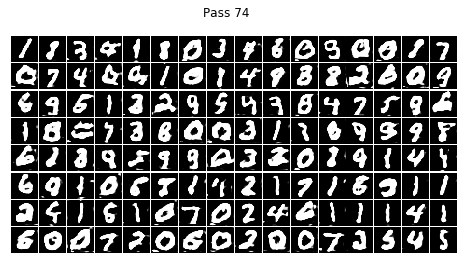

epoch = 74 , batch = 367 , real_d_loss = [0.37207854] , fake_d_loss = [0.69386214] g_loss = [0.6924741]
epoch = 75 , batch = 99 , real_d_loss = [0.42294154] , fake_d_loss = [0.6937701] g_loss = [0.6926784]


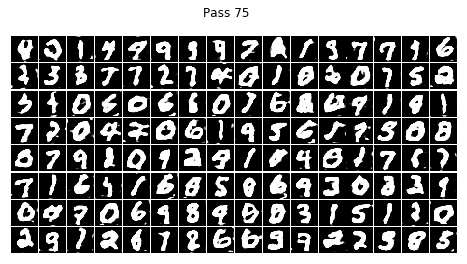

epoch = 75 , batch = 199 , real_d_loss = [0.37098014] , fake_d_loss = [0.6938844] g_loss = [0.69246507]


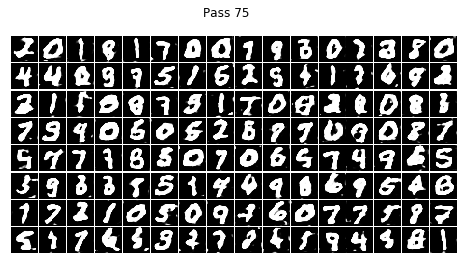

epoch = 75 , batch = 299 , real_d_loss = [0.34887493] , fake_d_loss = [0.69365776] g_loss = [0.69264895]


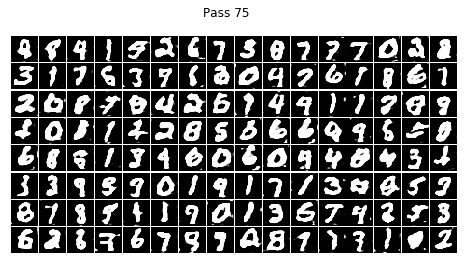

epoch = 75 , batch = 399 , real_d_loss = [0.36335093] , fake_d_loss = [0.6936846] g_loss = [0.69262195]


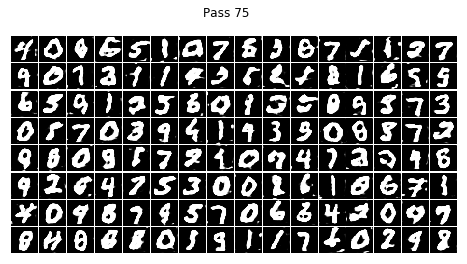

epoch = 76 , batch = 31 , real_d_loss = [0.3414777] , fake_d_loss = [0.69456494] g_loss = [0.6918312]


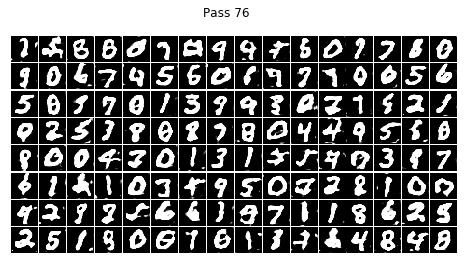

epoch = 76 , batch = 131 , real_d_loss = [0.3530735] , fake_d_loss = [0.69530743] g_loss = [0.6912967]


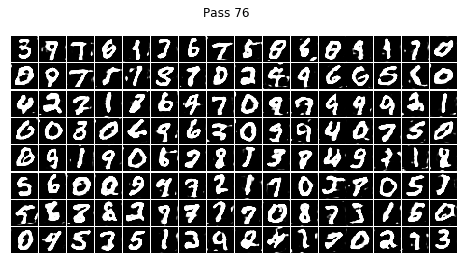

epoch = 76 , batch = 231 , real_d_loss = [0.36686817] , fake_d_loss = [0.72268534] g_loss = [0.6809528]


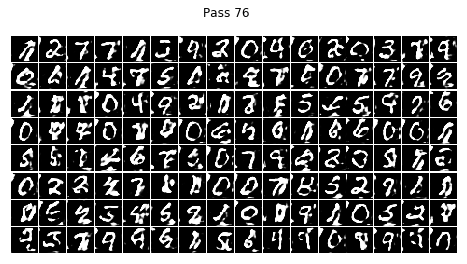

epoch = 76 , batch = 331 , real_d_loss = [0.3524786] , fake_d_loss = [0.72553724] g_loss = [0.68065953]


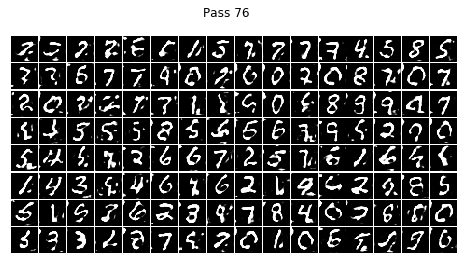

epoch = 76 , batch = 431 , real_d_loss = [0.38116068] , fake_d_loss = [0.7016137] g_loss = [0.68794733]


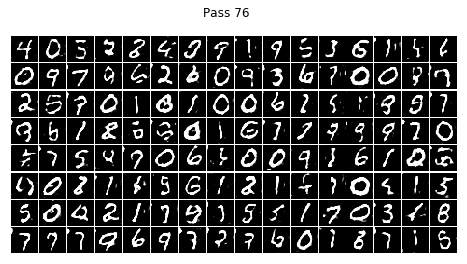

epoch = 77 , batch = 63 , real_d_loss = [0.3706525] , fake_d_loss = [0.701275] g_loss = [0.68875134]


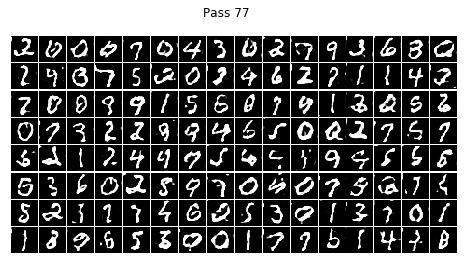

epoch = 77 , batch = 163 , real_d_loss = [0.37834373] , fake_d_loss = [0.7231537] g_loss = [0.68152016]


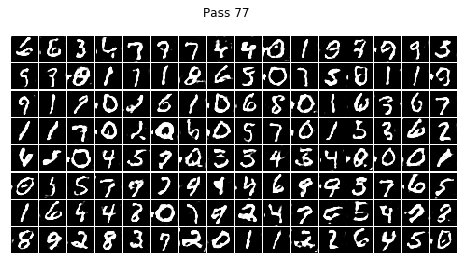

epoch = 77 , batch = 263 , real_d_loss = [0.38881844] , fake_d_loss = [0.7129922] g_loss = [0.684006]


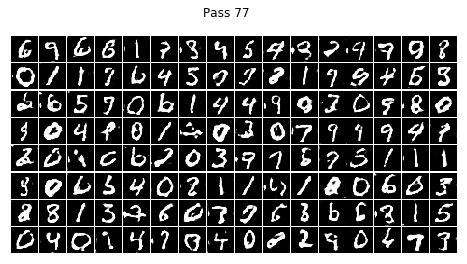

epoch = 77 , batch = 363 , real_d_loss = [0.4086047] , fake_d_loss = [0.72828734] g_loss = [0.67871153]


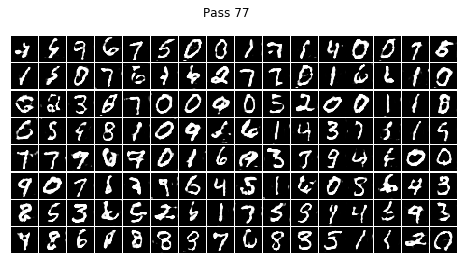

epoch = 77 , batch = 463 , real_d_loss = [0.37818205] , fake_d_loss = [0.70140064] g_loss = [0.68929565]


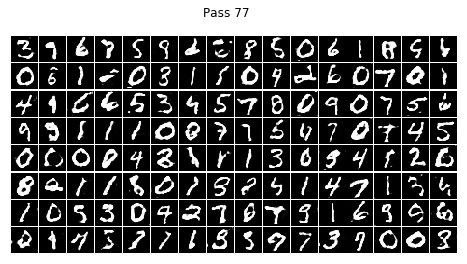

epoch = 78 , batch = 95 , real_d_loss = [0.40185758] , fake_d_loss = [0.7113334] g_loss = [0.685724]


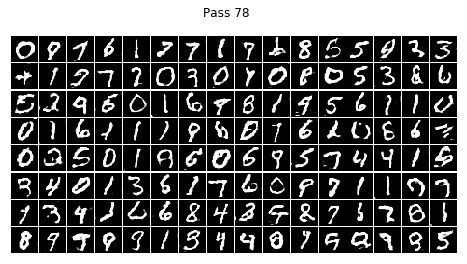

epoch = 78 , batch = 195 , real_d_loss = [0.42858884] , fake_d_loss = [0.70442295] g_loss = [0.6893351]


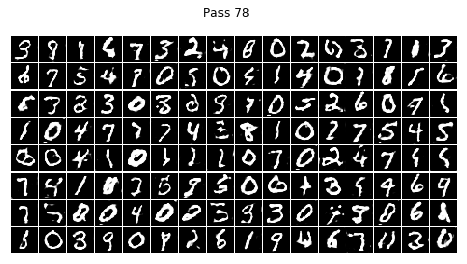

epoch = 78 , batch = 295 , real_d_loss = [0.39683712] , fake_d_loss = [0.7244127] g_loss = [0.6809264]


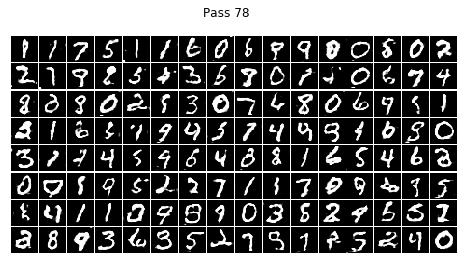

epoch = 78 , batch = 395 , real_d_loss = [0.38790062] , fake_d_loss = [0.71355754] g_loss = [0.6856944]


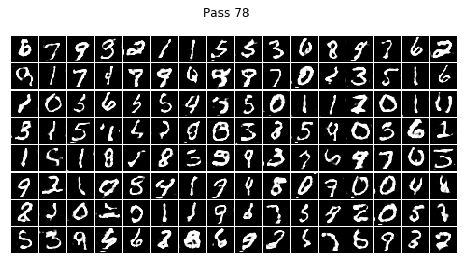

epoch = 79 , batch = 27 , real_d_loss = [0.41188467] , fake_d_loss = [0.7090177] g_loss = [0.68600035]


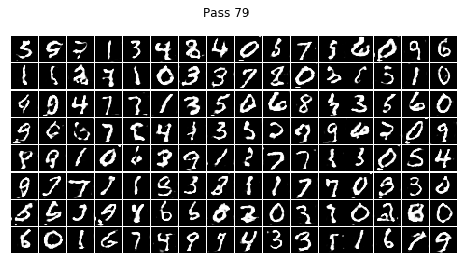

epoch = 79 , batch = 127 , real_d_loss = [0.44993746] , fake_d_loss = [0.72703093] g_loss = [0.6808144]


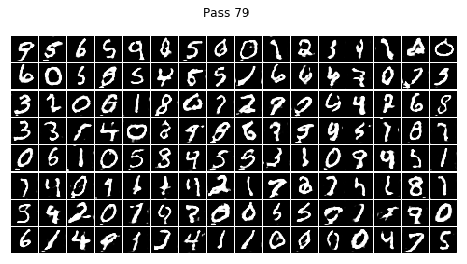

epoch = 79 , batch = 227 , real_d_loss = [0.38244572] , fake_d_loss = [0.7037654] g_loss = [0.6890106]


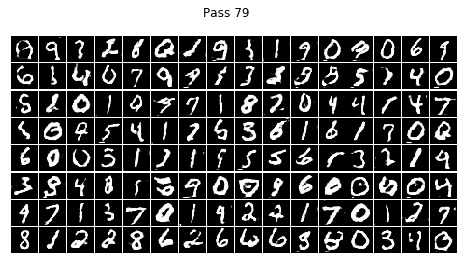

epoch = 79 , batch = 327 , real_d_loss = [0.39505702] , fake_d_loss = [0.70734954] g_loss = [0.685946]


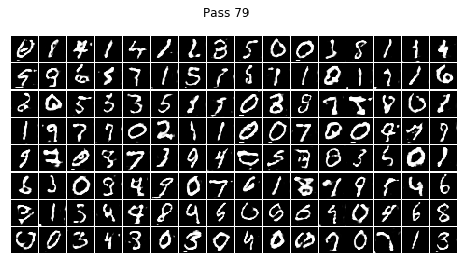

epoch = 79 , batch = 427 , real_d_loss = [0.39953238] , fake_d_loss = [0.72487426] g_loss = [0.6819702]


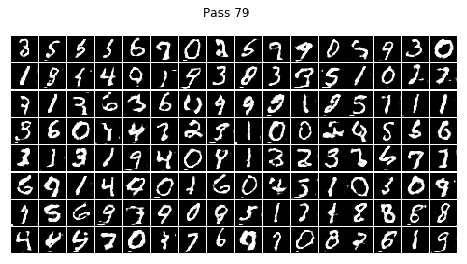

epoch = 80 , batch = 59 , real_d_loss = [0.45685485] , fake_d_loss = [0.71068174] g_loss = [0.682863]
epoch = 80 , batch = 259 , real_d_loss = [0.39165133] , fake_d_loss = [0.7157442] g_loss = [0.68381846]
epoch = 81 , batch = 91 , real_d_loss = [0.4056121] , fake_d_loss = [0.71400833] g_loss = [0.68422294]


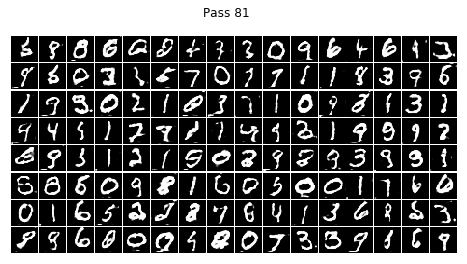

epoch = 81 , batch = 191 , real_d_loss = [0.44267356] , fake_d_loss = [0.7315265] g_loss = [0.67765164]


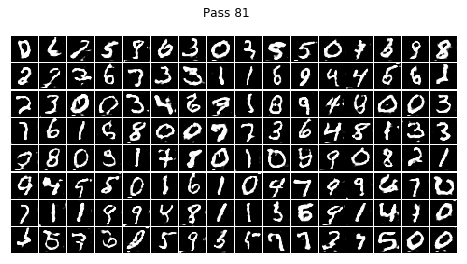

epoch = 81 , batch = 291 , real_d_loss = [0.40733775] , fake_d_loss = [0.7167937] g_loss = [0.6826022]


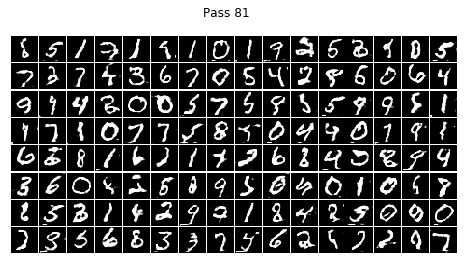

epoch = 81 , batch = 391 , real_d_loss = [0.46402824] , fake_d_loss = [0.70825136] g_loss = [0.6856006]


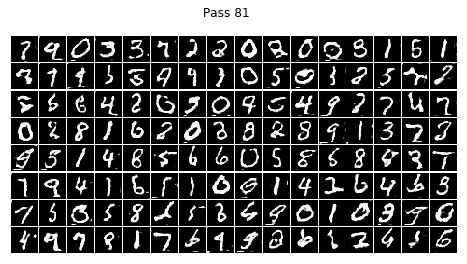

epoch = 82 , batch = 23 , real_d_loss = [0.4587472] , fake_d_loss = [0.71329343] g_loss = [0.682206]


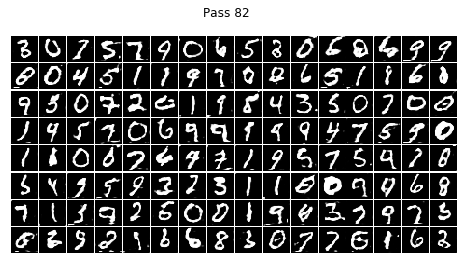

epoch = 82 , batch = 123 , real_d_loss = [0.40065607] , fake_d_loss = [0.7138406] g_loss = [0.68419474]


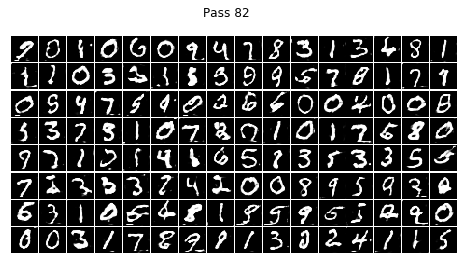

epoch = 82 , batch = 223 , real_d_loss = [0.40752578] , fake_d_loss = [0.7211398] g_loss = [0.6805302]


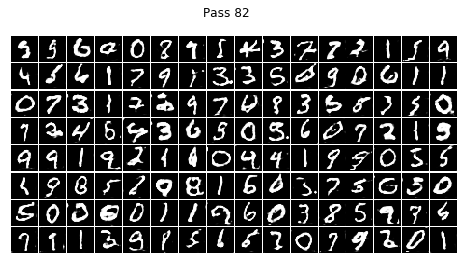

epoch = 82 , batch = 323 , real_d_loss = [0.41839767] , fake_d_loss = [0.7043159] g_loss = [0.6875166]


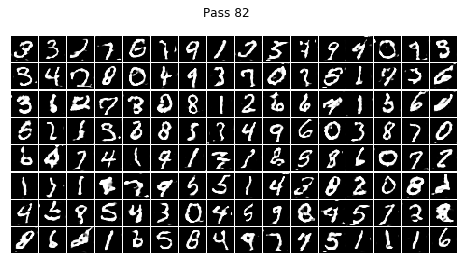

epoch = 82 , batch = 423 , real_d_loss = [0.40752348] , fake_d_loss = [0.72079694] g_loss = [0.6816323]


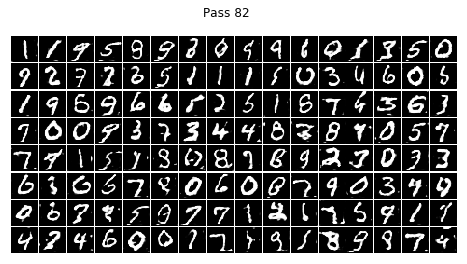

epoch = 83 , batch = 55 , real_d_loss = [0.40998936] , fake_d_loss = [0.7154031] g_loss = [0.683524]
epoch = 84 , batch = 87 , real_d_loss = [0.4435705] , fake_d_loss = [0.71890825] g_loss = [0.6810917]


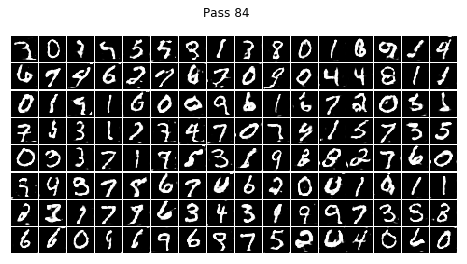

epoch = 84 , batch = 187 , real_d_loss = [0.40735617] , fake_d_loss = [0.717631] g_loss = [0.6831378]


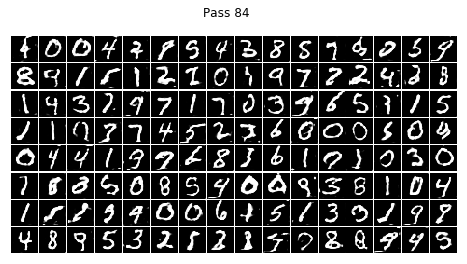

epoch = 84 , batch = 287 , real_d_loss = [0.40785757] , fake_d_loss = [0.71811604] g_loss = [0.6830168]
epoch = 84 , batch = 387 , real_d_loss = [0.39240652] , fake_d_loss = [0.70941234] g_loss = [0.6844106]


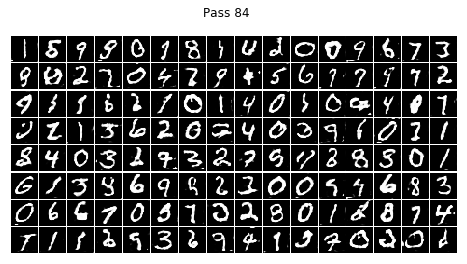

epoch = 85 , batch = 19 , real_d_loss = [0.42506438] , fake_d_loss = [0.70699537] g_loss = [0.6849742]


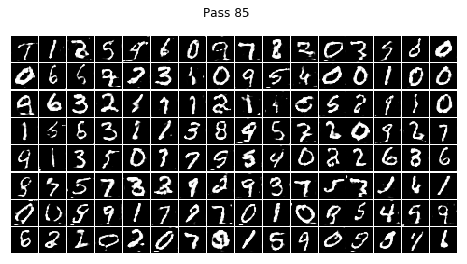

epoch = 85 , batch = 219 , real_d_loss = [0.4166236] , fake_d_loss = [0.71843255] g_loss = [0.68356097]


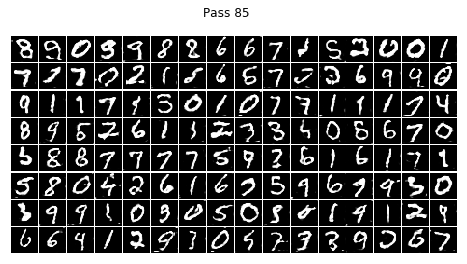

epoch = 85 , batch = 319 , real_d_loss = [0.41055614] , fake_d_loss = [0.7080845] g_loss = [0.685404]


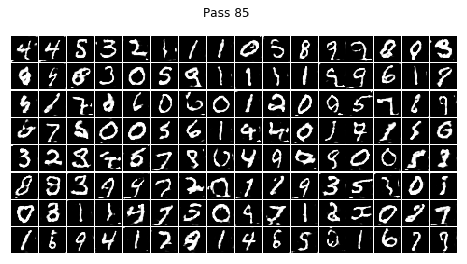

epoch = 86 , batch = 51 , real_d_loss = [0.41620415] , fake_d_loss = [0.7208708] g_loss = [0.67945564]


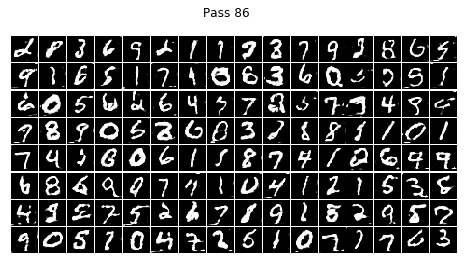

epoch = 86 , batch = 151 , real_d_loss = [0.4158116] , fake_d_loss = [0.7079084] g_loss = [0.68681926]


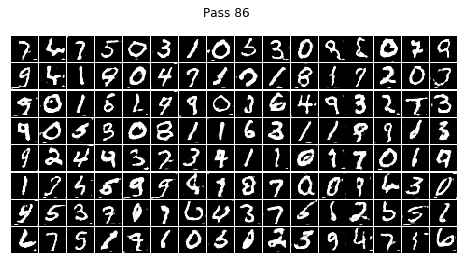

epoch = 86 , batch = 251 , real_d_loss = [0.38432896] , fake_d_loss = [0.706159] g_loss = [0.68694806]


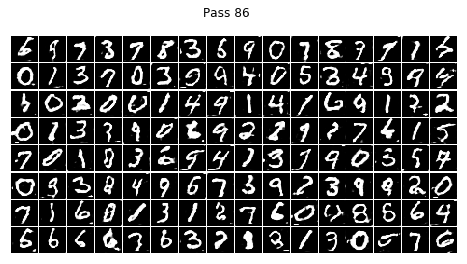

epoch = 86 , batch = 351 , real_d_loss = [0.41925138] , fake_d_loss = [0.71265495] g_loss = [0.682413]


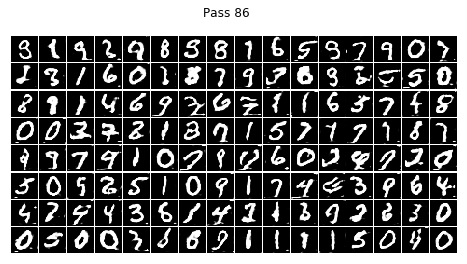

epoch = 87 , batch = 83 , real_d_loss = [0.37688726] , fake_d_loss = [0.70069814] g_loss = [0.6886409]


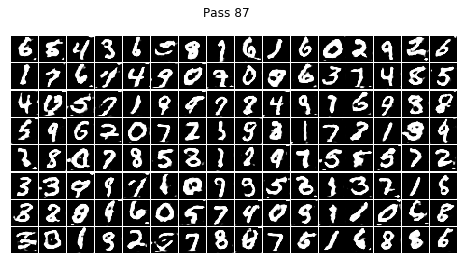

epoch = 87 , batch = 183 , real_d_loss = [0.35831472] , fake_d_loss = [0.91221046] g_loss = [0.6013908]


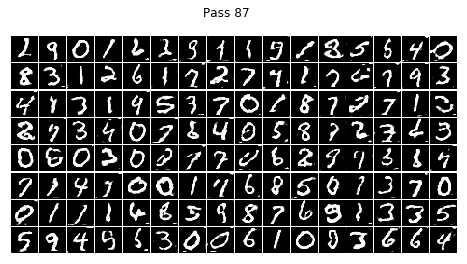

epoch = 87 , batch = 283 , real_d_loss = [0.36763284] , fake_d_loss = [0.6941015] g_loss = [0.6922296]


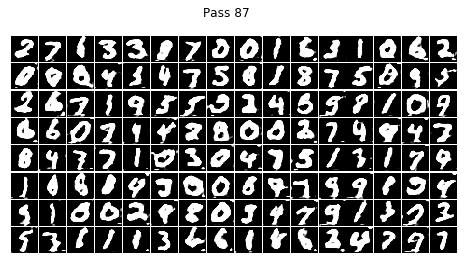

epoch = 87 , batch = 383 , real_d_loss = [0.36211488] , fake_d_loss = [0.69376564] g_loss = [0.692552]
epoch = 88 , batch = 15 , real_d_loss = [0.3630082] , fake_d_loss = [0.69410396] g_loss = [0.6922231]


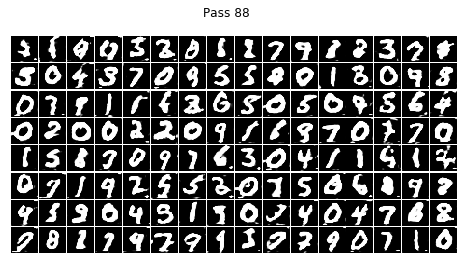

epoch = 88 , batch = 115 , real_d_loss = [0.3631088] , fake_d_loss = [0.70273125] g_loss = [0.6863855]


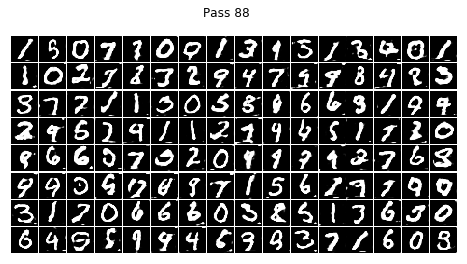

epoch = 88 , batch = 215 , real_d_loss = [0.3726766] , fake_d_loss = [0.7105359] g_loss = [0.6821636]


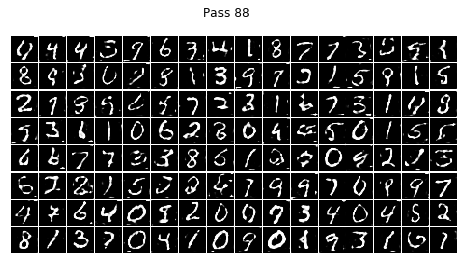

epoch = 88 , batch = 315 , real_d_loss = [0.3690085] , fake_d_loss = [0.693604] g_loss = [0.6927008]


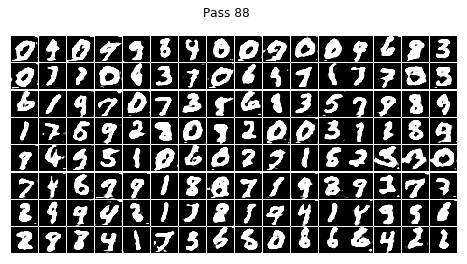

epoch = 88 , batch = 415 , real_d_loss = [0.34941643] , fake_d_loss = [0.6937046] g_loss = [0.69260216]


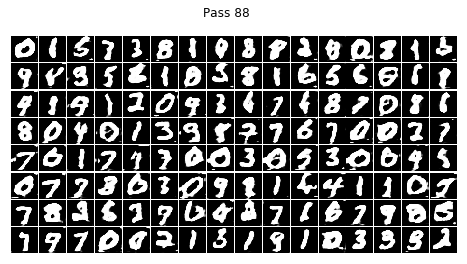

epoch = 89 , batch = 47 , real_d_loss = [0.3521259] , fake_d_loss = [0.69364834] g_loss = [0.69266]


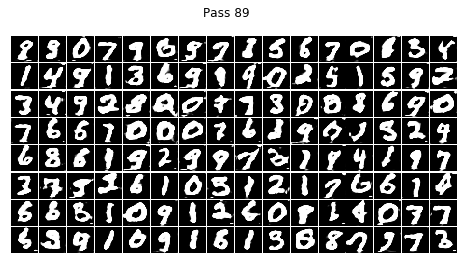

epoch = 89 , batch = 147 , real_d_loss = [0.3552019] , fake_d_loss = [0.69360685] g_loss = [0.69269997]


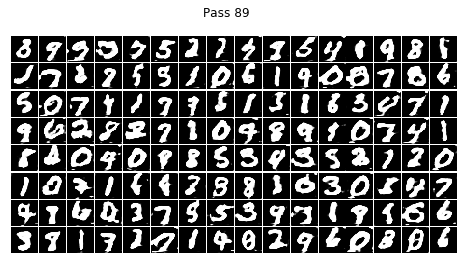

epoch = 89 , batch = 247 , real_d_loss = [0.36288032] , fake_d_loss = [0.69511175] g_loss = [0.6915252]


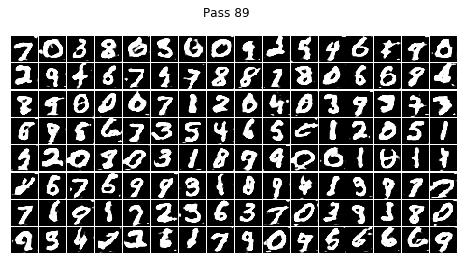

epoch = 89 , batch = 347 , real_d_loss = [0.35749698] , fake_d_loss = [0.6959275] g_loss = [0.69082195]


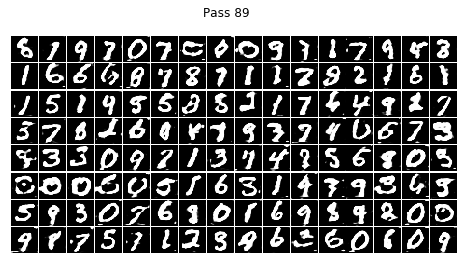

epoch = 89 , batch = 447 , real_d_loss = [0.35502377] , fake_d_loss = [0.69403815] g_loss = [0.69227064]


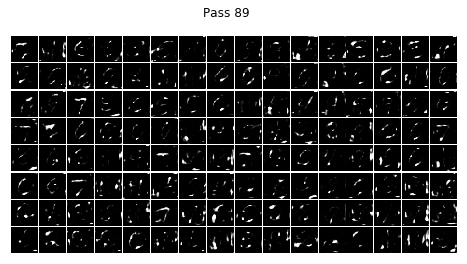

epoch = 90 , batch = 79 , real_d_loss = [0.37042487] , fake_d_loss = [0.69402766] g_loss = [0.69229496]


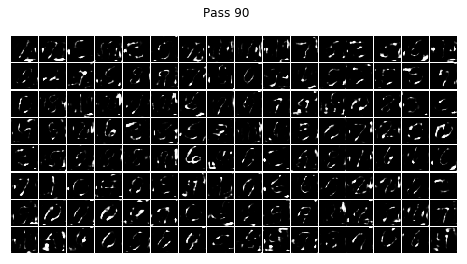

epoch = 90 , batch = 179 , real_d_loss = [0.36051738] , fake_d_loss = [0.6938698] g_loss = [0.6924797]


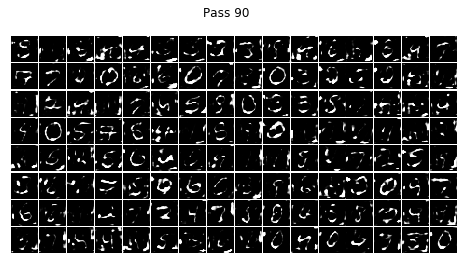

epoch = 91 , batch = 11 , real_d_loss = [0.3649723] , fake_d_loss = [0.6947632] g_loss = [0.6917324]


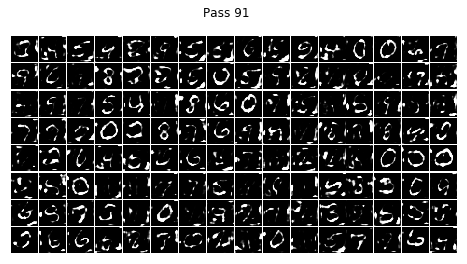

epoch = 91 , batch = 111 , real_d_loss = [0.3547356] , fake_d_loss = [0.6935078] g_loss = [0.6927984]


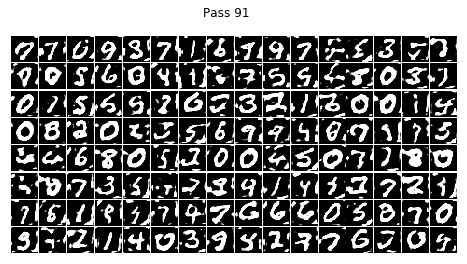

epoch = 91 , batch = 211 , real_d_loss = [0.37253237] , fake_d_loss = [0.69449097] g_loss = [0.6919648]


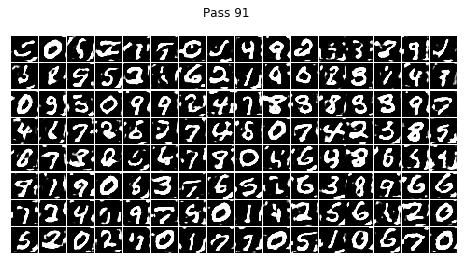

epoch = 91 , batch = 311 , real_d_loss = [0.3524291] , fake_d_loss = [0.69431216] g_loss = [0.6920695]


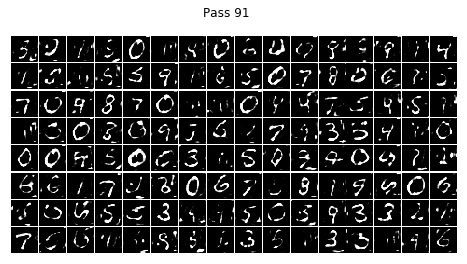

epoch = 91 , batch = 411 , real_d_loss = [0.37324882] , fake_d_loss = [0.69390845] g_loss = [0.6924088]


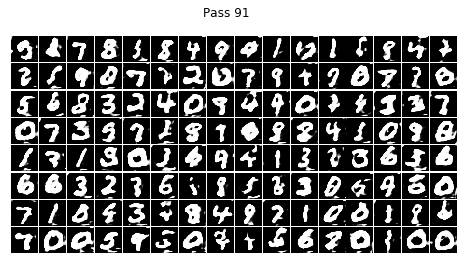

epoch = 92 , batch = 43 , real_d_loss = [0.34065577] , fake_d_loss = [0.69354534] g_loss = [0.6927556]


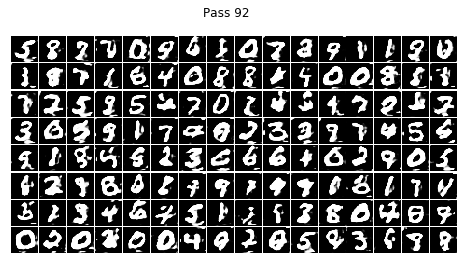

epoch = 92 , batch = 243 , real_d_loss = [0.3459764] , fake_d_loss = [0.6938747] g_loss = [0.6924485]


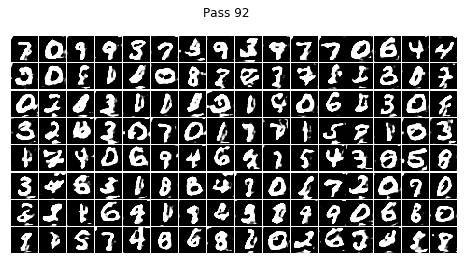

epoch = 92 , batch = 343 , real_d_loss = [0.36650413] , fake_d_loss = [0.80146205] g_loss = [0.66291696]


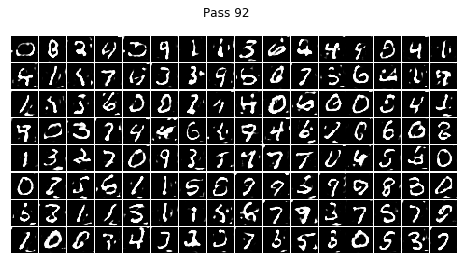

epoch = 92 , batch = 443 , real_d_loss = [0.36451086] , fake_d_loss = [0.69562423] g_loss = [0.6912303]


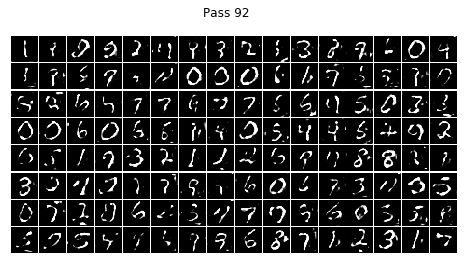

epoch = 93 , batch = 75 , real_d_loss = [0.35196763] , fake_d_loss = [0.69826925] g_loss = [0.69011235]


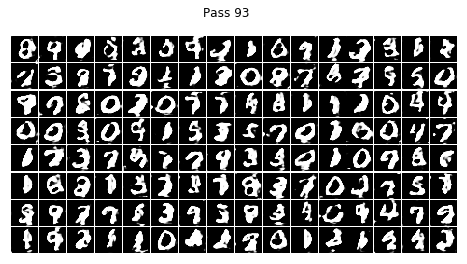

epoch = 93 , batch = 175 , real_d_loss = [0.36081493] , fake_d_loss = [0.6945038] g_loss = [0.6918938]
epoch = 93 , batch = 375 , real_d_loss = [0.35834733] , fake_d_loss = [0.69367784] g_loss = [0.6926422]


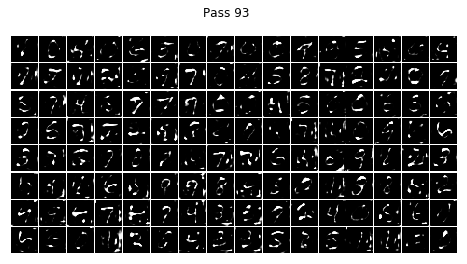

epoch = 94 , batch = 7 , real_d_loss = [0.35800043] , fake_d_loss = [0.6944369] g_loss = [0.69199884]


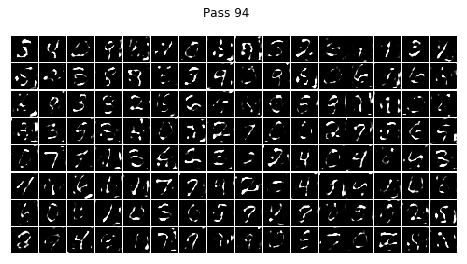

epoch = 94 , batch = 107 , real_d_loss = [0.3609364] , fake_d_loss = [0.6972853] g_loss = [0.6902195]


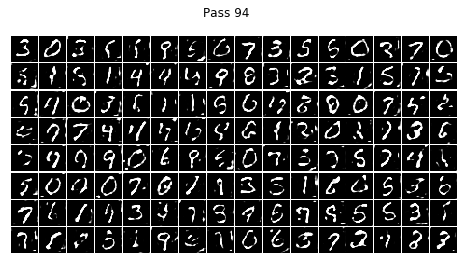

epoch = 94 , batch = 207 , real_d_loss = [0.34753534] , fake_d_loss = [0.69375587] g_loss = [0.69255793]


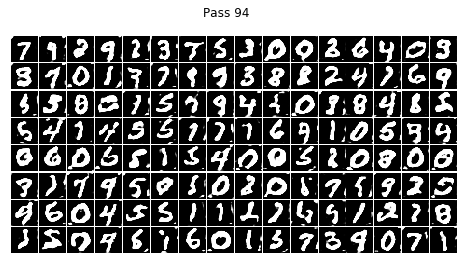

epoch = 94 , batch = 307 , real_d_loss = [0.34656993] , fake_d_loss = [0.69367087] g_loss = [0.69264793]


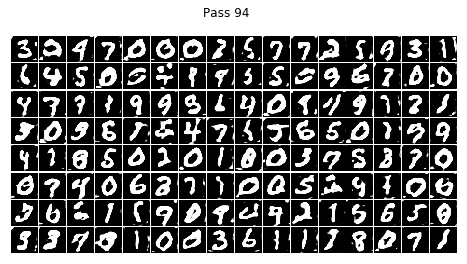

epoch = 94 , batch = 407 , real_d_loss = [0.34898704] , fake_d_loss = [0.69427806] g_loss = [0.6920649]


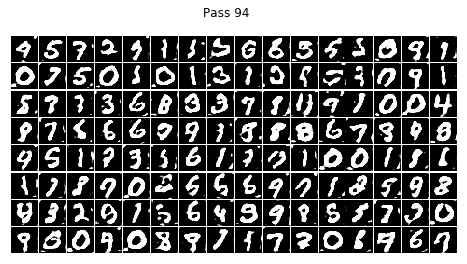

epoch = 95 , batch = 39 , real_d_loss = [0.35290357] , fake_d_loss = [0.6941801] g_loss = [0.6921766]


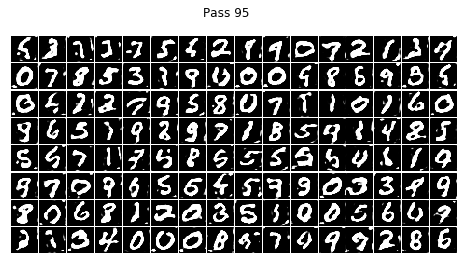

epoch = 95 , batch = 139 , real_d_loss = [0.34892645] , fake_d_loss = [0.69391745] g_loss = [0.69242364]


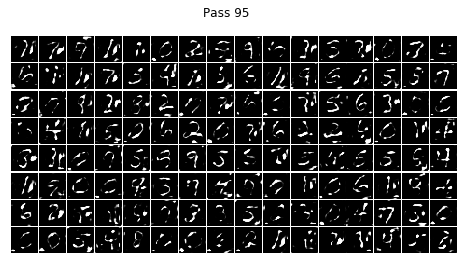

epoch = 95 , batch = 239 , real_d_loss = [0.3488741] , fake_d_loss = [0.69524616] g_loss = [0.6913649]


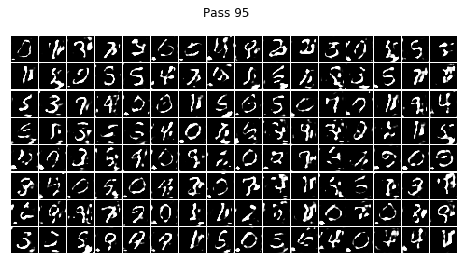

epoch = 95 , batch = 339 , real_d_loss = [0.37104252] , fake_d_loss = [0.710946] g_loss = [0.685344]


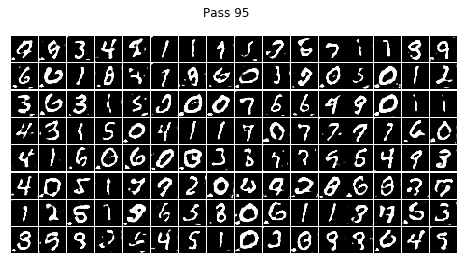

epoch = 95 , batch = 439 , real_d_loss = [0.37369972] , fake_d_loss = [0.7115058] g_loss = [0.6875237]


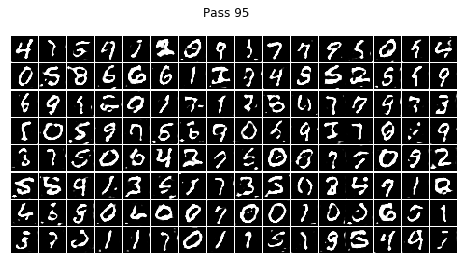

epoch = 96 , batch = 71 , real_d_loss = [0.37458867] , fake_d_loss = [0.7005315] g_loss = [0.6894609]


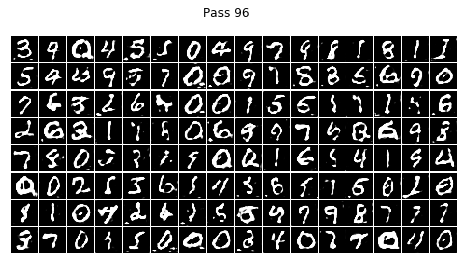

epoch = 96 , batch = 171 , real_d_loss = [0.35876024] , fake_d_loss = [0.69969] g_loss = [0.68989694]


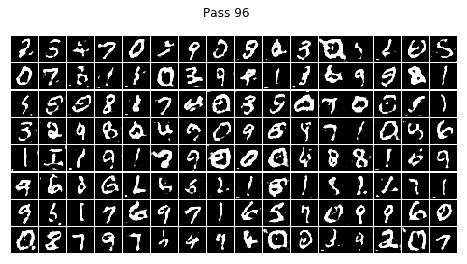

epoch = 96 , batch = 271 , real_d_loss = [0.47665584] , fake_d_loss = [0.6975245] g_loss = [0.69076043]


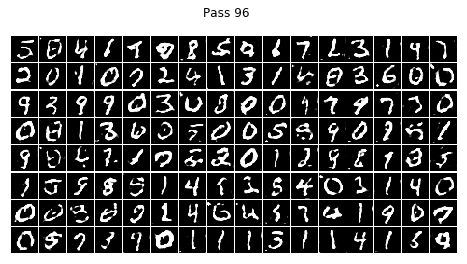

epoch = 96 , batch = 371 , real_d_loss = [0.36655486] , fake_d_loss = [0.7055967] g_loss = [0.68641824]


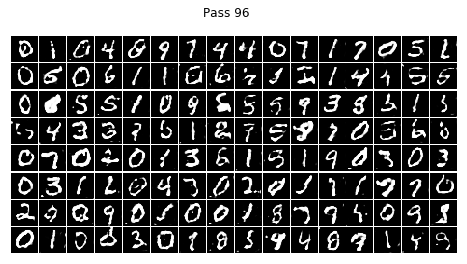

epoch = 97 , batch = 3 , real_d_loss = [0.37410867] , fake_d_loss = [0.6976343] g_loss = [0.69077975]


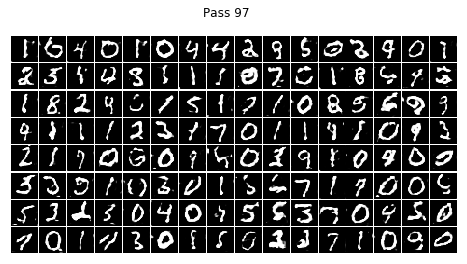

epoch = 97 , batch = 203 , real_d_loss = [0.36918926] , fake_d_loss = [0.71420383] g_loss = [0.6845299]
epoch = 98 , batch = 135 , real_d_loss = [0.38730478] , fake_d_loss = [0.7124001] g_loss = [0.6866869]


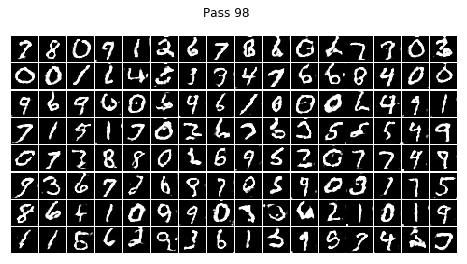

epoch = 98 , batch = 235 , real_d_loss = [0.3779791] , fake_d_loss = [0.71948224] g_loss = [0.68436265]


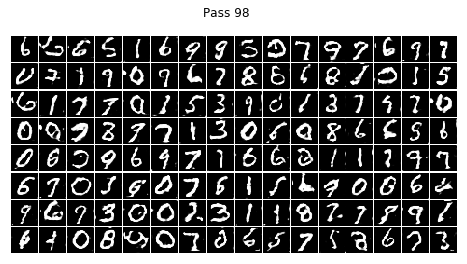

epoch = 98 , batch = 335 , real_d_loss = [0.3973234] , fake_d_loss = [0.71576583] g_loss = [0.6828998]


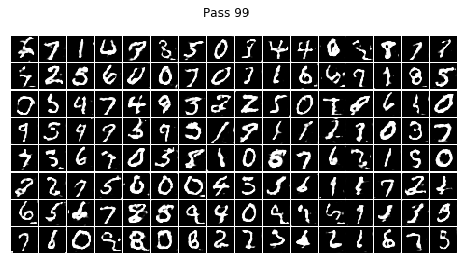

epoch = 99 , batch = 167 , real_d_loss = [0.39642534] , fake_d_loss = [0.7261111] g_loss = [0.68060225]


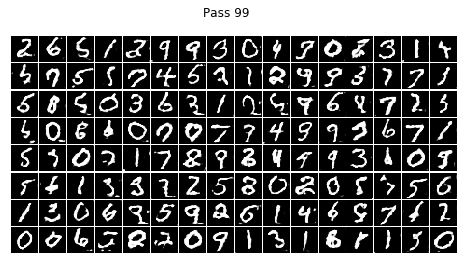

epoch = 99 , batch = 267 , real_d_loss = [0.4335369] , fake_d_loss = [0.70528525] g_loss = [0.68755233]


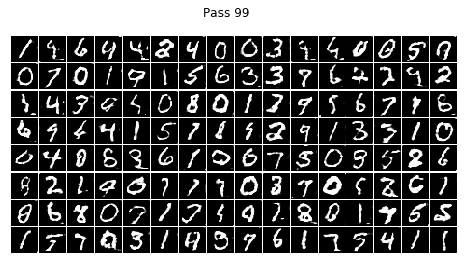

epoch = 99 , batch = 367 , real_d_loss = [0.41963455] , fake_d_loss = [0.7009448] g_loss = [0.6888796]


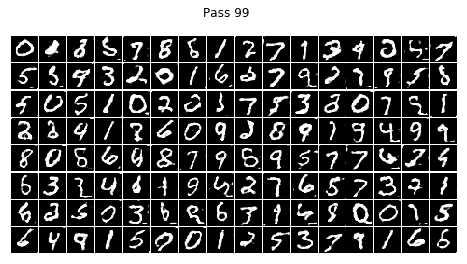

epoch = 99 , batch = 467 , real_d_loss = [0.4189448] , fake_d_loss = [0.73759335] g_loss = [0.67592883]


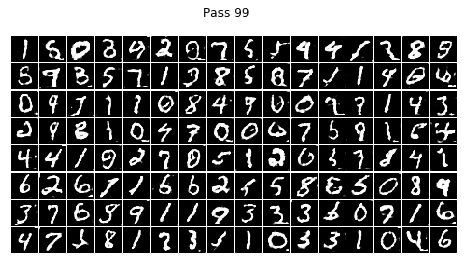

In [7]:


def train(mnist_generator, epoch_num=1, batch_size=128, use_gpu=True, load_model=False):
    place = fluid.CUDAPlace(0) if use_gpu else fluid.CPUPlace()
    with fluid.dygraph.guard(place):
        # 模型存储路径
        model_path = './output/'
        d = D('D')
        d.train()
        g = G('G')
        g.train()
        # 创建优化方法
        real_d_optimizer = fluid.optimizer.AdamOptimizer(learning_rate=2e-4, parameter_list=d.parameters())
        fake_d_optimizer = fluid.optimizer.AdamOptimizer(learning_rate=2e-4, parameter_list=d.parameters())
        g_optimizer = fluid.optimizer.AdamOptimizer(learning_rate=2e-4, parameter_list=g.parameters())
        
        # 读取上次保存的模型
        if load_model == True:
            g_para, g_opt = fluid.load_dygraph(model_path+'g')
            d_para, d_r_opt = fluid.load_dygraph(model_path+'d_o_r')
            # 上面判别器的参数已经读取到d_para了,此处无需再次读取
            _, d_f_opt = fluid.load_dygraph(model_path+'d_o_f')
            g.load_dict(g_para)
            g_optimizer.set_dict(g_opt)
            d.load_dict(d_para)
            real_d_optimizer.set_dict(d_r_opt)
            fake_d_optimizer.set_dict(d_f_opt)

        iteration_num = 0
        for epoch in range(epoch_num):
            for i, real_image in enumerate(mnist_generator()):
                # 丢弃不满整个batch_size的数据
                if(len(real_image) != BATCH_SIZE):
                    continue               
                iteration_num += 1                
                '''
                判别器d通过最小化输入真实图片时判别器d的输出与真值标签ones的交叉熵损失，来优化判别器的参数，
                以增加判别器d识别真实图片real_image为真值标签ones的概率。
                '''
                # 将MNIST数据集里的图片读入real_image，将真值标签ones用数字1初始化
                real_image = fluid.dygraph.to_variable(np.array(real_image))
                ones = fluid.dygraph.to_variable(np.ones([len(real_image), 1]).astype('float32'))
                # 计算判别器d判断真实图片的概率
                p_real = d(real_image)
                # 计算判别真图片为真的损失
                real_cost = fluid.layers.sigmoid_cross_entropy_with_logits(p_real, ones)
                real_avg_cost = fluid.layers.mean(real_cost)
                # 反向传播更新判别器d的参数
                real_avg_cost.backward()
                real_d_optimizer.minimize(real_avg_cost)
                d.clear_gradients()
                
                '''
                判别器d通过最小化输入生成器g生成的假图片g(z)时判别器的输出与假值标签zeros的交叉熵损失，
                来优化判别器d的参数，以增加判别器d识别生成器g生成的假图片g(z)为假值标签zeros的概率。
                '''
                # 创建高斯分布的噪声z，将假值标签zeros初始化为0
                z = next(z_generator())
                z = fluid.dygraph.to_variable(np.array(z))
                zeros = fluid.dygraph.to_variable(np.zeros([len(real_image), 1]).astype('float32'))
                # 判别器d判断生成器g生成的假图片的概率
                p_fake = d(g(z))
                # 计算判别生成器g生成的假图片为假的损失
                fake_cost = fluid.layers.sigmoid_cross_entropy_with_logits(p_fake, zeros)
                fake_avg_cost = fluid.layers.mean(fake_cost)
                # 反向传播更新判别器d的参数
                fake_avg_cost.backward()
                fake_d_optimizer.minimize(fake_avg_cost)
                d.clear_gradients()

                '''
                生成器g通过最小化判别器d判别生成器生成的假图片g(z)为真的概率d(fake)与真值标签ones的交叉熵损失，
                来优化生成器g的参数，以增加生成器g使判别器d判别其生成的假图片g(z)为真值标签ones的概率。
                '''
                # 生成器用输入的高斯噪声z生成假图片
                fake = g(z)
                # 计算判别器d判断生成器g生成的假图片的概率
                p_confused = d(fake)
                # 使用判别器d判断生成器g生成的假图片的概率与真值ones的交叉熵计算损失
                g_cost = fluid.layers.sigmoid_cross_entropy_with_logits(p_confused, ones)
                g_avg_cost = fluid.layers.mean(g_cost)
                # 反向传播更新生成器g的参数
                g_avg_cost.backward()
                g_optimizer.minimize(g_avg_cost)
                g.clear_gradients()
                
                # 打印输出
                if(iteration_num % 100 == 0):
                    print('epoch =', epoch, ', batch =', i, ', real_d_loss =', real_avg_cost.numpy(),
                     ', fake_d_loss =', fake_avg_cost.numpy(), 'g_loss =', g_avg_cost.numpy())
                    show_image_grid(fake.numpy(), BATCH_SIZE, epoch)                             
        
        # 存储模型
        fluid.save_dygraph(g.state_dict(), model_path+'g')
        fluid.save_dygraph(g_optimizer.state_dict(), model_path+'g')
        fluid.save_dygraph(d.state_dict(), model_path+'d_o_r')
        fluid.save_dygraph(real_d_optimizer.state_dict(), model_path+'d_o_r')
        fluid.save_dygraph(d.state_dict(), model_path+'d_o_f')
        fluid.save_dygraph(fake_d_optimizer.state_dict(), model_path+'d_o_f')

train(mnist_generator, epoch_num=100, batch_size=BATCH_SIZE, use_gpu=True) # 10
